In [1]:
# Full library list and version numbers

print('This notebook was prepared using:')

import sys
print('python version %s' % sys.version)

import numpy as np
print('numpy version %s' % np.__version__)

import seaborn as sns
print('seaborn version %s' % sns.__version__)

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.gridspec import GridSpec
print('matplotlib version %s' % matplotlib.__version__)

from tabulate import tabulate

import scipy
from scipy import stats
print('scipy version %s' % scipy.__version__)

import importlib

sys.path.append('./src')
import MPL as MPL
import analyze_and_plot as AP
import reconstruct_clades as RC
import infer_fitness as IF
import print_info as PI
import LTEE
import LTEE_helper as LH
import lolipop_helper

# GitHub directories
DATA_DIR = './data'
LOLIPOP_INPUT_DIR = './test_data/lolipop/input'
LOLIPOP_OUTPUT_DIR = './test_data/lolipop/output'
LOLIPOP_PARSED_OUTPUT_DIR = './test_data/lolipop/parsed_output'
SIMULATION_OUTPUT_DIR = './data/simulation_output'
# SUBSAMPLE_OUTPUT_DIR = './data/subsample_output'
# ESTIMATION_OUTPUT_DIR = './data/estimation_output'
JOB_DIR = './src/jobs'

# relative directories looking from shell scripts in JOB_DIR
SRC_DIR_REL = '..'
DATA_DIR_REL = '../../data'
SIMULATION_OUTPUT_DIR_REL = '../../data/simulation_output'
# SUBSAMPLE_OUTPUT_DIR_REL = '../../data/subsample_output'
# ESTIMATION_OUTPUT_DIR_REL = '../../data/estimation_output'

This notebook was prepared using:
python version 3.6.10 |Anaconda, Inc.| (default, Mar 25 2020, 18:53:43) 
[GCC 4.2.1 Compatible Clang 4.0.1 (tags/RELEASE_401/final)]
numpy version 1.19.1
seaborn version 0.11.0
matplotlib version 3.3.2
scipy version 1.5.2


In [2]:
def reload():
    importlib.reload(MPL)
    importlib.reload(AP)
    importlib.reload(RC)
    importlib.reload(IF)
    importlib.reload(PI)
    importlib.reload(LTEE)
    importlib.reload(LH)
    importlib.reload(lolipop_helper)

In [3]:
def resetPlottingParams():
    PARAMS = {'text.usetex': False, 'mathtext.fontset': 'stixsans', 'mathtext.default': 'regular', 'pdf.fonttype': 42, 'ps.fonttype': 42}
    plt.rcParams.update(matplotlib.rcParamsDefault)
    plt.rcParams.update(PARAMS)

In [4]:
resetPlottingParams()

# Global constants

In [5]:
DATA_DIRECTORY = './data/LTEE-metagenomic-master/data_files/'
all_lines = ['m5','p2','p4','p1','m6','p5','m1','m2','m3','m4','p3','p6']
focal_populations = ['p2','m6','m1']
remaining_populations = ['m5','p1','p4','p5','m2','m3','m4','p3','p6']
complete_nonmutator_lines = ['m5','m6','p1','p2','p4','p5']

populations = ['p2','m6','m1', 'm5','p1','p4','p5','m2','m3','m4','p3','p6']
populations_doable = ['p2','m6','m1', 'm5','p1','p4','p5','m2','m3','m4','p3']

# Load data

In [40]:
%%time
# # 2 min
reload()
LH.loadData(populations_doable)
LH.loadFitness(populations_doable)
LH.loadMeanFitness()

CPU times: user 1min 23s, sys: 736 ms, total: 1min 23s
Wall time: 1min 24s


In [7]:
pop = 'm6'
print(len(LH.data[pop]['depths_intpl']), len(LH.data[pop]['depths_intpl'][3]), np.mean(LH.data[pop]['depths_intpl']))

220 122 59.4723174366617


In [8]:
print(f'pop\t# of clonal muts\ttotal muts\tfiltered muts\tclonal percent')
for pop in populations_doable:
    numMuts = len(LH.data[pop]['sites'])
    numFilteredMuts = len(LH.data[pop]['sites_intpl'])
    numClonalMuts = np.sum([LH.data[pop]['site_to_clade'][site] in [3, 4, 6, 7] for site in LH.data[pop]['sites']])
    print(f'{pop}\t{numClonalMuts}\t\t\t{numMuts}\t\t{numFilteredMuts}\t\t%.2f' % (numClonalMuts / numMuts))
    

pop	# of clonal muts	total muts	filtered muts	clonal percent
p2	0			174		173		0.00
m6	109			221		220		0.49
m1	1910			4597		4596		0.42
m5	195			406		404		0.48
p1	119			466		457		0.26
p4	0			201		198		0.00
p5	110			202		200		0.54
m2	1861			3488		3483		0.53
m3	0			3255		3248		0.00
m4	1165			4872		4845		0.24
p3	1574			6102		6072		0.26


In [9]:
# for pop in populations_doable:
#     saveTrajectoriesToTables(LH.data[pop]['traj'], LOLIPOP_INPUT_DIR + f'/LTEE_interpolated_pop={pop}.tsv', 
#                              times=LH.TIMES_INTPL, sep='\t')
    

## Evaluation on simulations

In [10]:
def getSummary(dic, mu=2e-4, thFixed=1, useEffectiveMu=True):
    simulation = RC.CladeReconstruction(dic['traj'], useEffectiveMu=useEffectiveMu, meanReadDepth=1000, verbose=False, plot=False, mu=mu)
    simulation.setParamsForClusterization(weightByBothVariance=False, weightBySmallerVariance=True)
    simulation.clusterMutations()
    simulation.setParamsForReconstruction(thFixed=thFixed, thExtinct=0, numClades=None, percentMutsToIncludeInMajorClades=95, thLogProbPerTime=10)
    simulation.checkForSeparablePeriodAndReconstruct()
    simulation.setParamsForEvaluation(intCov=dic['cov'], selection=dic['selections'], fitness=np.sum(dic['selections'] * dic['traj'], axis=1))
    return simulation.evaluateInference()

# Create tables as input to Lolipop

In [11]:
def loadSimulation(n, meanS=0.03, stdS=0.01, mu=2e-4, threshold=0.05):
    dic = np.load(f'{SIMULATION_OUTPUT_DIR}/simulation_output_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.npz', allow_pickle=True)
    return dic

def loadOutputGenoTraj(n, meanS=0.03, stdS=0.01, mu=2e-4, threshold=0.05):
    df = pd.read_csv(LOLIPOP_OUTPUT_DIR + f'/n={n}/tables/simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.populations.tsv', sep='\t')
    return df

def loadOutputGenoTraj_LTEE(pop):
    df = pd.read_csv(LOLIPOP_OUTPUT_DIR + f'/{pop}/tables/LTEE_interpolated_pop={pop}.populations.tsv', sep='\t')
    return df

def saveTrajectoriesToTables(traj, filename, times=None, sep='\t'):
    T, L = traj.shape
    if times is None:
        times = np.arange(0, T)
    dic = {
        'Trajectory': list(np.arange(0, L)),
    }
    for i, t in enumerate(times):
        dic[t] = list(traj[i])
    df = pd.DataFrame(dic)
    df.to_csv(filename, sep=sep)
    
# def saveLTEETrajectoriesToTables(pop, filename, sep='\t', interpolation=True):
#     LH.data[pop]['sites_intpl']
#     T, L = data['traj'].shape
#     dic = {
#         'Trajectory': list(np.arange(0, L)),
#     }
#     for i, t in enumerate(data['times']):
#         dic[t] = list(data['traj'][t])
#     df = pd.DataFrame(dic)
#     df.to_csv(filename, sep=sep)
    
def getTrueGenoTraj(data):
    genotypeToIndex = {}
    genotypeToTrajectory = {}
    T, L = data['traj'].shape
    N = np.sum(data['nVec'][0])
    for t in range(T):
        nVec_t, sVec_t = data['nVec'][t], data['sVec'][t]
        for i, seq in enumerate(sVec_t):
            seq_tuple = tuple(seq)
            if seq_tuple not in genotypeToIndex:
                genotypeToIndex[seq_tuple] = len(genotypeToIndex)
            index = genotypeToIndex[seq_tuple]
            if seq_tuple not in genotypeToTrajectory:
                genotypeToTrajectory[seq_tuple] = {}
            genotypeToTrajectory[seq_tuple][t] = nVec_t[i] / N
    genoTraj = np.zeros((T, len(genotypeToIndex)), dtype=float)
    for genotype in genotypeToTrajectory:
        index = genotypeToIndex[genotype]
        for t, freq in genotypeToTrajectory[genotype].items():
            genoTraj[t, index] = freq
            
    return genoTraj
    

In [13]:
# start_n, num_trials = 0, 20
# meanS, stdS, mu, threshold = 0.03, 0.01, 2e-4, 0.05
# for n in np.arange(start_n, start_n + num_trials):
#     dic = loadSimulation(n, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
#     saveTrajectoriesToTables(dic['traj'], LOLIPOP_INPUT_DIR + f'/simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.tsv', sep='\t')
    

In [242]:
# start_n, num_trials = 20, 20
# meanS, stdS, mu, threshold = 0.03, 0.01, 2e-4, 0.05
# for n in np.arange(start_n, start_n + num_trials):
#     dic = loadSimulation(n, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
#     saveTrajectoriesToTables(dic['traj'], LOLIPOP_INPUT_DIR + f'/simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.tsv', sep='\t')
    

# Run lolipop in command line

`
lolipop lineage --input [input filename] --output [output folder]
`

In [241]:
print(f"mkdir {' '.join([f'n={n}' for n in range(20, 40)])}")

mkdir n=20 n=21 n=22 n=23 n=24 n=25 n=26 n=27 n=28 n=29 n=30 n=31 n=32 n=33 n=34 n=35 n=36 n=37 n=38 n=39


In [243]:
# Command when in root directoty of paper-clade-reconstruction
start_n, num_trials = 20, 20
meanS, stdS, mu, threshold = 0.03, 0.01, 2e-4, 0.05
for n in np.arange(start_n, start_n + num_trials):
    print(f"lolipop lineage --input {LOLIPOP_INPUT_DIR}/simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.tsv --output {LOLIPOP_OUTPUT_DIR}/n={n}")
    

lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=20.tsv --output ./test_data/lolipop/output/n=20
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=21.tsv --output ./test_data/lolipop/output/n=21
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=22.tsv --output ./test_data/lolipop/output/n=22
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=23.tsv --output ./test_data/lolipop/output/n=23
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=24.tsv --output ./test_data/lolipop/output/n=24
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=25.tsv --output ./test_data/lolipop/output/n=25
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.

In [240]:
# Command when in root directoty of paper-clade-reconstruction
start_n, num_trials = 0, 20
meanS, stdS, mu, threshold = 0.03, 0.01, 2e-4, 0.05
for n in np.arange(start_n, start_n + num_trials):
    print(f"lolipop lineage --input {LOLIPOP_INPUT_DIR}/simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.tsv --output {LOLIPOP_OUTPUT_DIR}/n={n}_hierarchy_combined -m twostep --metric combined")
    

lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=0.tsv --output ./test_data/lolipop/output/n=0_hierarchy_combined -m twostep --metric combined
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=1.tsv --output ./test_data/lolipop/output/n=1_hierarchy_combined -m twostep --metric combined
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=2.tsv --output ./test_data/lolipop/output/n=2_hierarchy_combined -m twostep --metric combined
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=3.tsv --output ./test_data/lolipop/output/n=3_hierarchy_combined -m twostep --metric combined
lolipop lineage --input ./test_data/lolipop/input/simulation_traj_mean=0.03_std=0.01_mu=0.0002_th=0.05_n=4.tsv --output ./test_data/lolipop/output/n=4_hierarchy_combined -m twostep --metric combined
lolip

In [235]:
print(f"mkdir {' '.join([f'n={n}_hierarchy_combined' for n in range(20)])}")

mkdir n=0_hierarchy_combined n=1_hierarchy_combined n=2_hierarchy_combined n=3_hierarchy_combined n=4_hierarchy_combined n=5_hierarchy_combined n=6_hierarchy_combined n=7_hierarchy_combined n=8_hierarchy_combined n=9_hierarchy_combined n=10_hierarchy_combined n=11_hierarchy_combined n=12_hierarchy_combined n=13_hierarchy_combined n=14_hierarchy_combined n=15_hierarchy_combined n=16_hierarchy_combined n=17_hierarchy_combined n=18_hierarchy_combined n=19_hierarchy_combined


In [16]:
for pop in LH.populations_nonmutator:
    print(f"lolipop lineage --input {LOLIPOP_INPUT_DIR}/LTEE_interpolated_pop={pop}.tsv --output {LOLIPOP_OUTPUT_DIR}/{pop}")
    

lolipop lineage --input ./test_data/lolipop/input/LTEE_interpolated_pop=p2.tsv --output ./test_data/lolipop/output/p2
lolipop lineage --input ./test_data/lolipop/input/LTEE_interpolated_pop=m6.tsv --output ./test_data/lolipop/output/m6
lolipop lineage --input ./test_data/lolipop/input/LTEE_interpolated_pop=m5.tsv --output ./test_data/lolipop/output/m5
lolipop lineage --input ./test_data/lolipop/input/LTEE_interpolated_pop=p1.tsv --output ./test_data/lolipop/output/p1
lolipop lineage --input ./test_data/lolipop/input/LTEE_interpolated_pop=p4.tsv --output ./test_data/lolipop/output/p4
lolipop lineage --input ./test_data/lolipop/input/LTEE_interpolated_pop=p5.tsv --output ./test_data/lolipop/output/p5


In [ ]:
for pop in LH.populations_nonmutator:
    print(f"lolipop lineage --input {LOLIPOP_INPUT_DIR}/LTEE_interpolated_pop={pop}.tsv --output {LOLIPOP_OUTPUT_DIR}/{pop}")
    

# Simulation 0

cladeFixedTimes = [516, 900]
period boundaries:  [(0, 517), (516, 901), (900, 1001)]
ancestors:  [0, 1, 5, 6]
refined period boundaries:  [(0, 517), (517, 798), (798, 1001)]


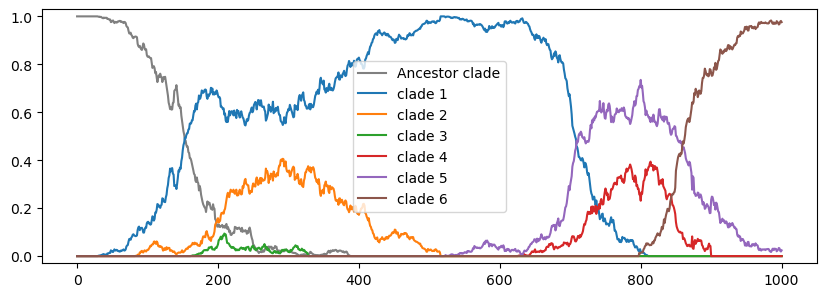

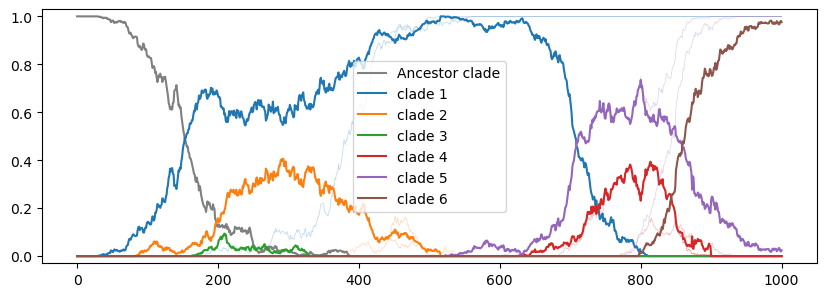

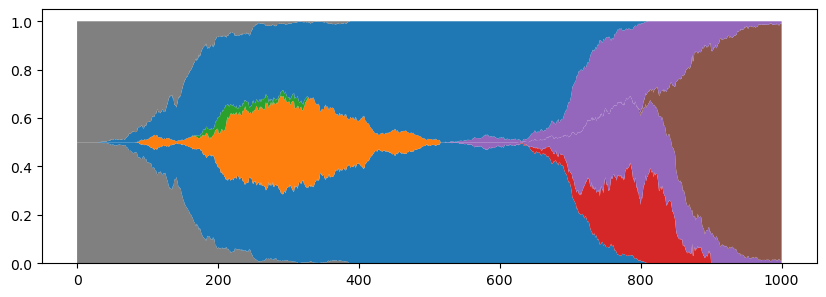

In [17]:
reload()
meanS, stdS, mu, threshold, n = 0.03, 0.01, 2e-4, 0.05, 0
dic = np.load(f'{SIMULATION_OUTPUT_DIR}/simulation_output_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.npz', allow_pickle=True)
simulation = RC.CladeReconstruction(dic['traj'], meanReadDepth=1000, debug=False, verbose=False, plot=True, mu=mu)
simulation.setParamsForClusterization(weightByBothVariance=False, weightBySmallerVariance=True)
simulation.clusterMutations()
simulation.setParamsForReconstruction(thFixed=1, thExtinct=0, numClades=None, percentMutsToIncludeInMajorClades=95, thLogProbPerTime=10)
simulation.checkForSeparablePeriodAndReconstruct()
# simulation.setParamsForEvaluation(intCov=dic['cov'], selection=dic['selections'], fitness=np.sum(dic['selections'] * dic['traj'], axis=1))
# _ = simulation.evaluateInference()


In [24]:
reload()
meanS, stdS, mu, threshold, n = 0.03, 0.01, 2e-4, 0.05, 0
simulations = []
for n in range(start_n, start_n + num_trials):
    dic = np.load(f'{SIMULATION_OUTPUT_DIR}/simulation_output_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.npz', allow_pickle=True)
    simulation = RC.CladeReconstruction(dic['traj'], meanReadDepth=1000, debug=False, verbose=False, plot=False, mu=mu)
    simulation.setParamsForClusterization(weightByBothVariance=False, weightBySmallerVariance=True)
    simulation.clusterMutations()
    simulation.setParamsForReconstruction(thFixed=0.99, thExtinct=0, numClades=None, percentMutsToIncludeInMajorClades=95, thLogProbPerTime=10)
    simulation.checkForSeparablePeriodAndReconstruct()
    # simulation.setParamsForEvaluation(intCov=dic['cov'], selection=dic['selections'], fitness=np.sum(dic['selections'] * dic['traj'], axis=1))
    # _ = simulation.evaluateInference()
    simulations.append(simulation)


In [28]:
df = pd.read_csv(LOLIPOP_OUTPUT_DIR + f'n={n}/tables/simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.populations.tsv', sep='\t')


In [31]:
print(df.columns)
print(len(df['Identity']))
print(len(np.unique(df['Identity'])))

Index(['Identity', 'Generation', 'Population'], dtype='object')
12012
12


In [14]:
def parseGenotypeTrajectories(df):
    genotypes = np.unique(df['Identity'])
    generations = sorted(np.unique(df['Generation']))
    generationToIndex = {}
    for i, generation in enumerate(generations):
        generationToIndex[generation] = i
    G = len(genotypes)
    T = len(generations)
    genoTraj = np.zeros((T, G), dtype=float)
    for i, row in df.iterrows():
        generation = int(row['Generation'])
        t = generationToIndex[generation]
        g = int(row['Identity'].split('-')[-1])
        freq = row['Population'] / 100
        genoTraj[t, g] = freq
    return genoTraj


def wrapperForN(n):
    df = loadOutputGenoTraj(n)
    data = loadSimulation(n)
    trueGenoTraj = getTrueGenoTraj(data)
    genoTraj = parseGenotypeTrajectories(df)
    compareWithTrueGenoTraj(genoTraj, trueGenoTraj)


def compareWithTrueGenoTraj(genoTraj, trueGenoTraj, alpha=0.8, figsize=(10, 6.6), fontsize=12, plotFigure=True, plotShow=True):
    if plotFigure:
        fig, axes = plt.subplots(2, 1, figsize=figsize)
    
    plt.sca(axes[0])
    plotGenoTraj(genoTraj, alpha=alpha, plotFigure=False, plotShow=False)
    plt.ylabel('Reconstructed', fontsize=fontsize)
    plt.xticks(ticks=[], labels=[])
    plt.sca(axes[1])
    plotGenoTraj(trueGenoTraj, alpha=alpha, plotFigure=False, plotShow=False)
    plt.ylabel('True', fontsize=fontsize)
    
    plt.subplots_adjust(hspace=0)
    if plotShow:
        plt.show()
        

def compareWithTrueGenoTraj_LTEE(genoTraj, pop, alpha=0.8, figsize=(10, 6.6), fontsize=12, plotFigure=True, plotShow=True):
    if plotFigure:
        fig, axes = plt.subplots(2, 1, figsize=figsize)
    
    plt.sca(axes[0])
    plotGenoTraj(genoTraj, alpha=alpha, plotFigure=False, plotShow=False)
    plt.ylabel('Reconstructed', fontsize=fontsize)
    plt.xticks(ticks=[], labels=[])
    plt.sca(axes[1])
    LH.plotDataForOnePop(pop, plotFigure=False, plotShow=False, plotLegend=True)
    plt.ylabel('LTEE', fontsize=fontsize)
    
    plt.subplots_adjust(hspace=0)
    if plotShow:
        plt.show()
        
        
def compareWithTrueGenoTraj_LTEE_edges(genoTraj, pop, colors, alphas, alpha=0.8, figsize=(10, 6.6), fontsize=12, plotFigure=True, plotShow=True):
    if plotFigure:
        fig, axes = plt.subplots(2, 1, figsize=figsize)
    
    plt.sca(axes[0])
    AP.plotTraj(genoTraj, alphas=alphas, colors=colors, plotShow=False, title=None)
    plt.ylabel('Reconstructed', fontsize=fontsize)
    plt.xticks(ticks=[], labels=[])
    plt.sca(axes[1])
    LH.plotDataForOnePop(pop, plotFigure=False, plotShow=False, plotLegend=True)
    plt.ylabel('LTEE', fontsize=fontsize)
    
    plt.subplots_adjust(hspace=0)
    if plotShow:
        plt.show()
        

def compareWithOurMethod(genoTraj, cladeFreq, colors, alphas, figsize=(10, 6.6), fontsize=12, annot=True, plotFigure=True, plotShow=True):
    if plotFigure:
        fig, axes = plt.subplots(2, 1, figsize=figsize)
    
    plt.sca(axes[0])
    AP.plotTraj(genoTraj, alphas=alphas, colors=colors, plotShow=False, title=None, annot=annot)
    plt.ylabel('Reconstructed by lolipop', fontsize=fontsize)
    plt.xticks(ticks=[], labels=[])
    plt.sca(axes[1])
    AP.plotTraj(cladeFreq, plotShow=False, title=None, annot=annot)
    plt.ylabel('Reconstructed by our method', fontsize=fontsize)
    
    plt.subplots_adjust(hspace=0)
    if plotShow:
        plt.show()
        

def plotGenoTraj(genoTraj, alpha=0.8, plotFigure=True, plotShow=True):
    T, G = genoTraj.shape
    if plotFigure:
        plt.figure(figsize=figsize)
    for g in range(G):
        plt.plot(range(T), genoTraj[:, g], alpha=alpha)
    if plotShow:
        plt.show()

In [33]:
alphas = 0.8 ** np.arange(0, 10)
print(alphas)

[1.         0.8        0.64       0.512      0.4096     0.32768
 0.262144   0.2097152  0.16777216 0.13421773]


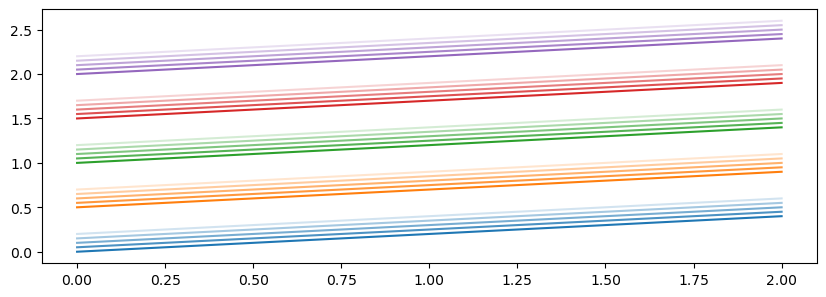

In [31]:
xs, ys = np.array([0, 1, 2]), np.array([0, 0.2, 0.4])
colors = [(0, 0, 1), (0, 1, 0), (1, 0, 0)]
alphas = 0.8 ** np.arange(0, 10)
alphas = [1, 0.8, 0.6, 0.4, 0.2]
plt.figure(figsize=(10, 3.3))
for i, color in enumerate(AP.COLORS[:5]):
    for j, alpha in enumerate(alphas):
        plt.plot(xs, ys + i * 0.5 + j * 0.05, color=color, alpha=alpha)
plt.show()
    

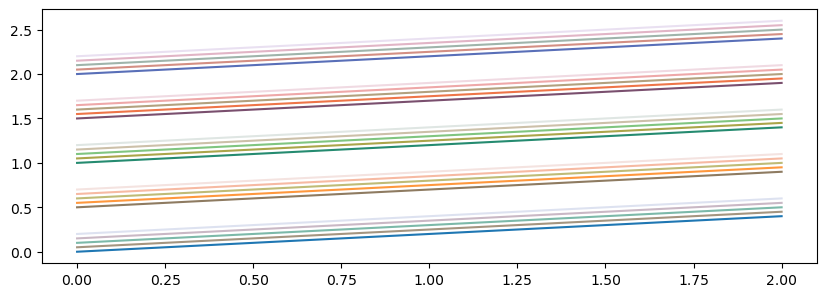

In [68]:
reload()
ratio = 0.5
xs, ys = np.array([0, 1, 2]), np.array([0, 0.2, 0.4])
colors = [AP.hexToRGB(color) for color in AP.COLORS]
alphas = 0.8 ** np.arange(0, 10)
alphas = [1, 0.8, 0.6, 0.4, 0.2]
plt.figure(figsize=(10, 3.3))
for i, color in enumerate(colors[:5]):
    for j, alpha in enumerate(alphas):
        color_ = np.array(color) * (1 - ratio) + np.array(colors[j]) * ratio
        color_ = tuple(color_)
        plt.plot(xs, ys + i * 0.5 + j * 0.05, color=color_, alpha=alpha)
plt.show()
    

In [75]:
table = []
for n in range(start_n, start_n + num_trials):
    table.append([n, len(genoTraj_all[n][0]), len(trueGenoTraj_all[n][0]), len(data_all[n]['traj'][0])])
headers = ['n', 'reconstructed genotypes', 'genotypes', 'mutations']
print(tabulate(table, headers, tablefmt='plain'))

  n    reconstructed genotypes    genotypes    mutations
  0                         12           14           13
  1                          8           10            9
  2                         14           16           15
  3                         13           16           15
  4                         10           11           10
  5                          7            8            7
  6                          9           11           10
  7                          8            9            8
  8                         15           19           18
  9                         10           11           10
 10                         12           15           14
 11                          8           11           10
 12                         12           15           14
 13                          3            4            3
 14                          9           10            9
 15                         12           15           14
 16                          6 

In [372]:
data_all = []
genoTraj_all = []
trueGenoTraj_all = []
start_n, num_trials = 0, 40
meanS, stdS, mu, threshold = 0.03, 0.01, 2e-4, 0.05
for n in range(start_n, start_n + num_trials):
    df = loadOutputGenoTraj(n)
    data = loadSimulation(n)
    output = loadParsedOutput(n, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
    trueGenoTraj = getTrueGenoTraj(data)
    genoTraj = output['genoTraj']
    
    data_all.append(data)
    genoTraj_all.append(genoTraj)
    trueGenoTraj_all.append(trueGenoTraj)

--------------------n=0--------------------


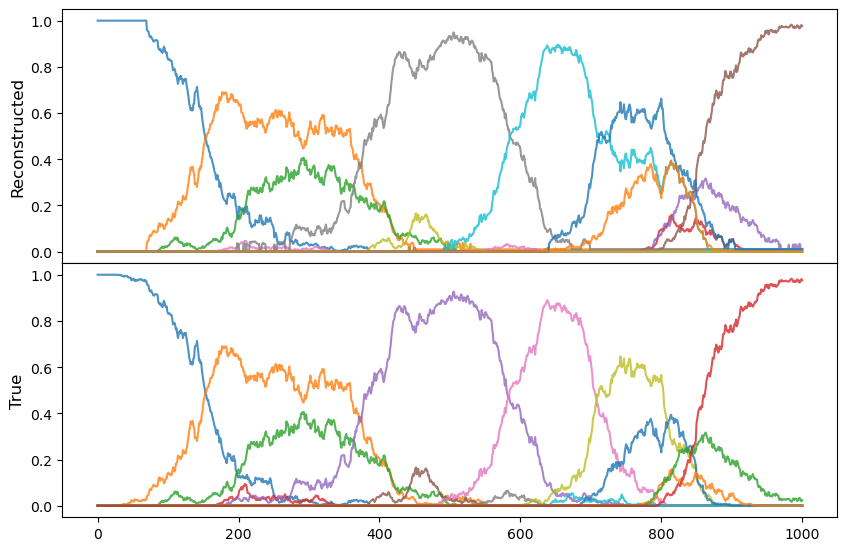

--------------------n=1--------------------


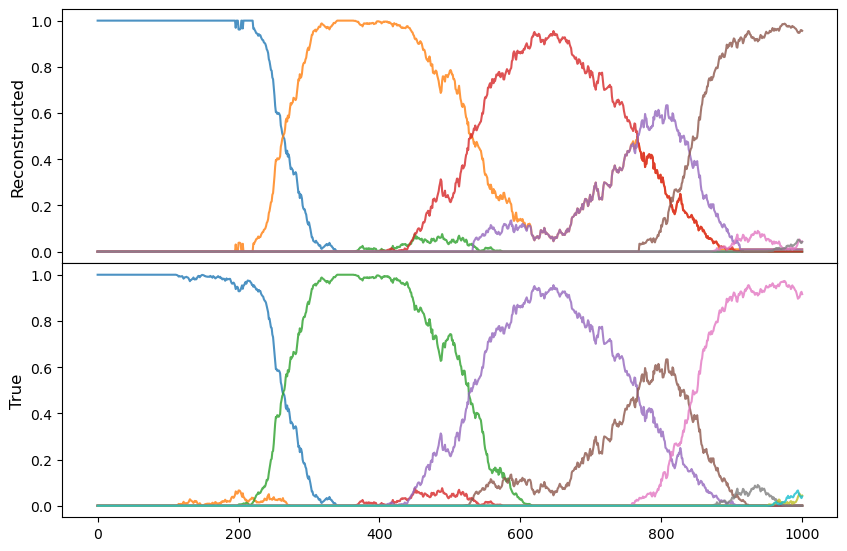

--------------------n=2--------------------


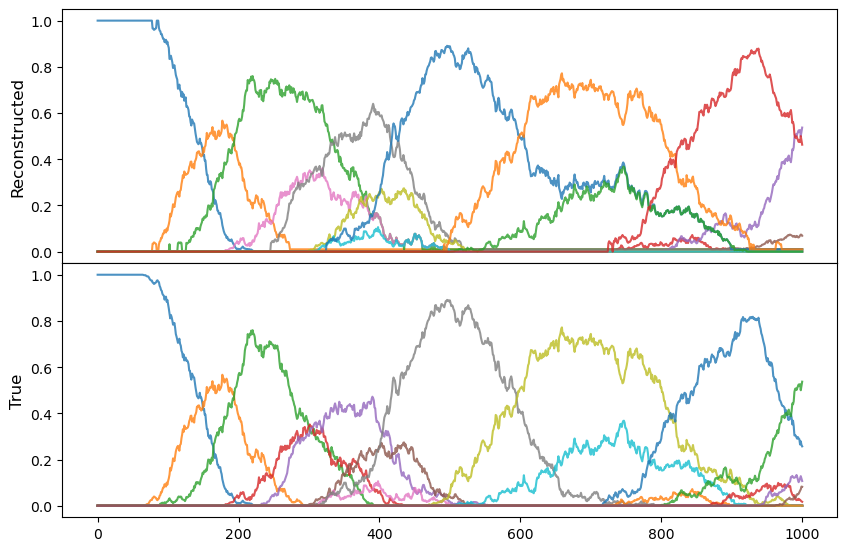

--------------------n=3--------------------


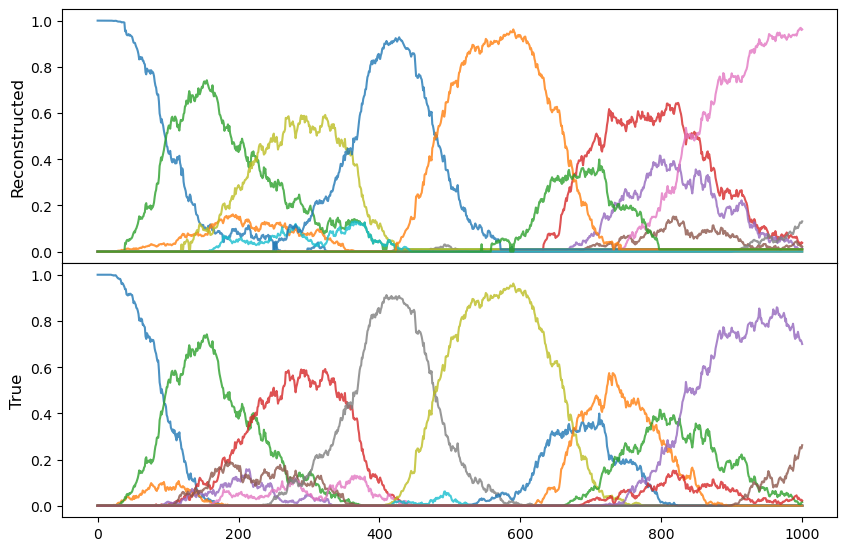

--------------------n=4--------------------


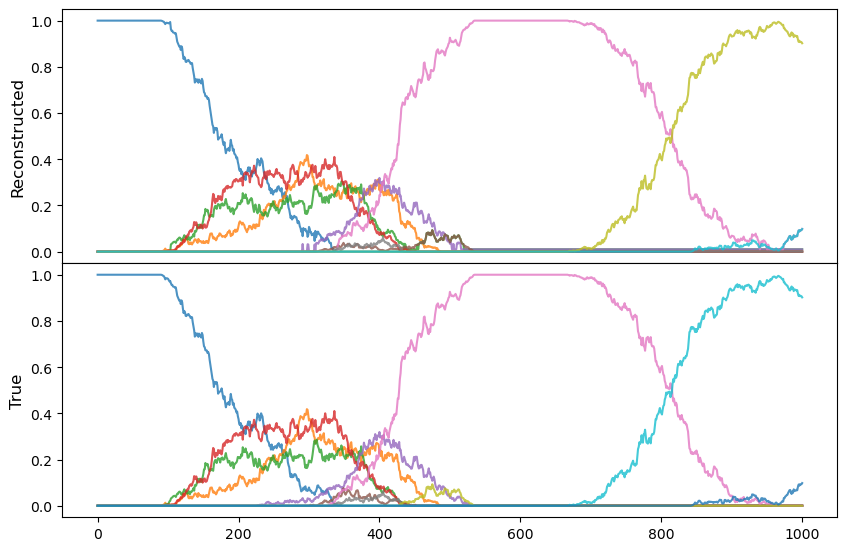

--------------------n=5--------------------


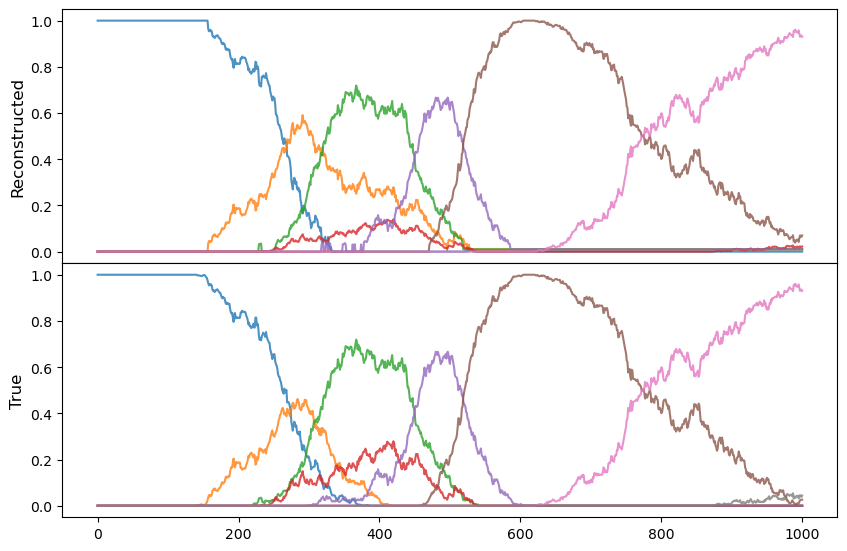

--------------------n=6--------------------


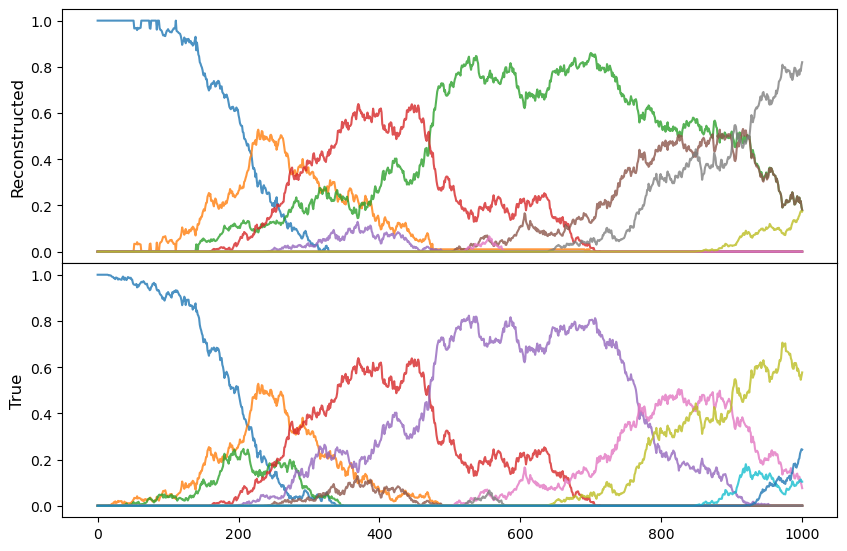

--------------------n=7--------------------


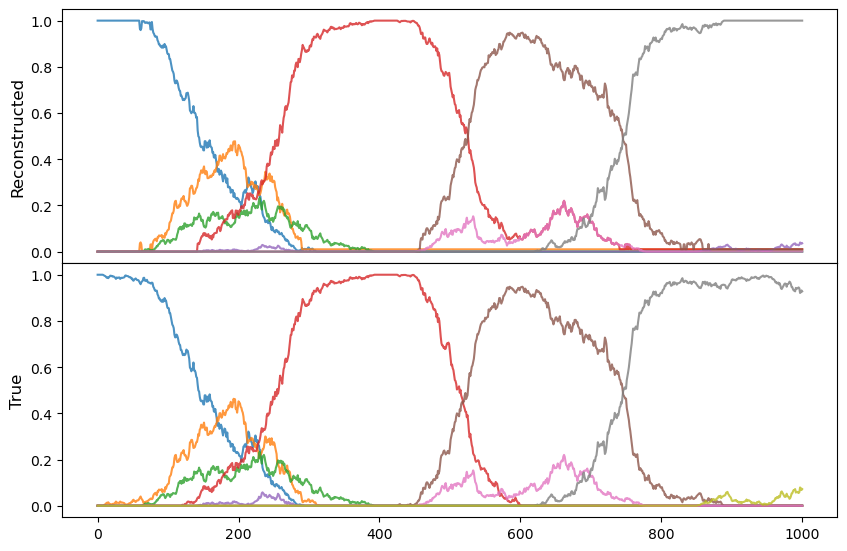

--------------------n=8--------------------


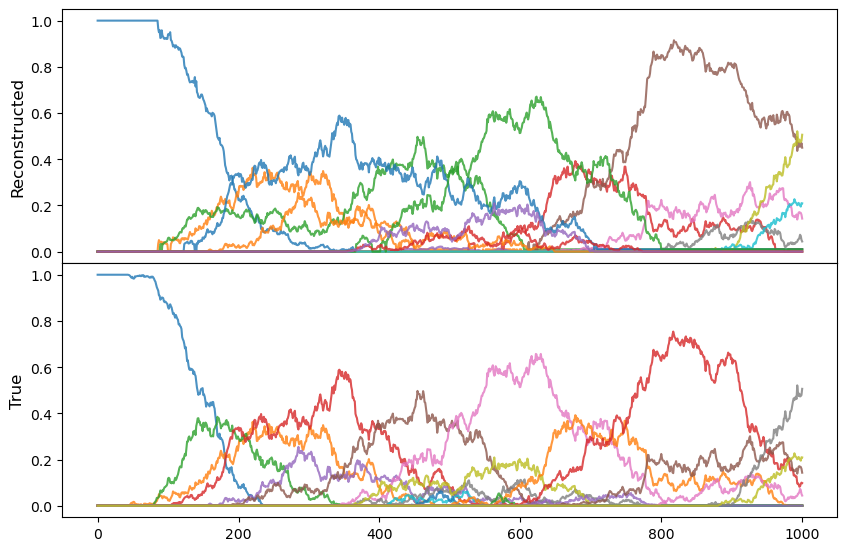

--------------------n=9--------------------


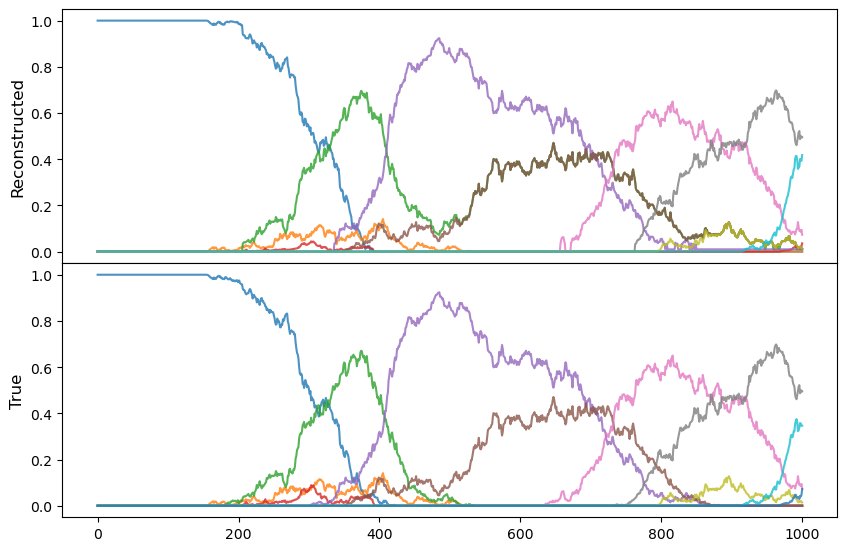

--------------------n=10--------------------


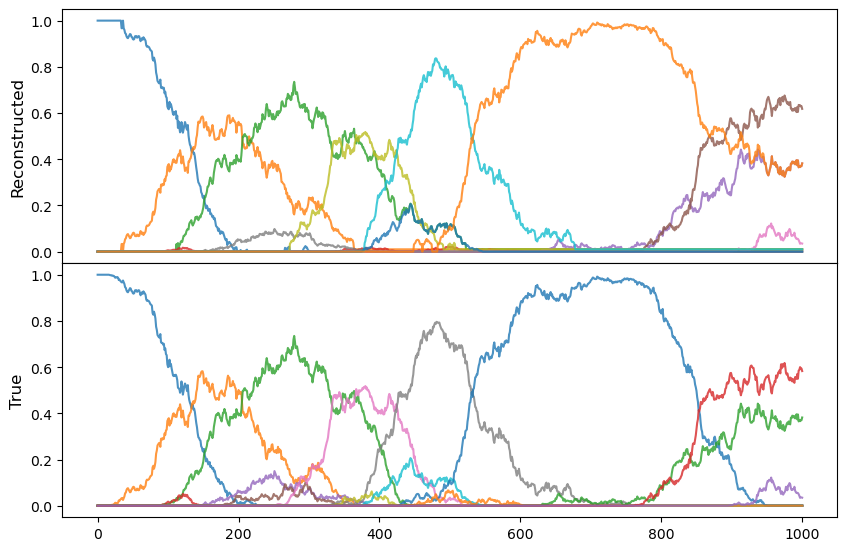

--------------------n=11--------------------


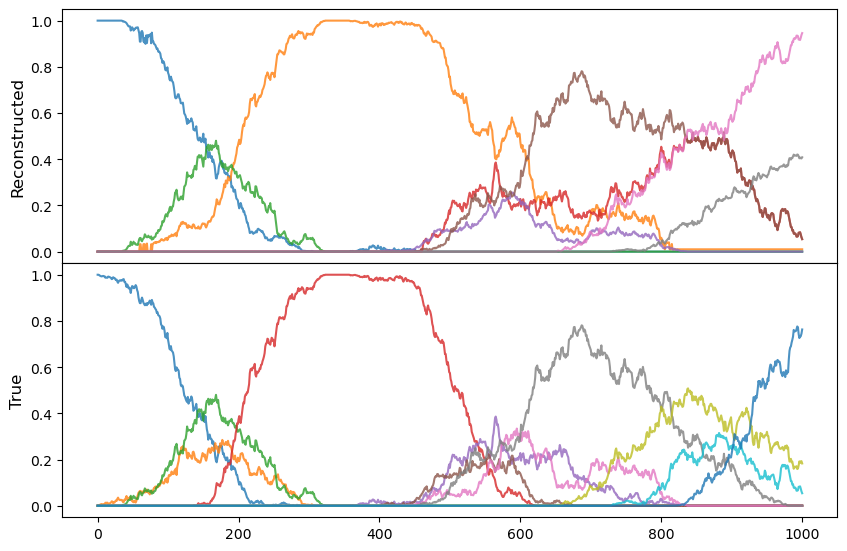

--------------------n=12--------------------


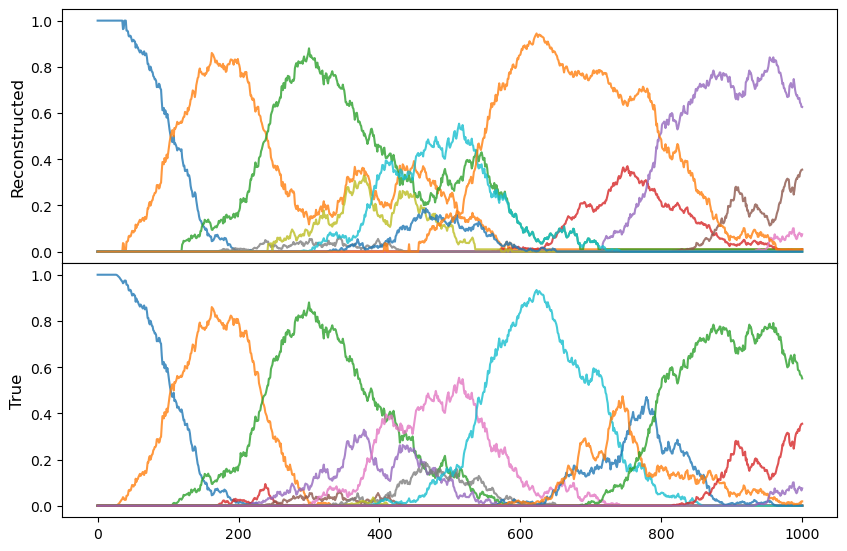

--------------------n=13--------------------


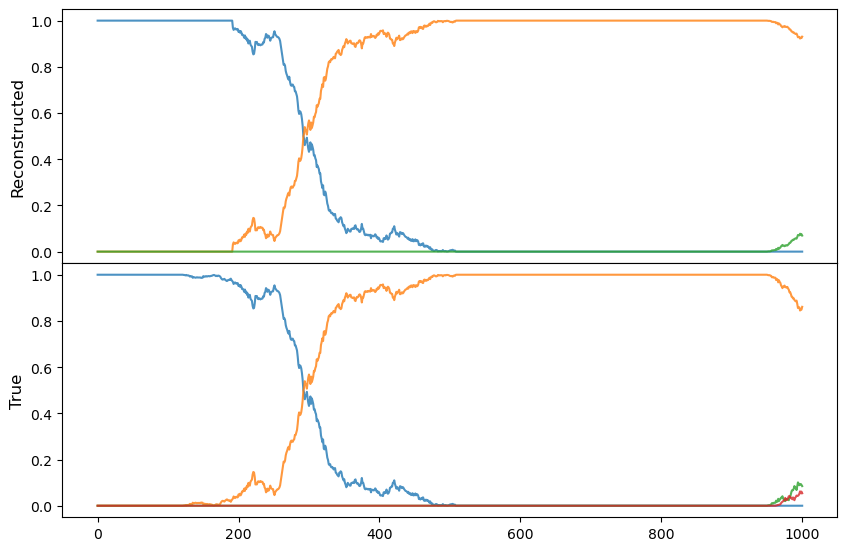

--------------------n=14--------------------


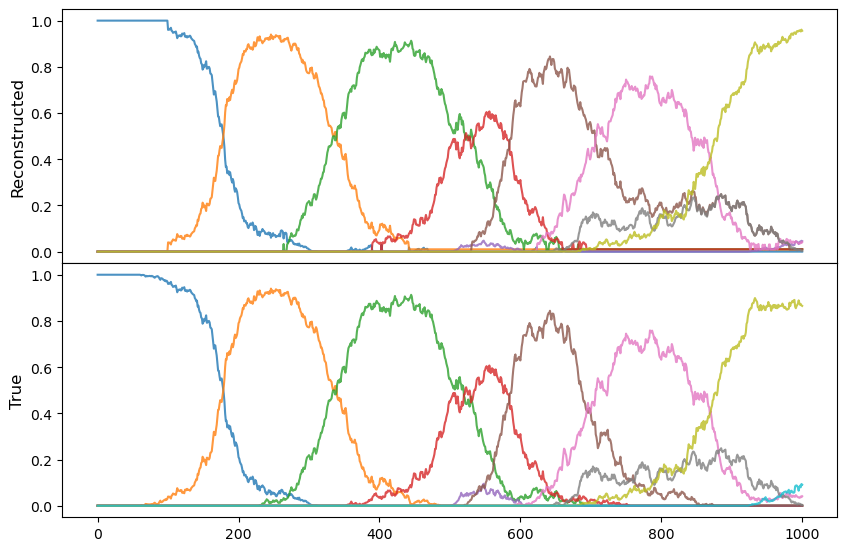

--------------------n=15--------------------


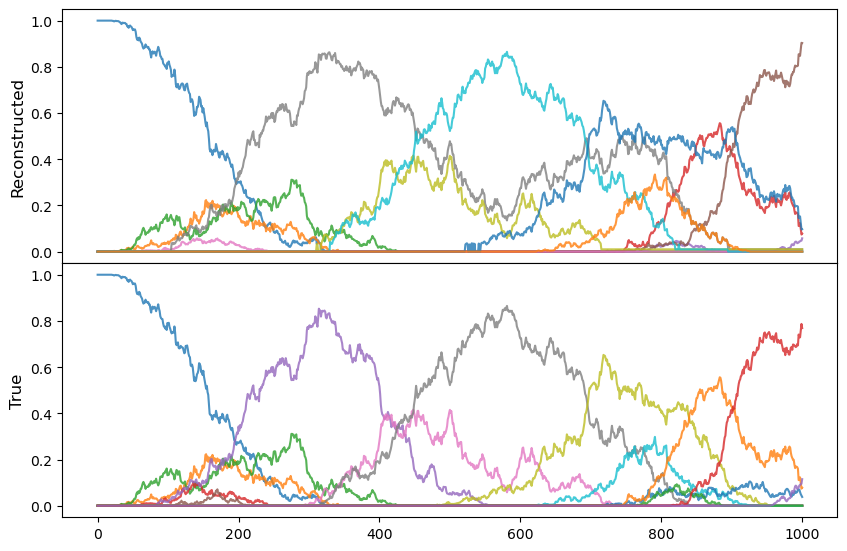

--------------------n=16--------------------


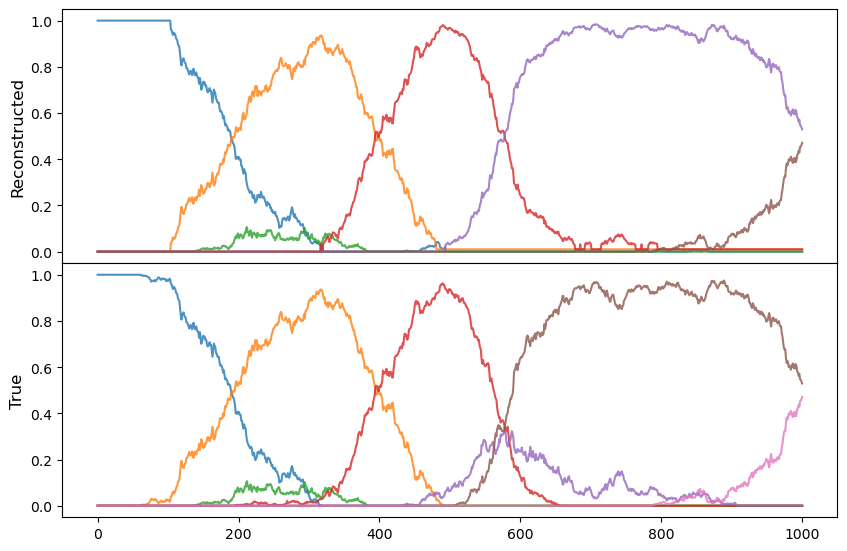

--------------------n=17--------------------


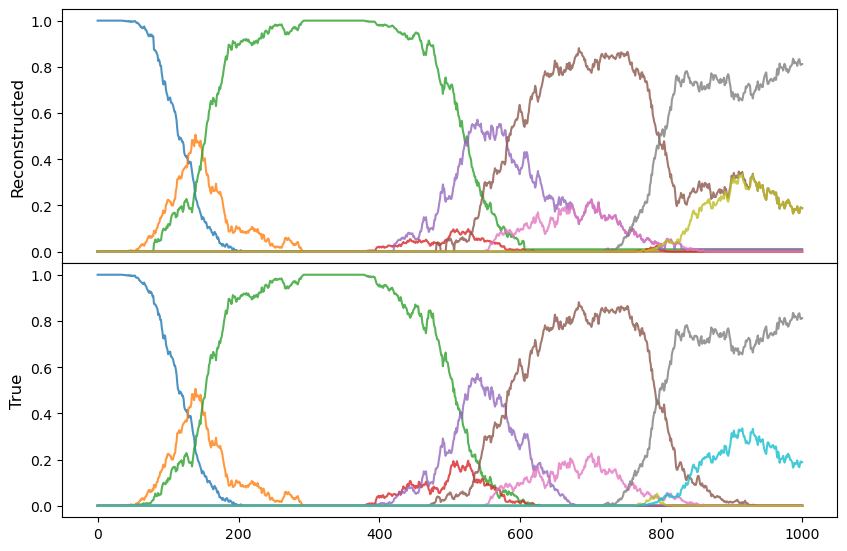

--------------------n=18--------------------


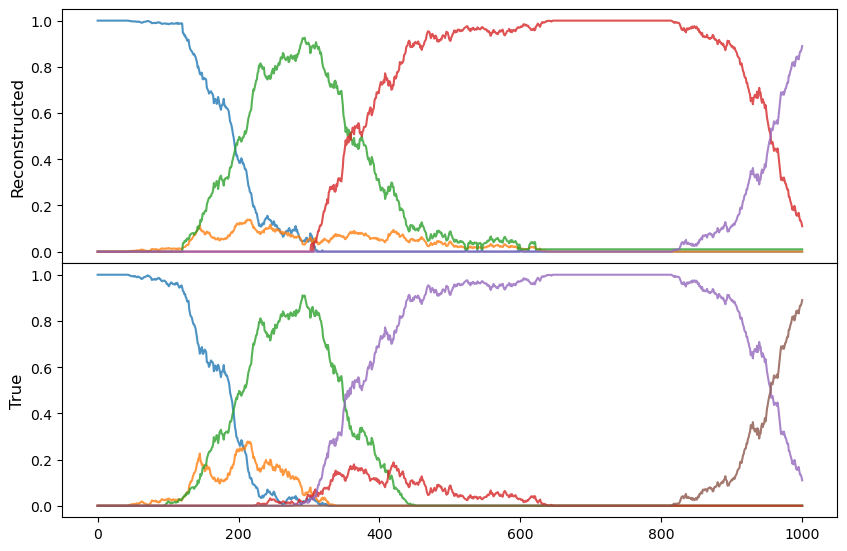

--------------------n=19--------------------


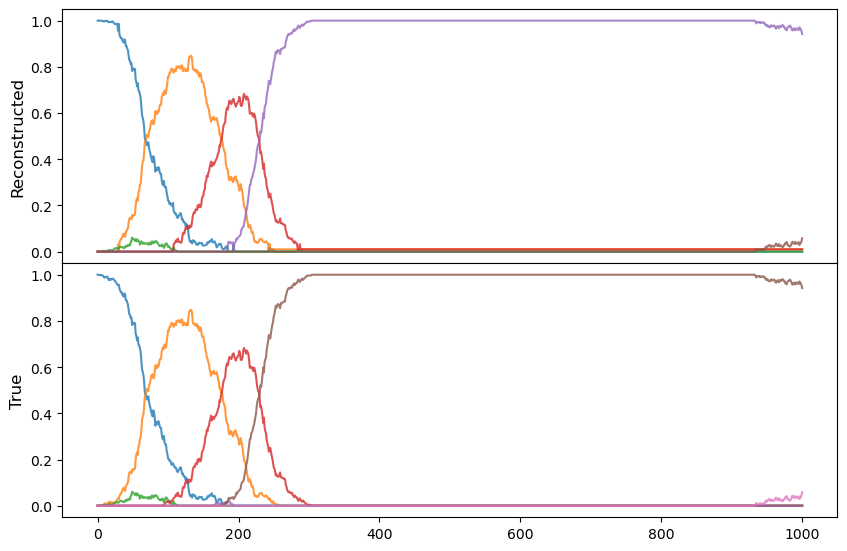

In [77]:
for n in range(start_n, start_n + num_trials):
    print('-' * 20 + f' n={n} ' + '-' * 20)
    print(f"There are {len(trueGenoTraj_all[n][0])} genotypes, {len(data_all[n]['traj'][0])} mutations, reconstructed {len(genoTraj_all[n][0])} genotypes")
    compareWithTrueGenoTraj(genoTraj_all[n], trueGenoTraj_all[n])
    

In [72]:
reload()
graph_all = []
colors_all, alphas_all = [], []
for n in range(start_n, start_n + num_trials):
    graph = lolipop_helper.parseEdges(LOLIPOP_OUTPUT_DIR + f'/n={n}/tables/simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.edges.tsv')
    colors, alphas = lolipop_helper.assignColorsToGenotypes(graph)
    graph_all.append(graph)
    colors_all.append(colors)
    alphas_all.append(alphas)
    

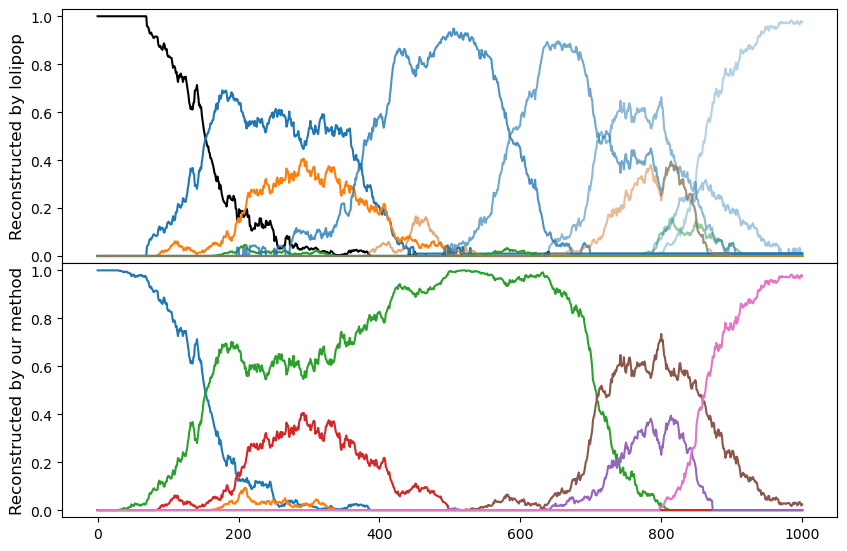

In [73]:
n = 0
compareWithOurMethod(genoTraj_all[n], simulations[n].cladeFreqWithAncestor, colors_all[n], alphas_all[n])

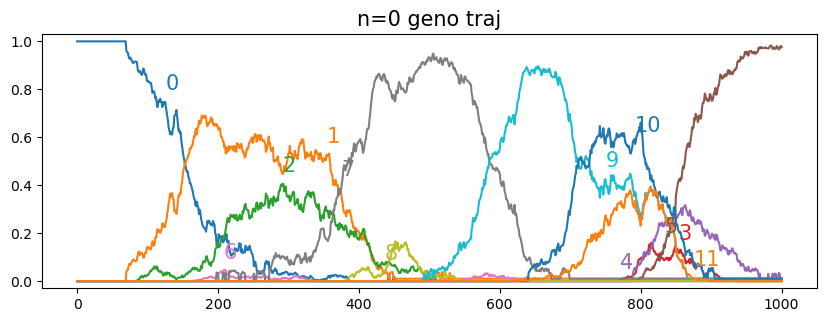

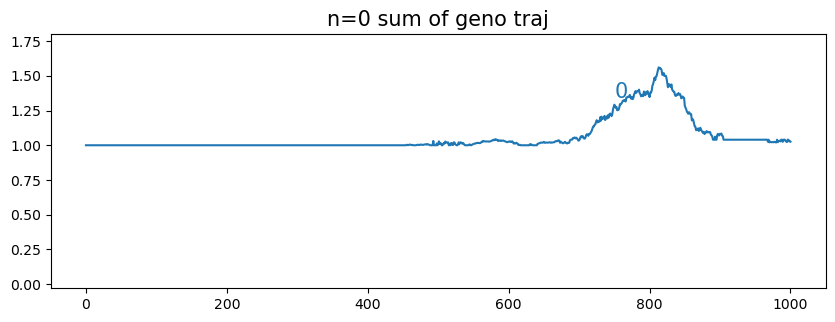

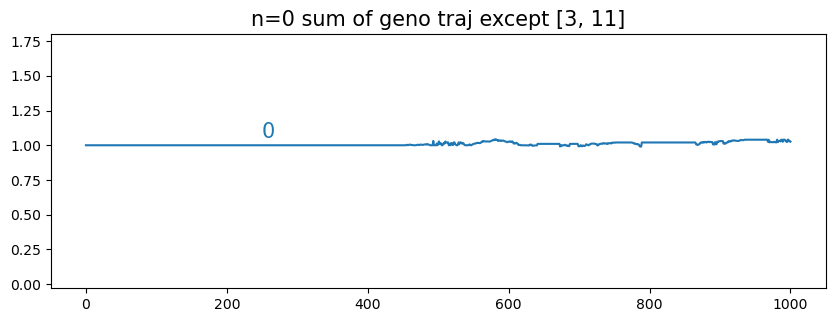

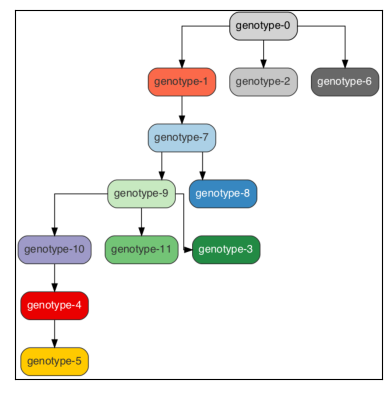

In [368]:
n = 0
AP.plotTraj(genoTraj_all[n], annot=True, ylim=(-0.03, 1.03), title=f'n={n} geno traj')
AP.plotTraj(np.sum(genoTraj_all[n], axis=1)[:, None], annot=True, ylim=(-0.03, 1.8), title=f'n={n} sum of geno traj')
exclude_list = [3, 11]
g_list = [_ for _ in range(len(genoTraj_all[n][0])) if _ not in exclude_list]
AP.plotTraj(np.sum(genoTraj_all[n][:, g_list], axis=1)[:, None], annot=True, ylim=(-0.03, 1.8), title=f'n={n} sum of geno traj except {exclude_list}')

displayLineage(n)

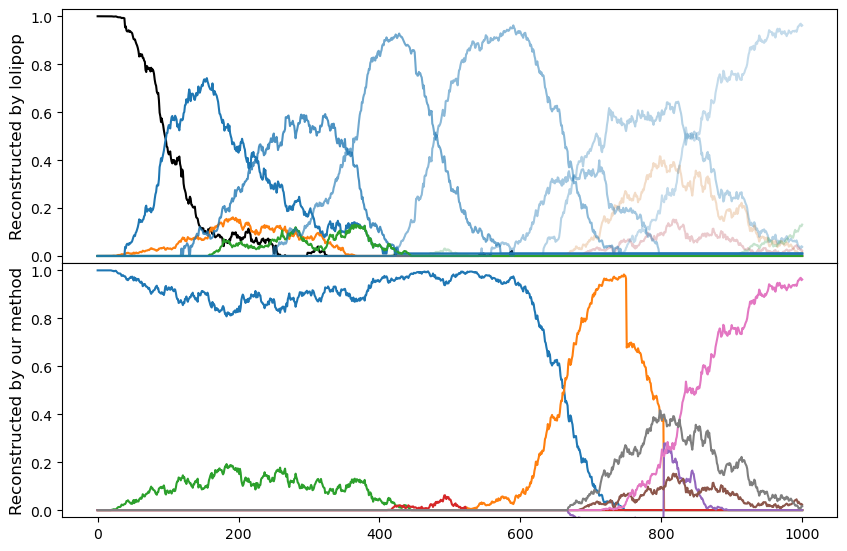

In [78]:
n = 3
compareWithOurMethod(genoTraj_all[n], simulations[n].cladeFreqWithAncestor, colors_all[n], alphas_all[n])

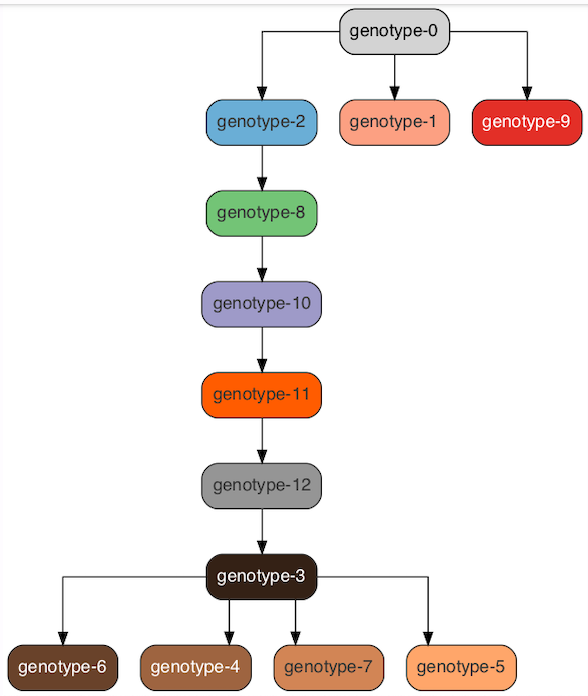

-------------------- n=0 --------------------
There are 14 genotypes, 13 mutations, reconstructed 12 genotypes


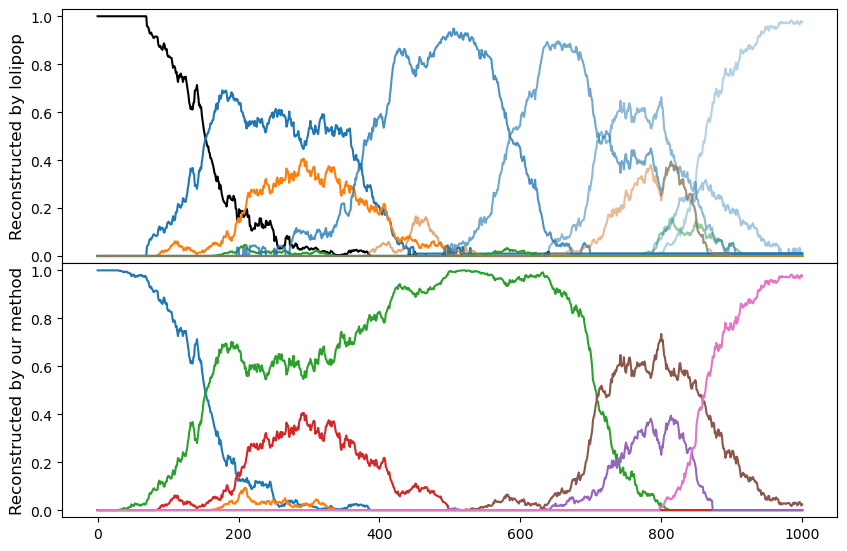

-------------------- n=1 --------------------
There are 10 genotypes, 9 mutations, reconstructed 8 genotypes


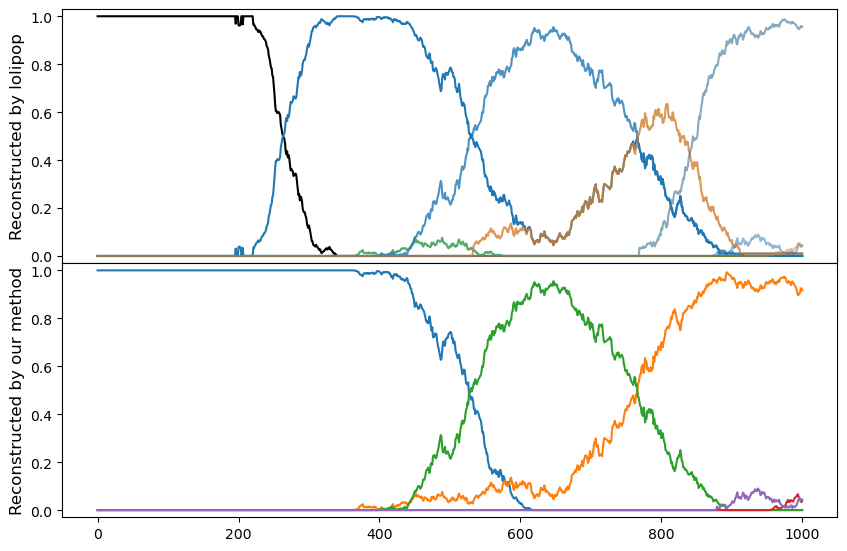

-------------------- n=2 --------------------
There are 16 genotypes, 15 mutations, reconstructed 14 genotypes


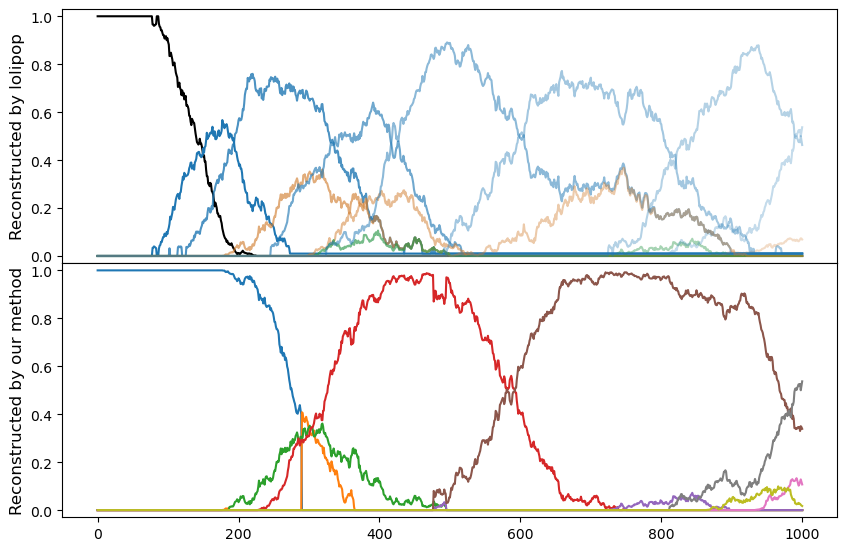

-------------------- n=3 --------------------
There are 16 genotypes, 15 mutations, reconstructed 13 genotypes


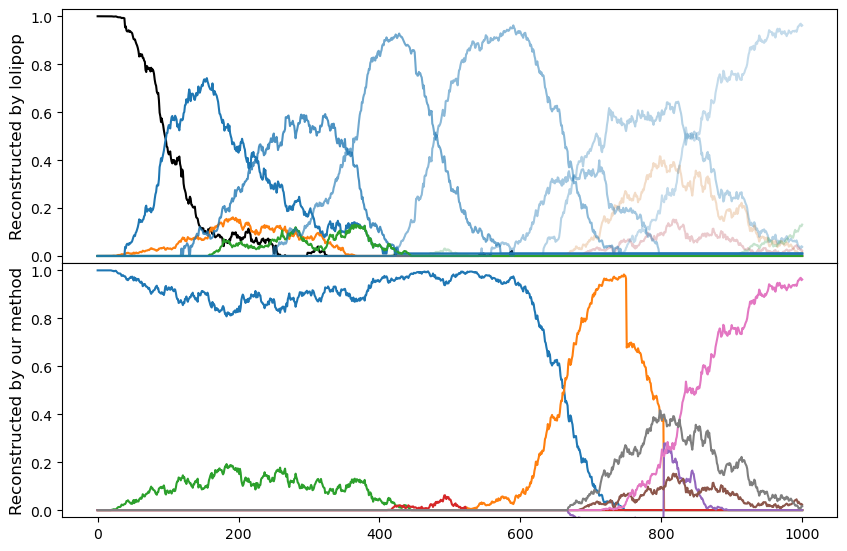

-------------------- n=4 --------------------
There are 11 genotypes, 10 mutations, reconstructed 10 genotypes


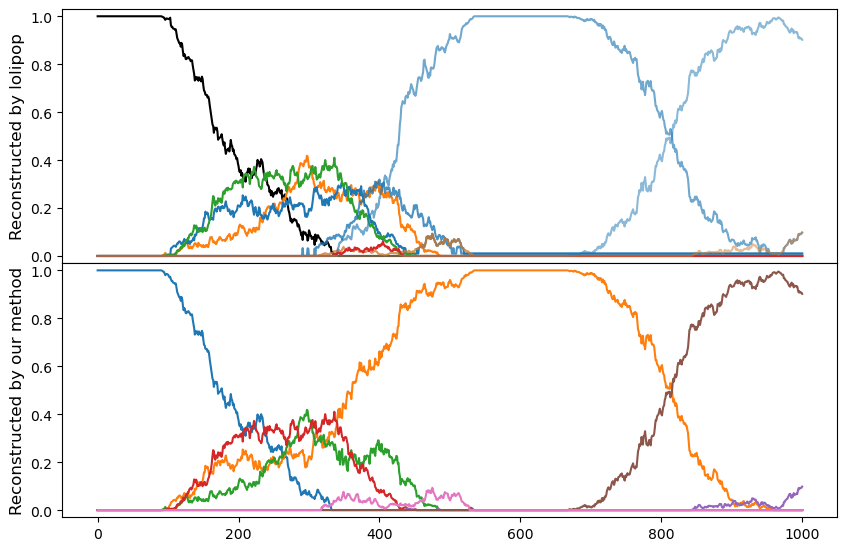

-------------------- n=5 --------------------
There are 8 genotypes, 7 mutations, reconstructed 7 genotypes


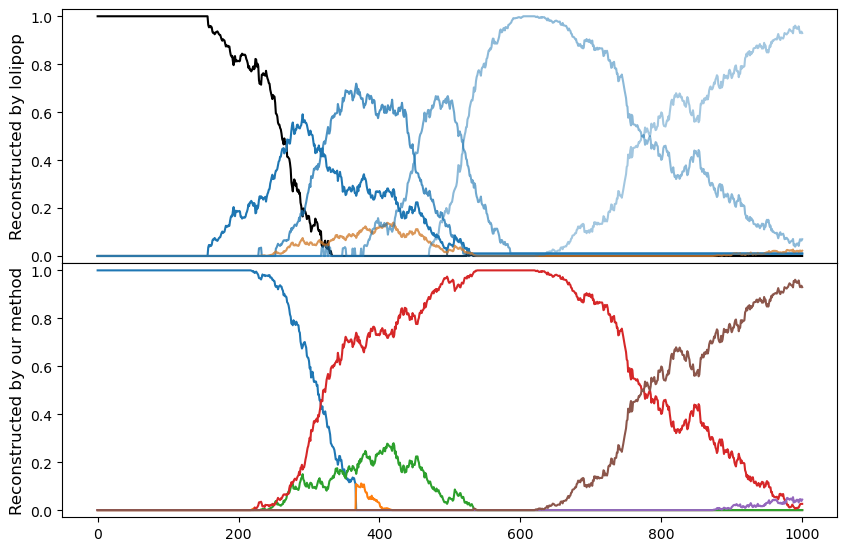

-------------------- n=6 --------------------
There are 11 genotypes, 10 mutations, reconstructed 9 genotypes


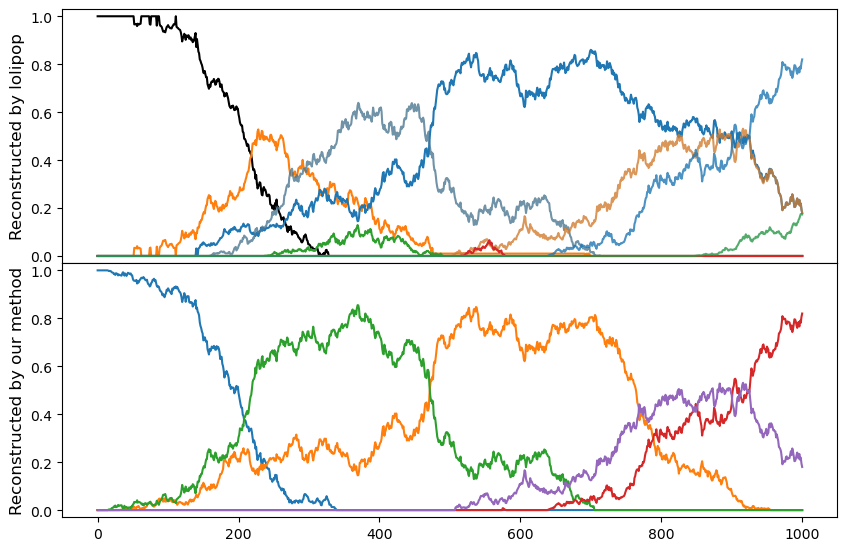

-------------------- n=7 --------------------
There are 9 genotypes, 8 mutations, reconstructed 8 genotypes


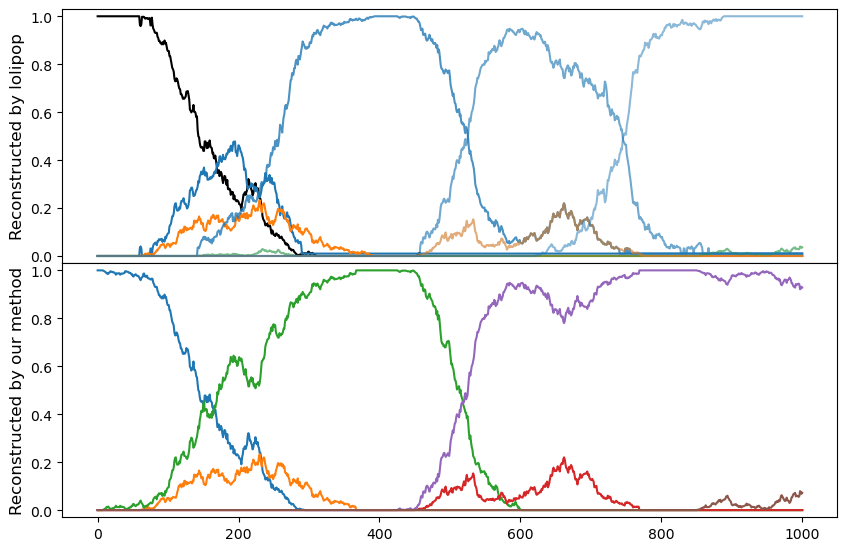

-------------------- n=8 --------------------
There are 19 genotypes, 18 mutations, reconstructed 15 genotypes


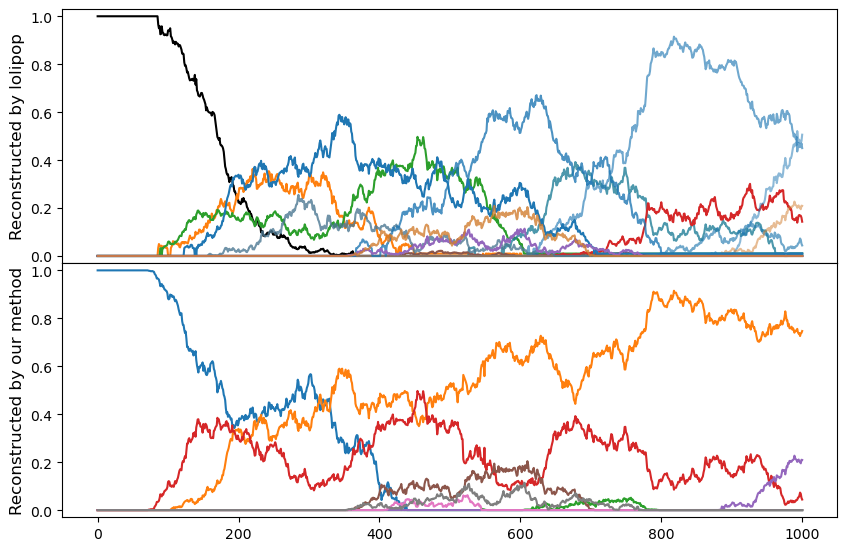

-------------------- n=9 --------------------
There are 11 genotypes, 10 mutations, reconstructed 10 genotypes


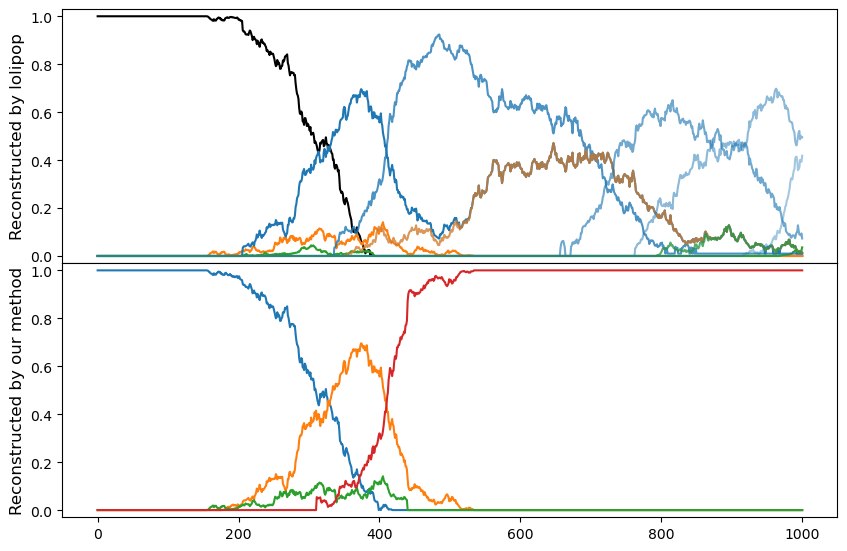

-------------------- n=10 --------------------
There are 15 genotypes, 14 mutations, reconstructed 12 genotypes


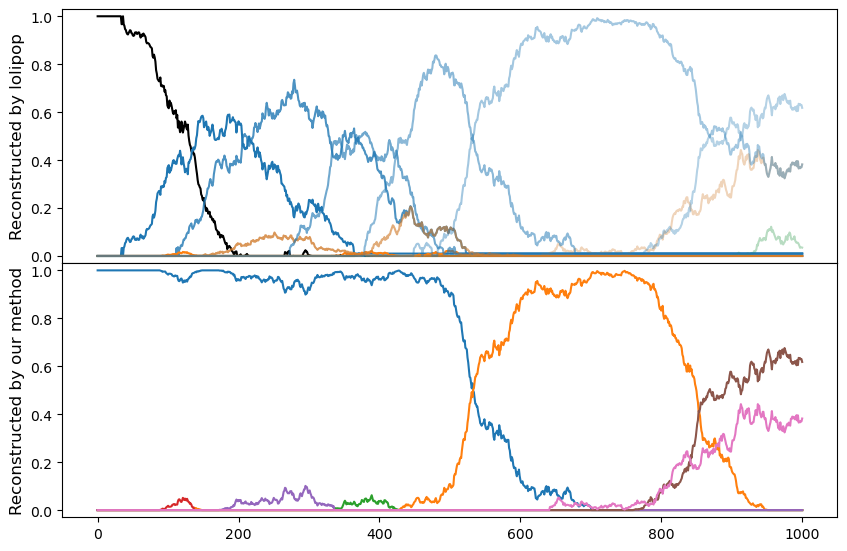

-------------------- n=11 --------------------
There are 11 genotypes, 10 mutations, reconstructed 8 genotypes


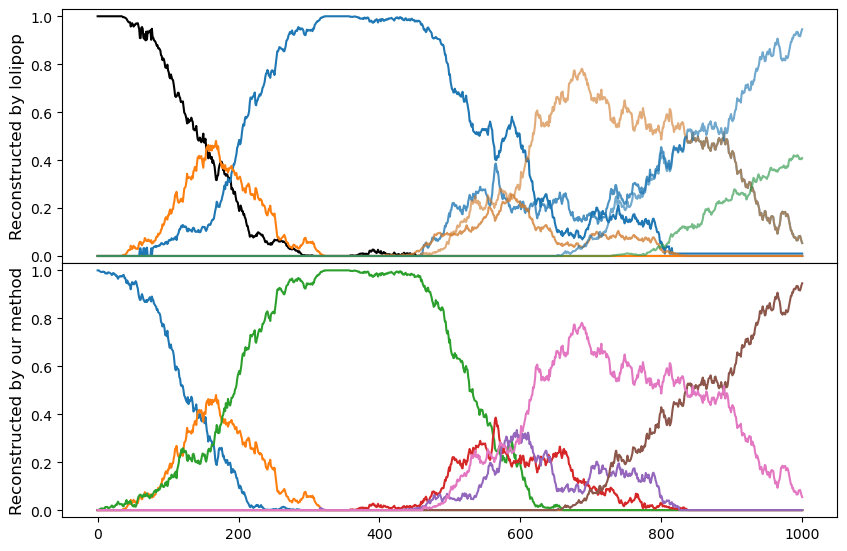

-------------------- n=12 --------------------
There are 15 genotypes, 14 mutations, reconstructed 12 genotypes


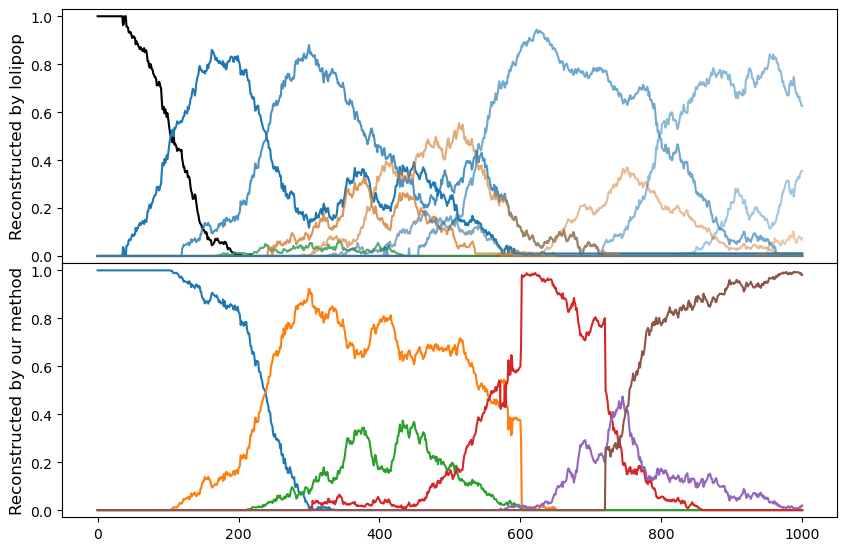

-------------------- n=13 --------------------
There are 4 genotypes, 3 mutations, reconstructed 3 genotypes


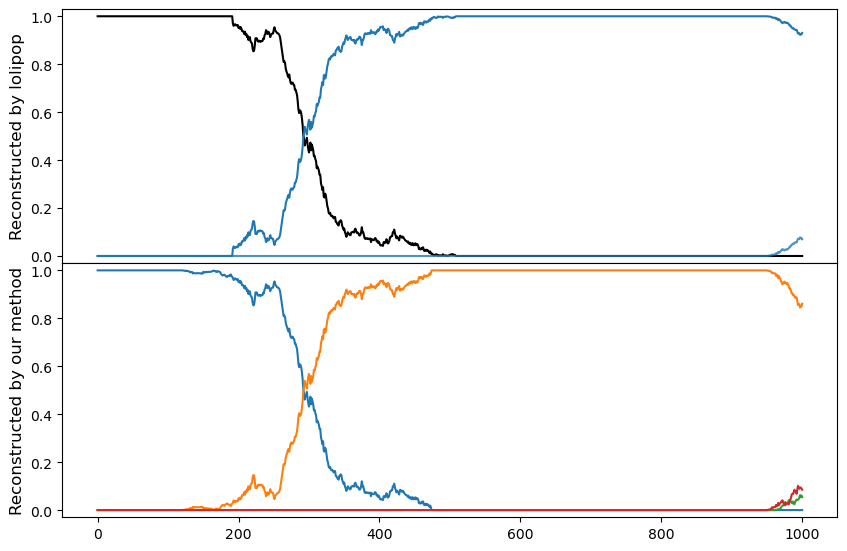

-------------------- n=14 --------------------
There are 10 genotypes, 9 mutations, reconstructed 9 genotypes


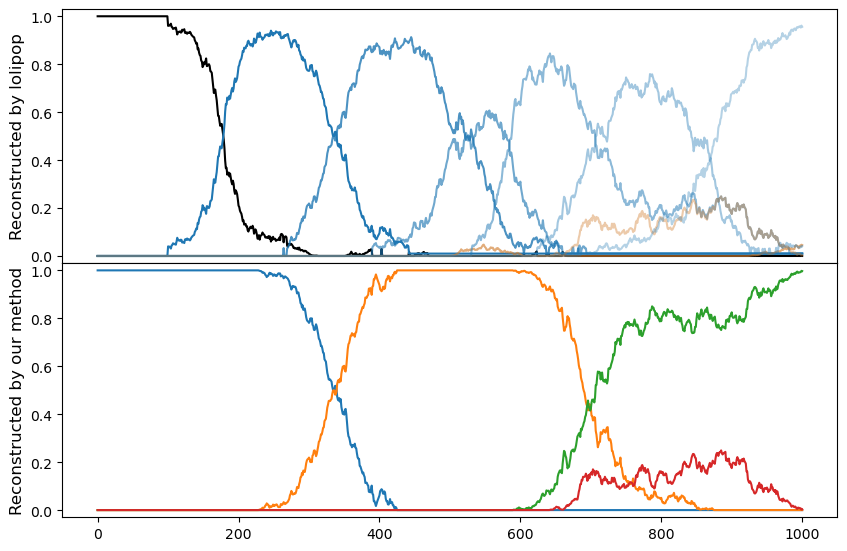

-------------------- n=15 --------------------
There are 15 genotypes, 14 mutations, reconstructed 12 genotypes


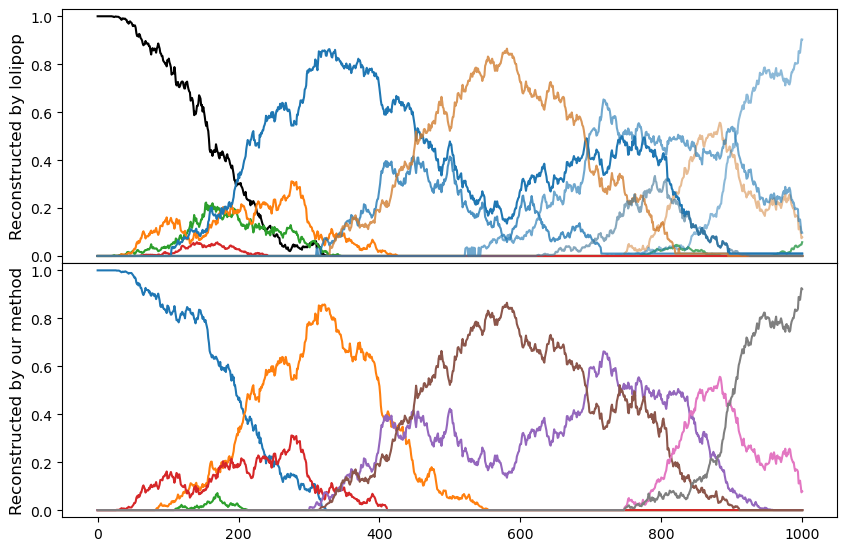

-------------------- n=16 --------------------
There are 7 genotypes, 6 mutations, reconstructed 6 genotypes


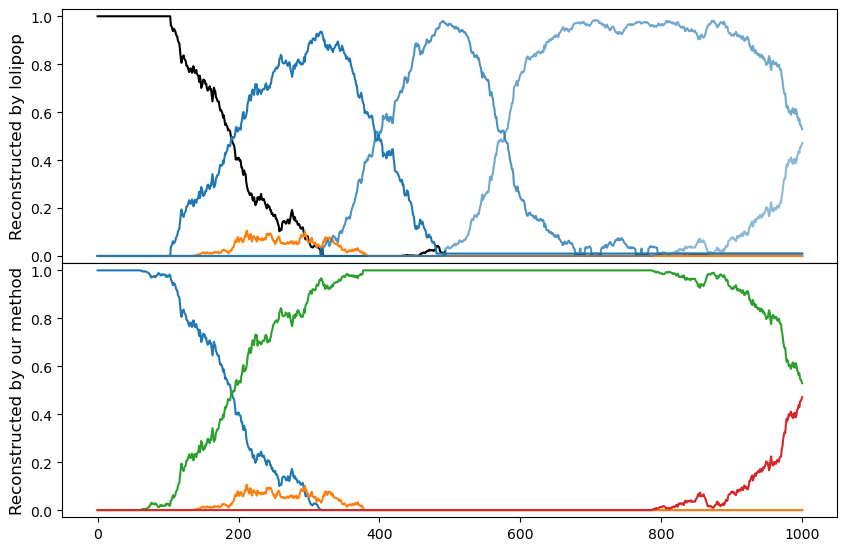

-------------------- n=17 --------------------
There are 10 genotypes, 9 mutations, reconstructed 9 genotypes


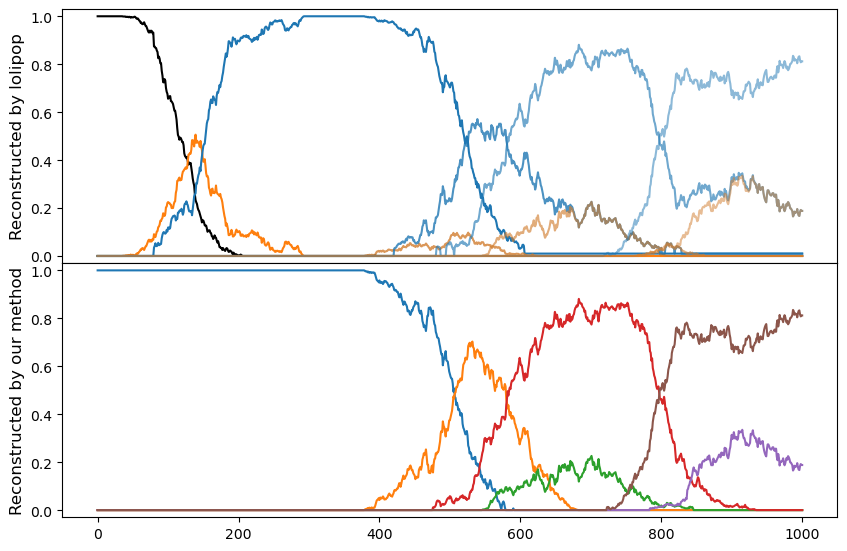

-------------------- n=18 --------------------
There are 6 genotypes, 5 mutations, reconstructed 5 genotypes


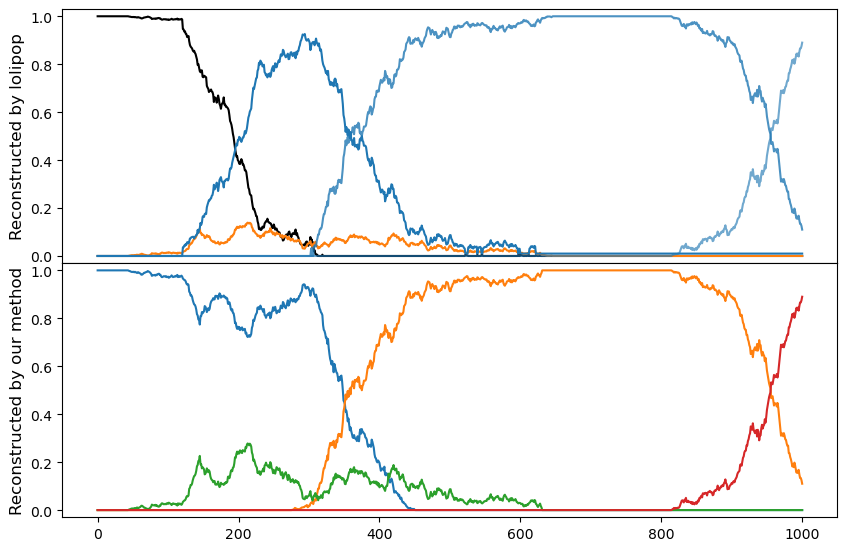

-------------------- n=19 --------------------
There are 7 genotypes, 6 mutations, reconstructed 6 genotypes


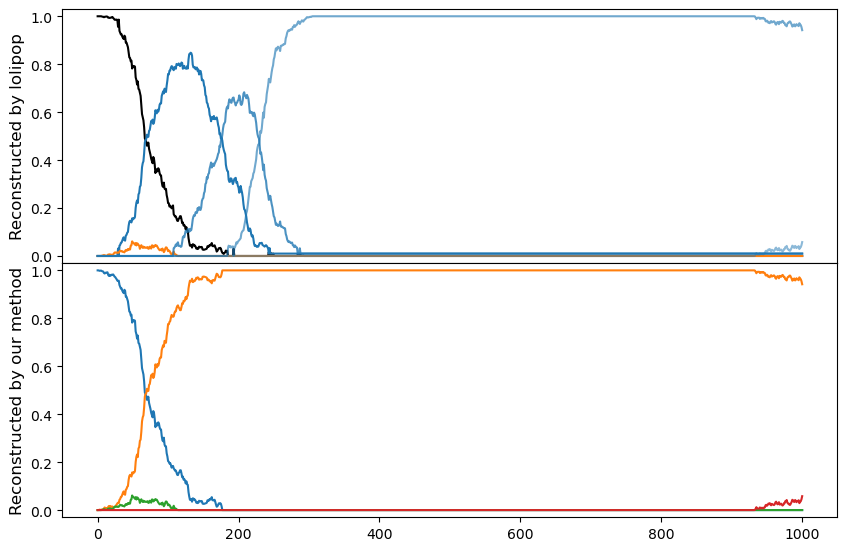

In [74]:
for n in range(start_n, start_n + num_trials):
    print('-' * 20 + f' n={n} ' + '-' * 20)
    print(f"There are {len(trueGenoTraj_all[n][0])} genotypes, {len(data_all[n]['traj'][0])} mutations, reconstructed {len(genoTraj_all[n][0])} genotypes")
    compareWithOurMethod(genoTraj_all[n], simulations[n].cladeFreqWithAncestor, colors_all[n], alphas_all[n])
    

## Evaluation on simulations

In [123]:
def getSummary(dic, mu=2e-4, thFixed=1, useEffectiveMu=True, verbose=False, plot=False):
    simulation = RC.CladeReconstruction(dic['traj'], useEffectiveMu=useEffectiveMu, meanReadDepth=1000, verbose=verbose, plot=plot, mu=mu)
    simulation.setParamsForClusterization(weightByBothVariance=False, weightBySmallerVariance=True)
    simulation.clusterMutations()
    simulation.setParamsForReconstruction(thFixed=thFixed, thExtinct=0, numClades=None, percentMutsToIncludeInMajorClades=95, thLogProbPerTime=10)
    simulation.checkForSeparablePeriodAndReconstruct()
    simulation.setParamsForEvaluation(intCov=dic['cov'], selection=dic['selections'], fitness=np.sum(dic['selections'] * dic['traj'], axis=1))
    return simulation.evaluateInference()

In [124]:
reload()
start_n, num_trials = 0, 40
meanS, stdS, mu, threshold = 0.03, 0.01, 2e-4, 0.05
summaries_99 = []
for n in np.arange(start_n, start_n + num_trials):
    print(f'n={n}', end='\t')
    dic = np.load(f'{SIMULATION_OUTPUT_DIR}/simulation_output_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.npz', allow_pickle=True)
    try:
        summaries_99.append(getSummary(dic, thFixed=0.99, mu=mu, useEffectiveMu=True))
    except:
        print(f'n={n} throws exception. ')
        break
        summaries_99.append(None)
    

n=0	n=1	n=2	n=3	n=4	n=5	n=6	n=7	n=8	n=9	n=10	n=11	n=12	n=13	n=14	n=15	n=16	n=17	n=18	n=19	n=20	n=21	n=22	n=23	n=24	n=25	n=26	n=27	n=28	n=29	n=30	n=31	n=32	n=33	n=34	n=35	n=36	n=37	n=38	n=39	

### Save parsed output file

In [260]:
reload()
start_n, num_trials = 0, 40
meanS, stdS, mu, threshold = 0.03, 0.01, 2e-4, 0.05
for n in np.arange(start_n, start_n + num_trials):
    directory = f'{LOLIPOP_OUTPUT_DIR}/n={n}'
    filename = f'simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}'
    saveFile = f'{LOLIPOP_PARSED_OUTPUT_DIR}/{filename}'
    lolipop_helper.parseOutput(directory, filename, saveFile=saveFile)
    print(f'n={n}', end='\t')

/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


n=0	n=1	n=2	n=3	n=4	n=5	n=6	n=7	n=8	n=9	n=10	n=11	n=12	n=13	n=14	n=15	n=16	n=17	n=18	n=19	n=20	n=21	n=22	n=23	n=24	n=25	n=26	n=27	n=28	n=29	n=30	n=31	n=32	n=33	n=34	n=35	n=36	n=37	n=38	n=39	

### Load parsed output and infer

In [260]:
reload()
def loadParsedOutput(n, meanS=0.03, stdS=0.01, mu=2e-4, threshold=0.05):
    filename = f'simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}'
    parsed_output = f'{LOLIPOP_PARSED_OUTPUT_DIR}/{filename}.npz'
    npz_dic = np.load(parsed_output, allow_pickle=True)
    dic_keys = ['genotypeToMembers', 'memberToGenotype', 'genotypeToParent', 'parentToGenotype']
    all_keys = list(npz_dic.keys())
    data = {}
    for key in all_keys:
        if key in dic_keys:
            data[key] = npz_dic[key][()]
        else:
            data[key] = npz_dic[key]
    return data


def loadParsedOutput_LTEE(pop):
    filename = f'LTEE_interpolated_pop={pop}'
    parsed_output = f'{LOLIPOP_PARSED_OUTPUT_DIR}/{filename}.npz'
    npz_dic = np.load(parsed_output, allow_pickle=True)
    dic_keys = ['genotypeToMembers', 'memberToGenotype', 'genotypeToParent', 'parentToGenotype']
    all_keys = list(npz_dic.keys())
    data = {}
    for key in all_keys:
        if key in dic_keys:
            data[key] = npz_dic[key][()]
        else:
            data[key] = npz_dic[key]
    return data


def displayLineage(n):
    directory = f'{LOLIPOP_OUTPUT_DIR}/n={n}'
    filename = f'simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}'
    image = f'{directory}/graphics/lineage/{filename}.lineage.png'
    img = mpimg.imread(image)
    imgplot = plt.imshow(img)
    plt.xticks(ticks=[], labels=[])
    plt.yticks(ticks=[], labels=[])
    plt.show()
    
    
def inferForSimulations(start_n=0, num_trials=20, meanS=0.03, stdS=0.01, mu=2e-4, threshold=0.05, muForInference=1e-6, regularization=1):
    intCov_all, selection_all, fitness_all, intCovError_all = [], [], [], []
    for n in np.arange(start_n, start_n + num_trials):
        data = loadParsedOutput(n, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
        intCov, selection, fitness = lolipop_helper.inferencePipeline(data, mu=muForInference, regularization=regularization)
        dic = loadSimulation(n, meanS=meanS, stdS=stdS, mu=mu)
        intCovError = intCov - dic['cov']
        
        intCov_all.append(intCov)
        selection_all.append(selection)
        fitness_all.append(fitness)
        intCovError_all.append(intCovError)
    return intCov_all, selection_all, fitness_all, intCovError_all


def checkSum(start_n=0, num_trials=20, meanS=0.03, stdS=0.01, mu=2e-4, threshold=0.05):
    for n in np.arange(start_n, start_n + num_trials):
        data = loadParsedOutput(n, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
        genotypeToMembers = data['genotypeToMembers']
        parentToGenotype = data['parentToGenotype']
        traj = data['traj']
        mutsOfFirstDescendants = []
        for g in parentToGenotype[0]:
            mutsOfFirstDescendants += genotypeToMembers[g]
        sumFreq = np.sum(traj[:, mutsOfFirstDescendants], axis=1)[:, None]
        firstTraj = np.hstack((sumFreq, traj[:, mutsOfFirstDescendants]))
        if not np.all(sumFreq <= 1.01):
            AP.plotTraj(firstTraj, annot=True, annotTexts=['sum'] + mutsOfFirstDescendants, title=f'n={n}', ylim=(-0.03, 1.5))

            
def checkSum_2(start_n=0, num_trials=20, meanS=0.03, stdS=0.01, mu=2e-4, threshold=0.05, tolerance=0):
    for n in np.arange(start_n, start_n + num_trials):
        data = loadParsedOutput(n, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
        genoTraj = data['genoTraj']
        genotypeToMembers = data['genotypeToMembers']
        parentToGenotype = data['parentToGenotype']
        total_count = 0
        count_not_match = 0
        for parent, desendants in parentToGenotype.items():
            total_count += 1
            sumFreq = np.sum(genoTraj[:, desendants], axis=1)
            if not np.all(sumFreq <= genoTraj[:, parent] + tolerance):
                count_not_match += 1
                print('Largest discrepancy: ', np.max(sumFreq - genoTraj[:, parent]))
        print(f'Not matching: {count_not_match} / {total_count}')
        
        
def checkSum_3(start_n=0, num_trials=20, meanS=0.03, stdS=0.01, mu=2e-4, threshold=0.05, tolerance=0):
    for n in np.arange(start_n, start_n + num_trials):
        data = loadParsedOutput(n, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
        traj = data['traj']
        genoTraj = data['genoTraj']
        genotypeToMembers = data['genotypeToMembers']
        parentToGenotype = data['parentToGenotype']
        total_count = 0
        count_not_match = 0
        for parent, desendants in parentToGenotype.items():
            total_count += 1
            sumFreq = np.sum(genoTraj[:, desendants], axis=1)
            if not np.all(sumFreq <= 1 + tolerance):
                count_not_match += 1
                print('Largest discrepancy: ', np.max(sumFreq - 1))
                AP.plotTraj(genoTraj[:, [parent] + desendants], annot=True, annotTexts=['parent'] + desendants, alpha=0.5, plotShow=False)
                allMembers = []
                colors = []
                for i, g in enumerate(desendants):
                    members = genotypeToMembers[g]
                    allMembers += members
                    colors += [AP.COLORS[i + 1]] * len(members)
                AP.plotTraj(traj[:, allMembers], colors=colors, scatterOnly=True, alpha=0.5, plotFigure=False)
        print(f'Not matching: {count_not_match} / {total_count}')
        
        
def checkSum_4(start_n=0, num_trials=20, meanS=0.03, stdS=0.01, mu=2e-4, threshold=0.05, tolerance=0):
    for n in np.arange(start_n, start_n + num_trials):
        data = loadParsedOutput(n, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
        traj = data['traj']
        genoTraj = data['genoTraj']
        genotypeToMembers = data['genotypeToMembers']
        parentToGenotype = data['parentToGenotype']
        total_count = 0
        count_not_match = 0
        for parent, desendants in parentToGenotype.items():
            total_count += 1
            sumFreq = np.sum(genoTraj[:, desendants], axis=1)
            if not np.all(sumFreq > 0.9):
                count_not_match += 1
                print('Largest discrepancy: ', np.min(sumFreq - 1))
#                 AP.plotTraj(genoTraj[:, [parent] + desendants], annot=True, annotTexts=['parent'] + desendants, alpha=0.5, plotShow=False)
#                 allMembers = []
#                 colors = []
#                 for i, g in enumerate(desendants):
#                     members = genotypeToMembers[g]
#                     allMembers += members
#                     colors += [AP.COLORS[i + 1]] * len(members)
#                 AP.plotTraj(traj[:, allMembers], colors=colors, scatterOnly=True, alpha=0.5, plotFigure=False)
        print(f'Not matching: {count_not_match} / {total_count}')
        

def checkGenotypeToMembers(start_n=0, num_trials=20, meanS=0.03, stdS=0.01, mu=2e-4, threshold=0.05):
    for n in np.arange(start_n, start_n + num_trials):
        data = loadParsedOutput(n, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
        genotypeToMembers = data['genotypeToMembers']
        for g, members in enumerate(genotypeToMembers):
            print(f'genotype={g}: ', members)
        
    

In [173]:
reload()
intCov_all, selection_all, fitness_all, intCovError_all = inferForSimulations(num_trials=40)

In [127]:
intCov_all_reg, selection_all_reg, fitness_all_reg, intCovError_all_reg = {}, {}, {}, {}
for reg in [1, 4, 8]:
    (intCov_all_reg[reg], selection_all_reg[reg], fitness_all_reg[reg], 
     intCovError_all_reg[reg]) = inferForSimulations(regularization=reg)

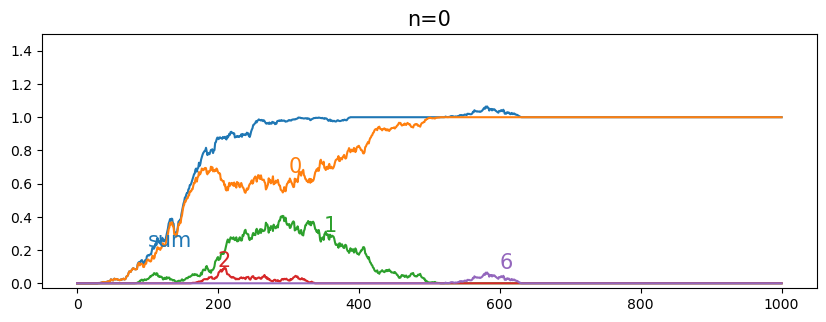

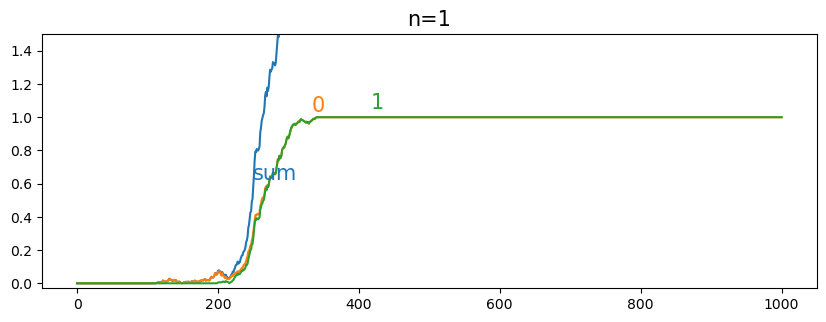

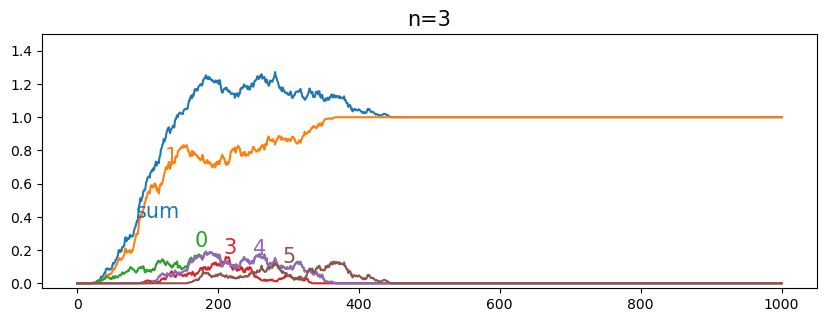

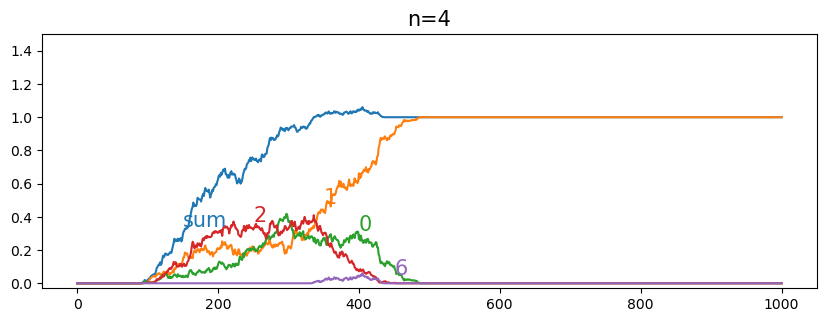

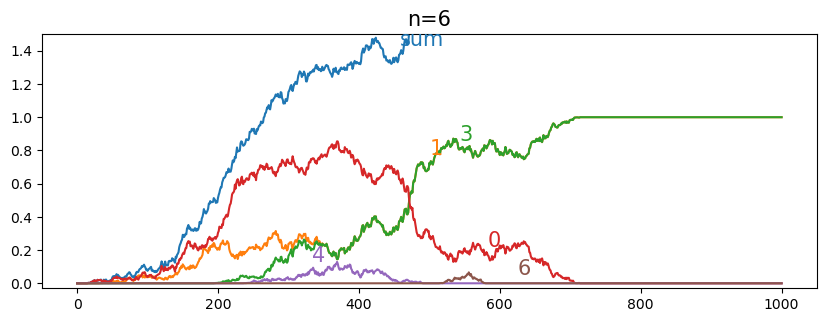

...

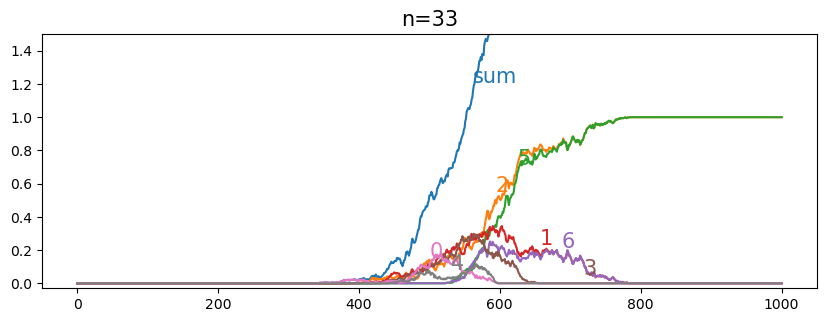

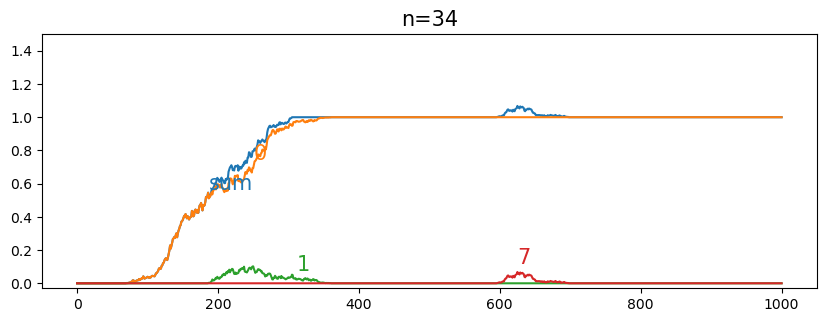

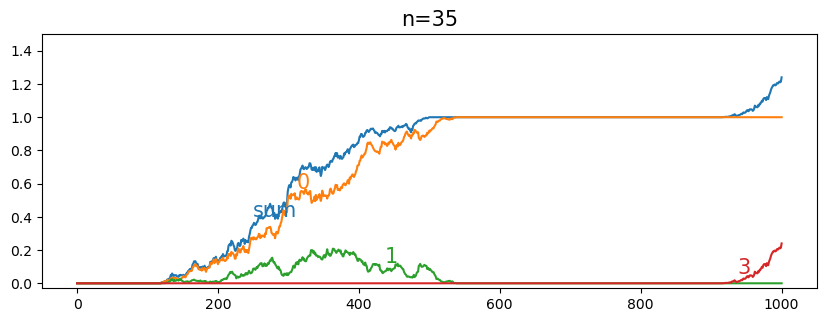

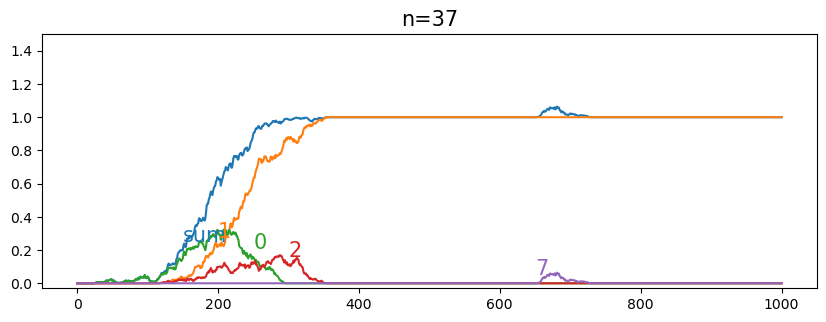

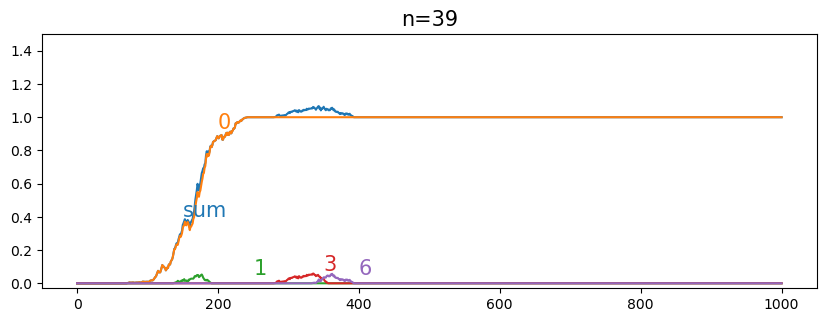

In [174]:
# Allele frequencies of signature mutations of first descendants and their sum
checkSum(num_trials=40)

In [239]:
checkSum_2(num_trials=40, tolerance=0.1)

Largest discrepancy:  0.902
Largest discrepancy:  0.9390000000000001
Largest discrepancy:  0.863
Largest discrepancy:  0.738
Largest discrepancy:  0.204
Largest discrepancy:  0.973
Not matching: 6 / 12
Largest discrepancy:  1.0
Largest discrepancy:  0.955
Largest discrepancy:  0.977
Not matching: 3 / 8
Largest discrepancy:  0.4909999999999999
Largest discrepancy:  0.7020000000000001
Largest discrepancy:  0.709
Largest discrepancy:  0.877
Largest discrepancy:  0.724
Largest discrepancy:  0.869
Largest discrepancy:  0.14266666666666672
Not matching: 7 / 14
Largest discrepancy:  0.7426666666666667
Largest discrepancy:  0.5030000000000001
Largest discrepancy:  0.9179999999999999
Largest discrepancy:  0.9520000000000001
Largest discrepancy:  0.33899999999999986
Largest discrepancy:  0.634
Largest discrepancy:  1.0950000000000002
Not matching: 7 / 13
Largest discrepancy:  0.9089999999999999
Largest discrepancy:  0.2475000000000001
Largest discrepancy:  0.99
Largest discrepancy:  0.99
Not mat

Not matching: 0 / 12
Not matching: 0 / 8
Not matching: 0 / 14
Largest discrepancy:  0.131


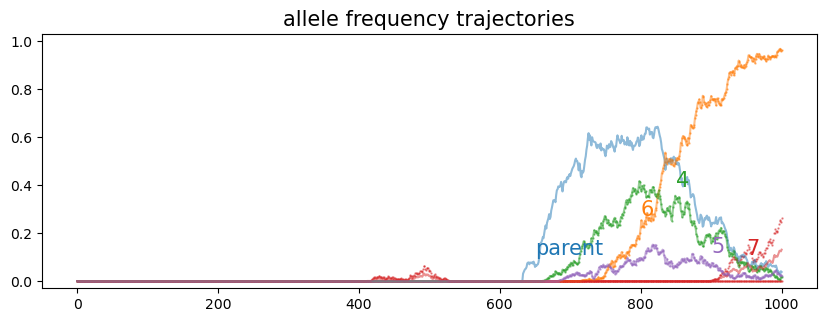

Not matching: 1 / 13
Not matching: 0 / 10
Not matching: 0 / 7
Largest discrepancy:  0.17500000000000027


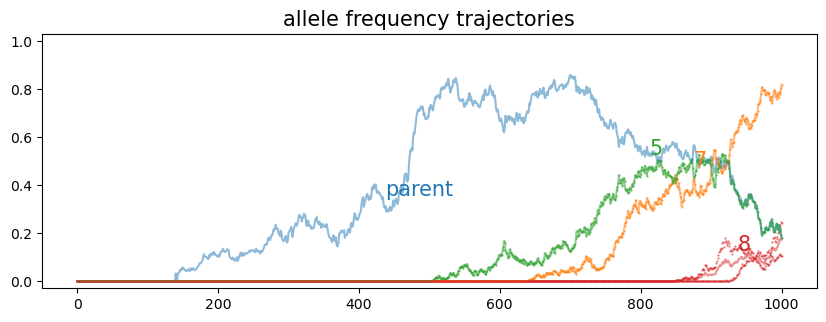

Not matching: 1 / 9
Not matching: 0 / 8
Not matching: 0 / 15
Not matching: 0 / 10
Largest discrepancy:  0.12199999999999989


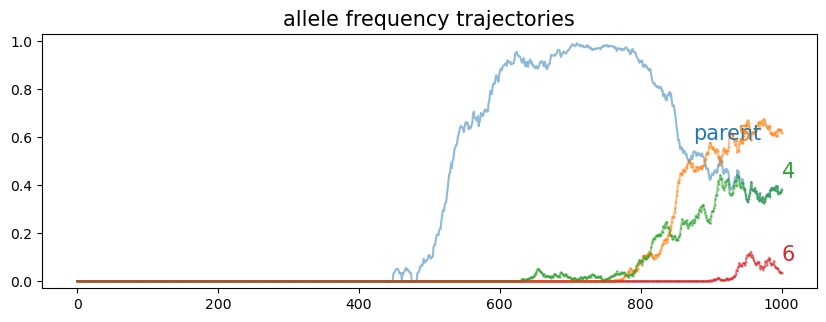

Not matching: 1 / 12
Largest discrepancy:  0.4205000000000001


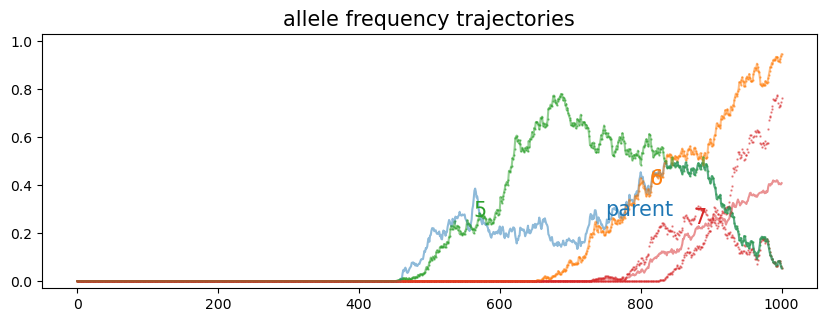

Not matching: 1 / 8
Not matching: 0 / 12
Not matching: 0 / 3
Not matching: 0 / 9
Not matching: 0 / 12
Not matching: 0 / 6
Not matching: 0 / 9
Not matching: 0 / 5
Not matching: 0 / 6
Not matching: 0 / 7
Not matching: 0 / 7
Largest discrepancy:  0.1739999999999997


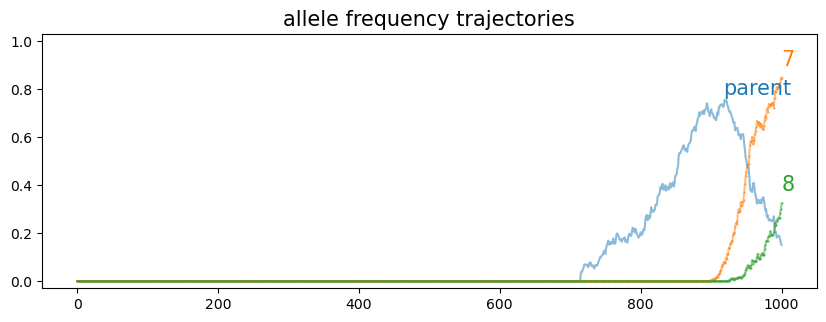

Not matching: 1 / 15
Not matching: 0 / 9
Not matching: 0 / 8
Not matching: 0 / 12
Not matching: 0 / 6
Not matching: 0 / 7
Not matching: 0 / 8
Not matching: 0 / 7
Not matching: 0 / 7
Not matching: 0 / 12
Not matching: 0 / 11
Not matching: 0 / 8
Not matching: 0 / 9
Not matching: 0 / 4
Not matching: 0 / 6
Not matching: 0 / 9
Not matching: 0 / 11
Not matching: 0 / 11


In [259]:
checkSum_3(num_trials=40, tolerance=0.1)

In [261]:
checkSum_4(num_trials=40, tolerance=0.1)

Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Not matching: 12 / 12
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Not matching: 8 / 8
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Largest discrepancy:  -1.0
Not matching: 14 / 14
Largest discrepanc

In [352]:
checkGenotypeToMembers(num_trials=4)

genotype=0:  []
genotype=1:  [0]
genotype=2:  [1]
genotype=3:  [10]
genotype=4:  [11]
genotype=5:  [12]
genotype=6:  [2, 6]
genotype=7:  [3]
genotype=8:  [4]
genotype=9:  [5]
genotype=10:  [7]
genotype=11:  [8, 9]
genotype=0:  []
genotype=1:  [0, 1]
genotype=2:  [2]
genotype=3:  [3]
genotype=4:  [4]
genotype=5:  [5]
genotype=6:  [6]
genotype=7:  [7, 8]
genotype=0:  []
genotype=1:  [0]
genotype=2:  [1]
genotype=3:  [10]
genotype=4:  [11]
genotype=5:  [12, 13, 14]
genotype=6:  [2]
genotype=7:  [3]
genotype=8:  [4]
genotype=9:  [5]
genotype=10:  [6]
genotype=11:  [7]
genotype=12:  [8]
genotype=13:  [9]
genotype=0:  []
genotype=1:  [0, 3, 4]
genotype=2:  [1]
genotype=3:  [10]
genotype=4:  [11]
genotype=5:  [12]
genotype=6:  [13]
genotype=7:  [14, 8]
genotype=8:  [2]
genotype=9:  [5]
genotype=10:  [6]
genotype=11:  [7]
genotype=12:  [9]


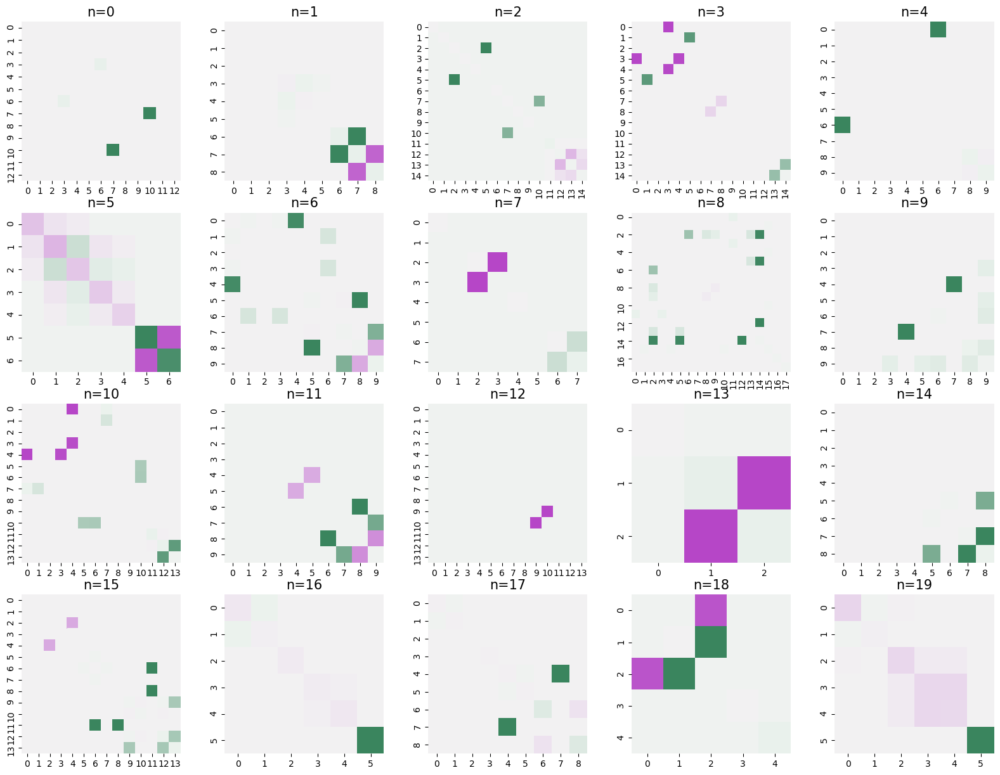

In [151]:
reload()
AP.plotCovList(intCovError_all)

In [220]:
def getPerf(summaries, index=3, name='recovered'):
    MAE = np.zeros(len(summaries))
    spearmanr = np.zeros(len(summaries))
    for n, summary in enumerate(summaries):
        trueCov, recovered = summary['true_cov'][index], summary[name][index]
        MAE[n] = RC.MAE(trueCov, recovered)
        spearmanr[n], _ = stats.spearmanr(np.ndarray.flatten(trueCov), np.ndarray.flatten(recovered))
    return MAE, spearmanr


def getPerfFromList(summaries, perfList, index=3):
    MAE = np.zeros(len(perfList))
    spearmanr = np.zeros(len(perfList))
    for n, perf in enumerate(perfList):
        summary = summaries[n]
        trueCov = summary['true_cov'][index]
        MAE[n] = RC.MAE(trueCov, perf)
        spearmanr[n], _ = stats.spearmanr(np.ndarray.flatten(trueCov), np.ndarray.flatten(perf))
    return MAE, spearmanr
    

def plotPerf(summaries, index=3, compareName='est_cov', figsize=(10, 4)):
    MAE, spearmanr = getPerf(summaries, index=index, compareName=compareName)
    fig, axes = plt.subplots(1, 2, figsize=figsize)
    plt.sca(axes[0])
    plt.hist(MAE)
    plt.title('MAE')
    plt.sca(axes[1])
    plt.hist(spearmanr, bins=np.arange(0, 1.1, 0.1))
#     yticks = np.arange(0, len(summaries) + 5, 5)
#     plt.yticks(ticks=yticks, labels=yticks)
    plt.title('Spearmanr')
    plt.show()
    
    
def plotPerfComparison(summaries, index=3, compareName='lolipop', compareList=None, figsize=(10, 4), alpha=0.6):
    if index == 2:
        postfix = ' for selections'
    elif index ==3:
        postfix = ' for fitness'
    elif index == 1:
        postfix = ' for covariance'
    MAE, spearmanr = getPerf(summaries, index=index, name='recovered')
    MAE_compare, spearmanr_compare = getPerfFromList(summaries, compareList, index=index)
    fig, axes = plt.subplots(1, 2, figsize=figsize)
    plt.sca(axes[0])
    bins = np.arange(0, max(np.max(MAE), np.max(MAE_compare)) + 0.01, 0.01)
    plt.hist(MAE, bins=bins, label='recovered', alpha=alpha)
    plt.hist(MAE_compare, bins=bins, label=compareName, alpha=alpha)
    plt.title('MAE' + postfix)
    plt.legend()
    plt.sca(axes[1])
    plt.hist(spearmanr, bins=np.arange(0, 1.1, 0.1), label='recovered', alpha=alpha)
    plt.hist(spearmanr_compare, bins=np.arange(0, 1.1, 0.1), label=compareName, alpha=alpha)
#     yticks = np.arange(0, len(summaries) + 5, 5)
#     plt.yticks(ticks=yticks, labels=yticks)
    plt.title('Spearmanr' + postfix)
    plt.legend()
    plt.show()


def checkPerfStats(summaries, index=3, compareName='est_cov', closeStandard='MAE<0.01'):
    if index == 3:
        print(f'For fitness trajectories')
    elif index == 2:
        print(f'For selections')
    count_close_to_true = 0
    count_better_than_compare = 0
    for n, summary in enumerate(summaries_99):
        trueCov, recovered, compare = summary['true_cov'][index], summary['recovered'][index], summary[compareName][index]
        MAE_recovered = RC.MAE(trueCov, recovered)
        MAE_compare = RC.MAE(trueCov, compare)
        spearmanr_recovered, _ = stats.spearmanr(trueCov, recovered)
        if MAE_recovered < MAE_compare:
            count_better_than_compare += 1
        if closeStandard[:3] == 'MAE':
            th = float(closeStandard[4:])
            if MAE_recovered < th:
                count_close_to_true += 1
        elif closeStandard[:9] == 'spearmanr':
            th = float(closeStandard[10:])
            if spearmanr_recovered > th:
                count_close_to_true += 1
    print(f'Better than {compareName} (in terms of MAE): ', count_better_than_compare, '/ 40')
    print(f'Close to trueCov ({closeStandard}): ', count_close_to_true, '/ 40')
    

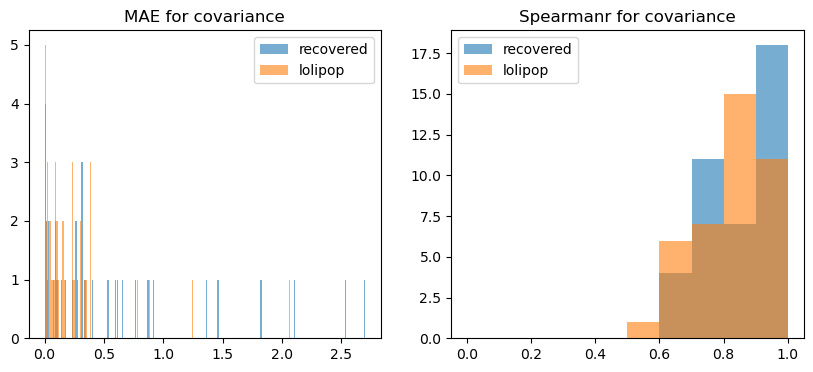

In [221]:
plotPerfComparison(summaries_99, index=1, compareName='lolipop', compareList=intCov_all, figsize=(10, 4))

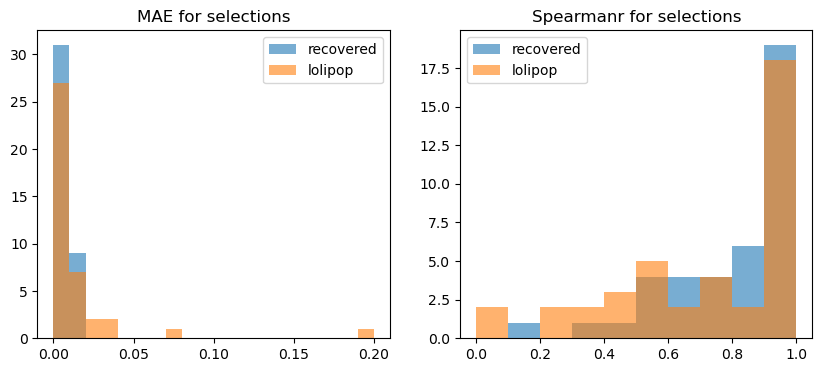

In [222]:
plotPerfComparison(summaries_99, index=2, compareName='lolipop', compareList=selection_all, figsize=(10, 4))

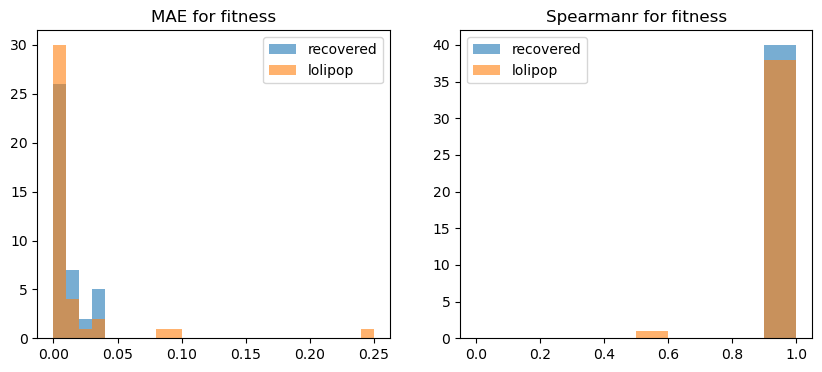

In [168]:
plotPerfComparison(summaries_99, index=3, compareName='lolipop', compareList=fitness_all, figsize=(10, 4))

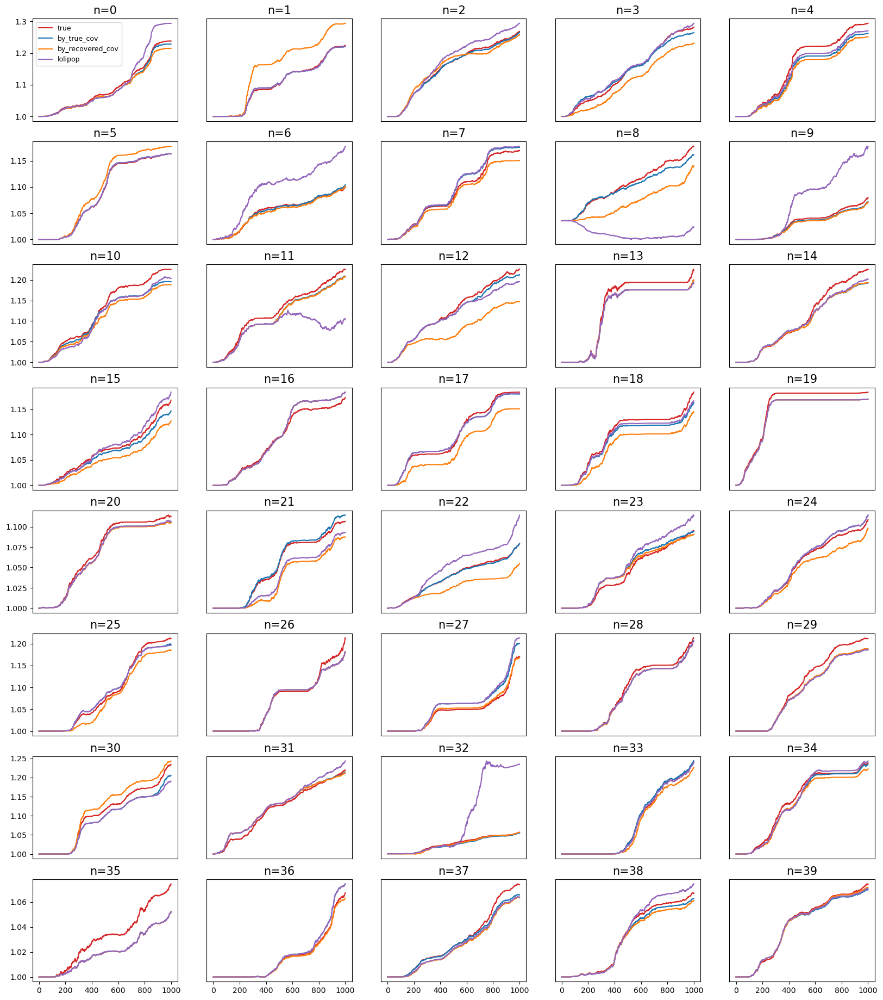

In [149]:
reload()
AP.plotFitnessForSimulations(summaries_99, compareEstCov=False, compareFitnessList=fitness_all, 
                             compareLabel='lolipop', figsize=(20, 23))


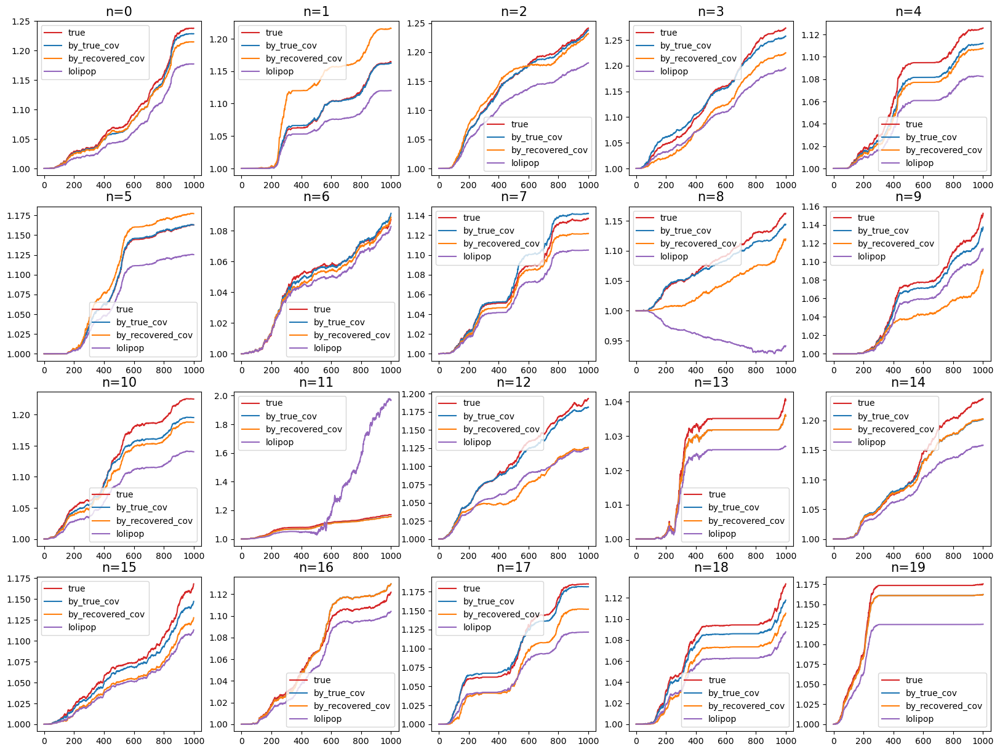

In [233]:
reload()
AP.plotFitnessForSimulations(summaries_99, compareEstCov=False, compareFitnessList=fitness_all_reg[8], compareLabel='lolipop')


### Check individual case

In [225]:
def checkIndividualCase(n, l_list, additional_g_list=[], compareWithUs=False, compareWithTrue=True):
    displayLineage(n)
    data = loadParsedOutput(n)
    for g, members in enumerate(data['genotypeToMembers']):
        print(f'genotype {g}: ', members)
    traj = data['traj']
    AP.plotCovarianceComparison(summaries_99[n]['true'][1], intCov_all[n], titles=['true', 'lolipop', 'error'])
    genoTraj, g_list = data['genoTraj'], [data['memberToGenotype'][l] for l in l_list]
    g_list += [data['genotypeToParent'][g] for g in g_list]
    g_list += additional_g_list
    g_list = np.unique(g_list)
    AP.plotTraj(traj[:, l_list], annot=True, labels=l_list, title='allele traj')
    AP.plotTraj(genoTraj[:, g_list], annot=True, labels=g_list, title='lolipop geno traj')
    if compareWithUs:
        compareWithOurMethod(genoTraj_all[n], simulations[n].cladeFreqWithAncestor, colors_all[n], alphas_all[n])
    if compareWithTrue:
        compareWithTrueGenoTraj(genoTraj_all[n], trueGenoTraj_all[n])

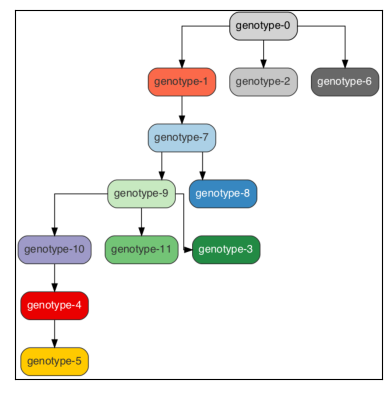

genotype 0:  []
genotype 1:  [0]
genotype 2:  [1]
genotype 3:  [10]
genotype 4:  [11]
genotype 5:  [12]
genotype 6:  [2, 6]
genotype 7:  [3]
genotype 8:  [4]
genotype 9:  [5]
genotype 10:  [7]
genotype 11:  [8, 9]


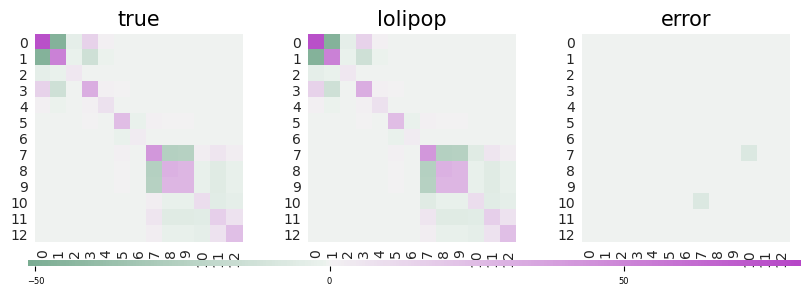

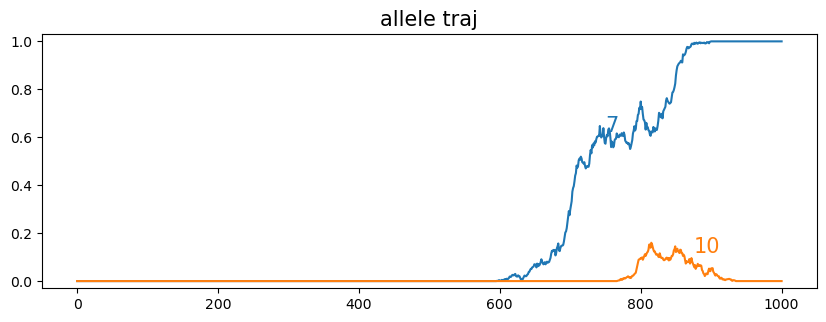

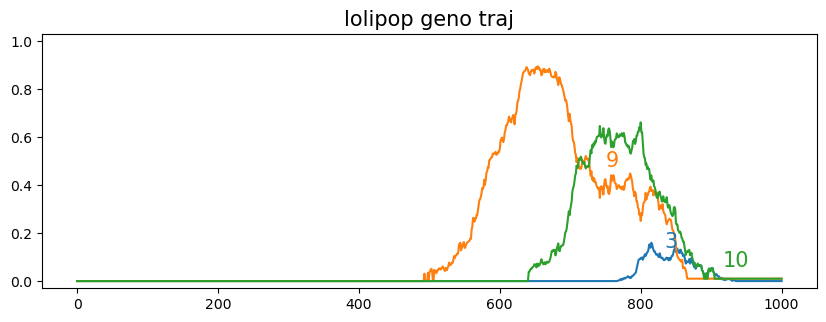

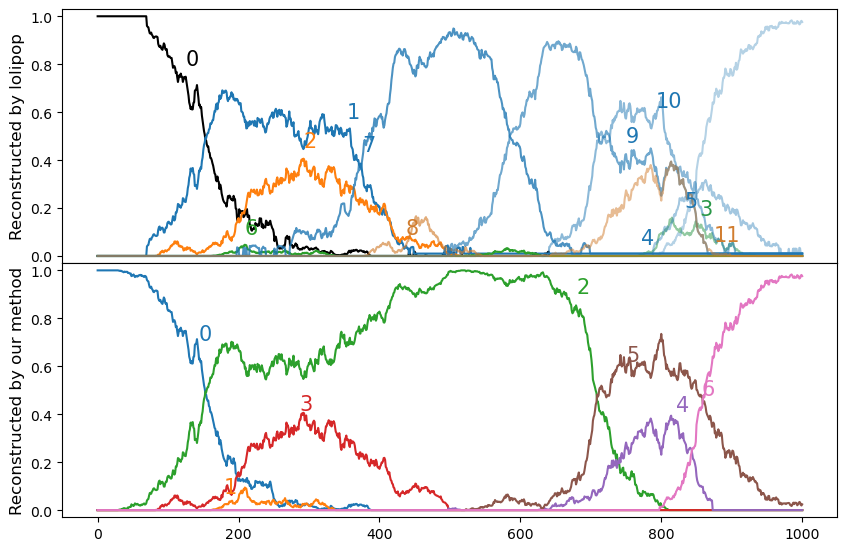

In [214]:
n, l_list = 0, [7, 10]
checkIndividualCase(n, l_list, compareWithUs=True)

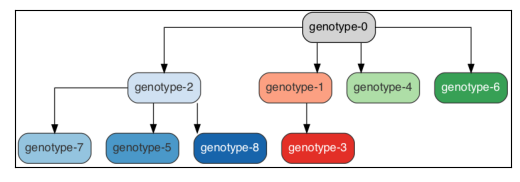

genotype 0:  []
genotype 1:  [0]
genotype 2:  [1, 3]
genotype 3:  [2]
genotype 4:  [4]
genotype 5:  [5]
genotype 6:  [6]
genotype 7:  [7]
genotype 8:  [8, 9]


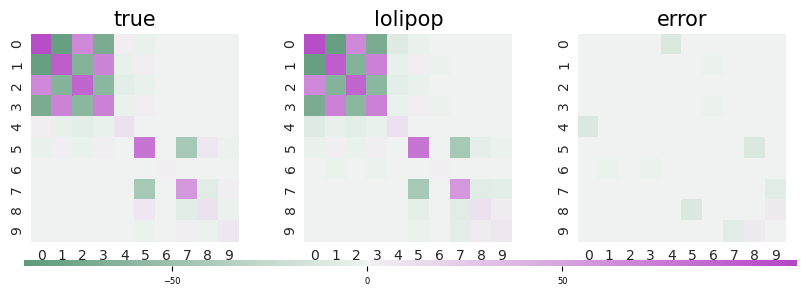

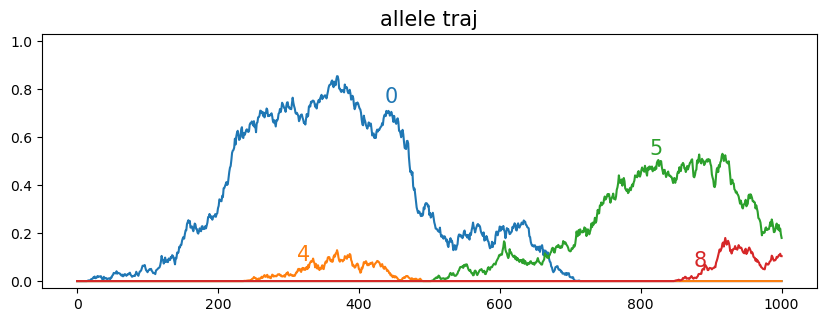

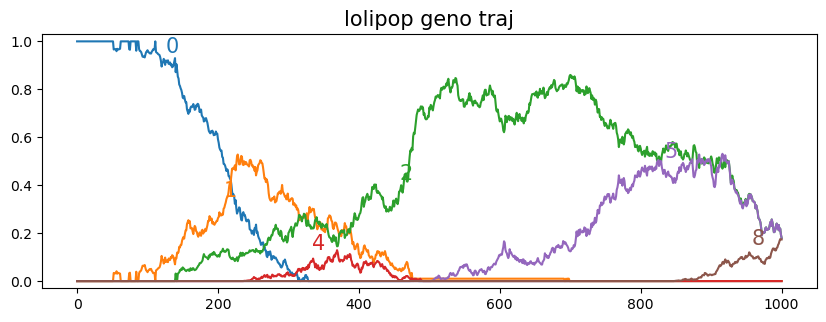

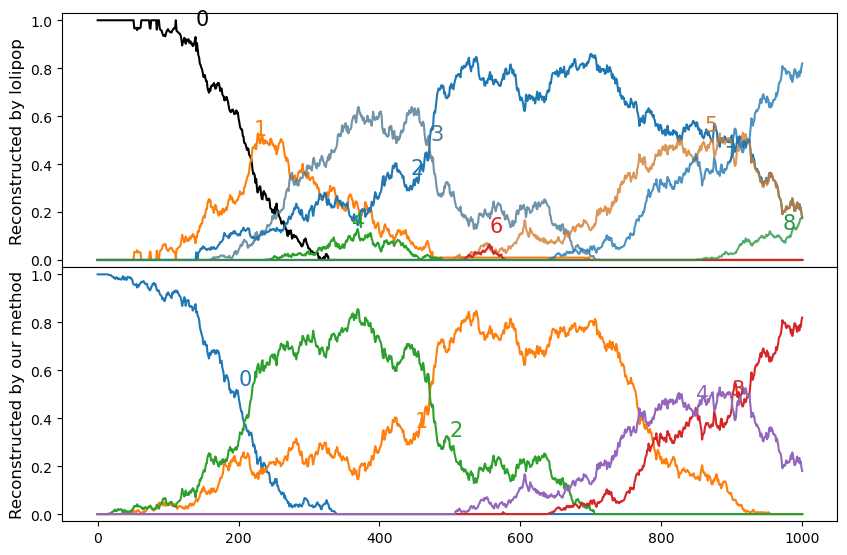

In [215]:
n, l_list = 6, [0, 4, 5, 8]
checkIndividualCase(n, l_list, compareWithUs=True)

In [259]:
n = 8
for l in [2, 5, 12]:
    print('%.3f, %.3f' % (intCov_all[n][l, 14], intCovError_all[n][l, 14]))

-27.915, -35.698
-27.824, -35.698
-27.621, -36.881


In [269]:
data = loadParsedOutput(8)

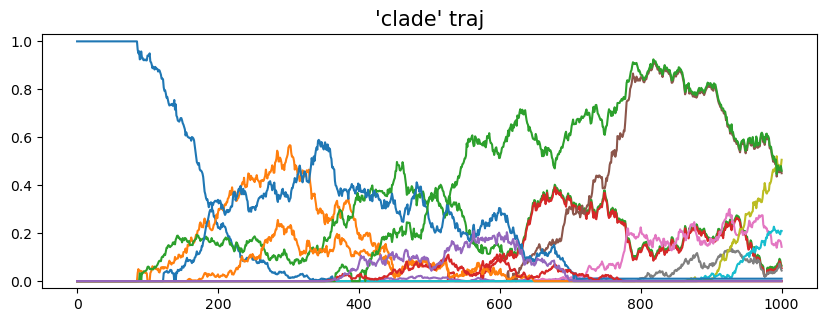

In [348]:
AP.plotTraj(data['cladeTraj'], title="'clade' traj")

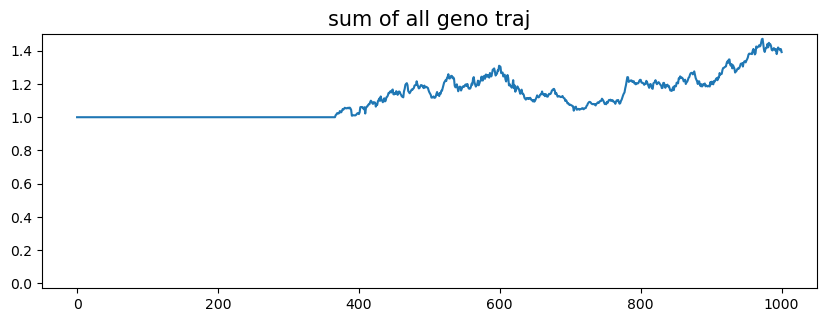

In [347]:
reload()
AP.plotTraj(np.sum(data['genoTraj'], axis=1)[:, None], ylim=(-0.03, 1.5), title='sum of all geno traj')
# AP.plotTraj(data['genoTraj'][:, [14]], ylim=(-0.03, 1.5), annot=True, labels=[14])

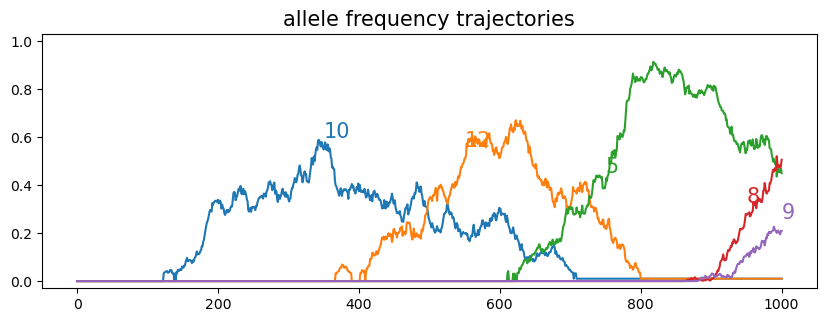

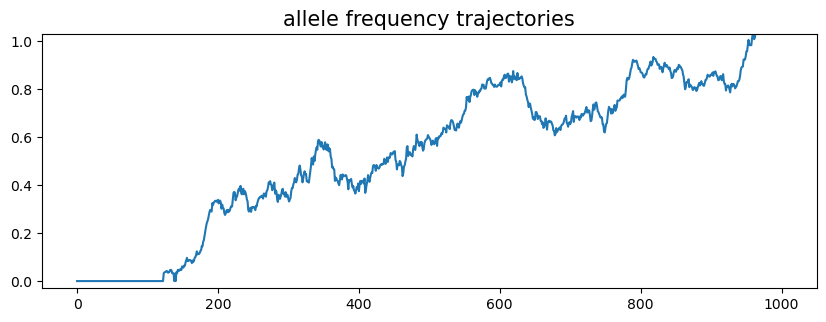

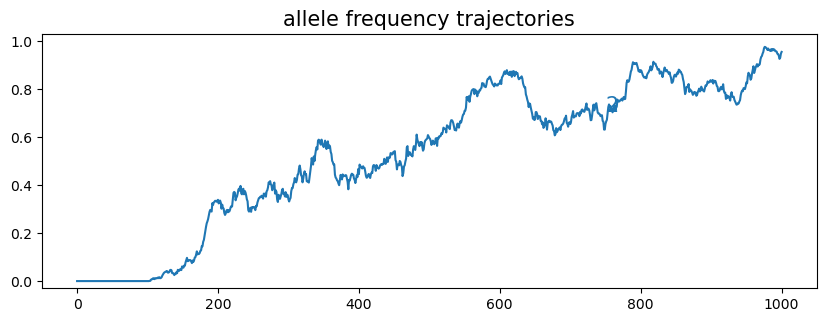

In [318]:
g_list = [10, 12, 5, 8, 9]
AP.plotTraj(data['genoTraj'][:, g_list], annot=True, labels=g_list)
AP.plotTraj(np.sum(data['genoTraj'][:, g_list], axis=1)[:, None])
AP.plotTraj(data['traj'][:, [2]], annot=True, labels=[2])

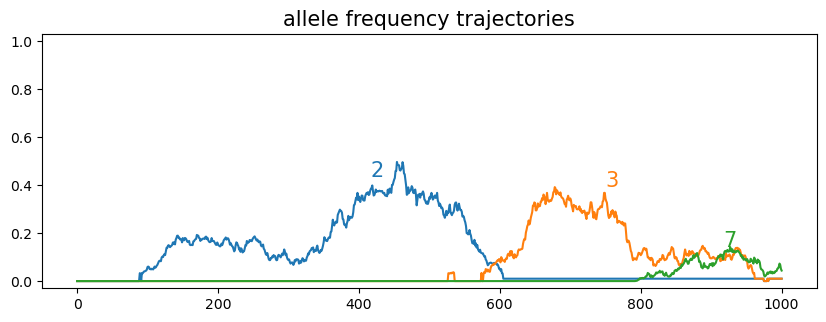

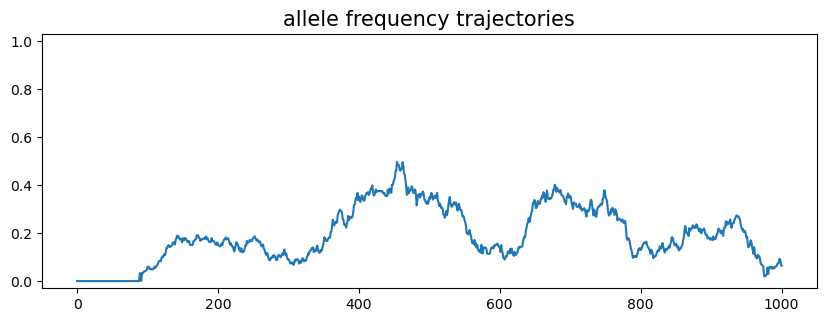

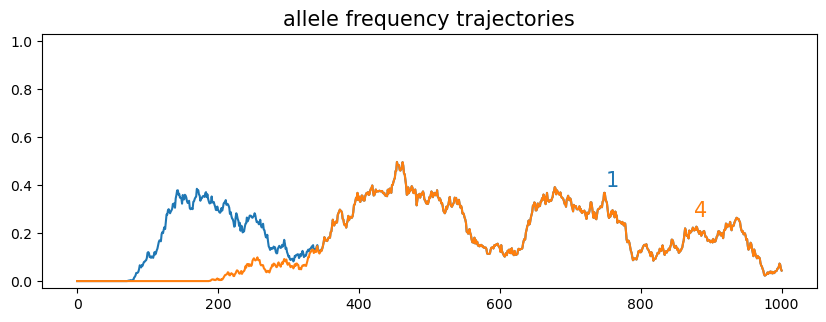

In [321]:
g_list = [2, 3, 7]
AP.plotTraj(data['genoTraj'][:, g_list], annot=True, labels=g_list)
AP.plotTraj(np.sum(data['genoTraj'][:, g_list], axis=1)[:, None])
AP.plotTraj(data['traj'][:, [1, 4]], annot=True, labels=[1, 4])

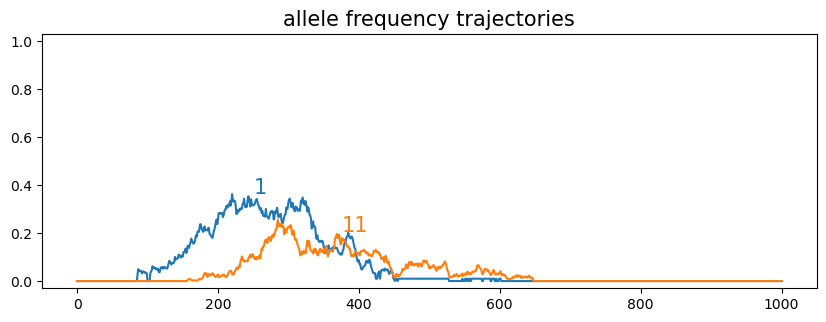

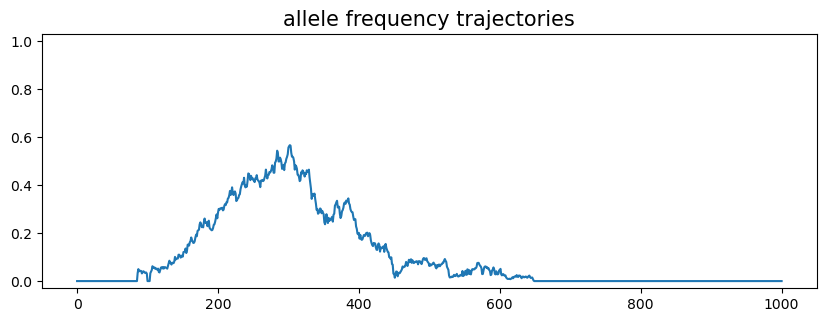

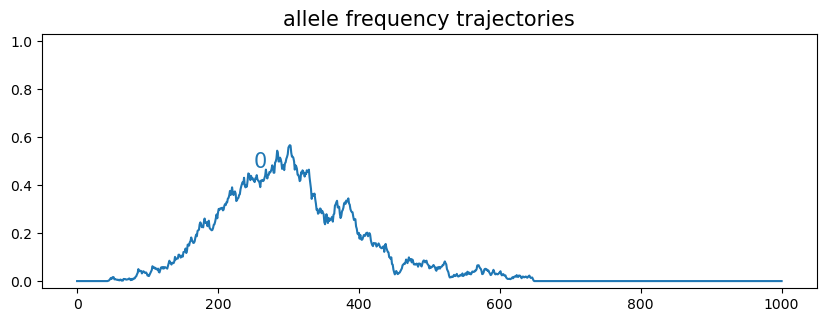

In [324]:
g_list = [1, 11]
AP.plotTraj(data['genoTraj'][:, g_list], annot=True, labels=g_list)
AP.plotTraj(np.sum(data['genoTraj'][:, g_list], axis=1)[:, None])
AP.plotTraj(data['traj'][:, [0]], annot=True, labels=[0])

In [303]:
print(data['genoTraj'][-1], np.sum(data['genoTraj'][-1]))

[0.    0.    0.01  0.01  0.    0.45  0.143 0.044 0.506 0.209 0.01  0.
 0.01  0.    0.   ] 1.3920000000000001


In [309]:
g_list = [2, 3, 10, 12, 6, 9]
print(data['genoTraj'][-1, g_list], np.sum(data['genoTraj'][-1, g_list]))
g_list = [_ for _ in range(len(data['genoTraj'][0])) if _ not in g_list]
print(data['genoTraj'][-1, g_list], np.sum(data['genoTraj'][-1, g_list]))

[0.01  0.01  0.01  0.01  0.143 0.209] 0.392
[0.    0.    0.    0.45  0.044 0.506 0.    0.    0.   ] 1.0


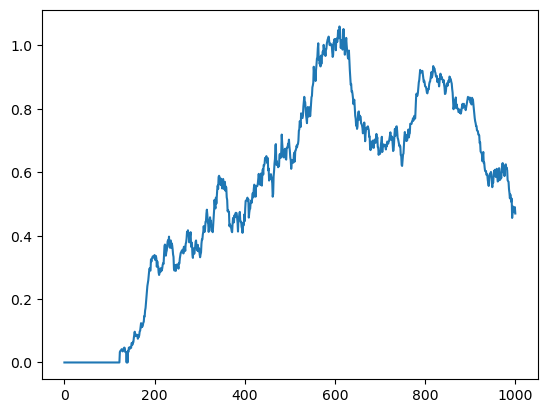

In [290]:
firstDescendants = [10, 12, 14]
sumTraj = np.sum(data['cladeTraj'][:, firstDescendants], axis=1)
plt.plot(range(len(sumTraj)), sumTraj)
plt.show()

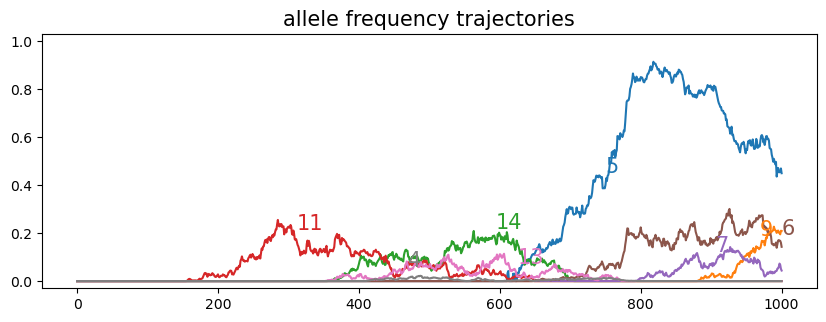

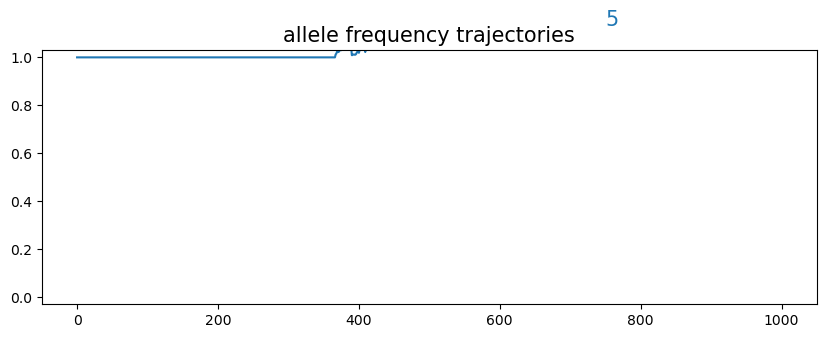

In [288]:
g_list = [5, 9, 14, 11, 7, 6, 13, 4]
AP.plotTraj(data['genoTraj'][:, g_list], annot=True, labels=g_list)
AP.plotTraj((np.sum(data['genoTraj'], axis=1) - data['genoTraj'][:, 9])[:, None], annot=True, labels=g_list)

In [282]:
print(np.sum(data['genoTraj'][:, [8, 9]], axis=1)[-5:])

[0.687 0.674 0.67  0.689 0.715]


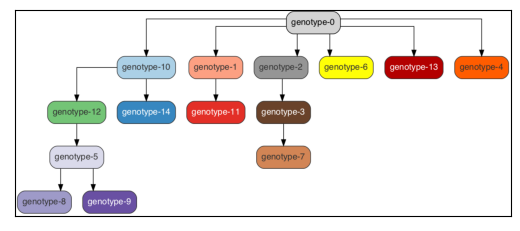

genotype 0:  []
genotype 1:  [0]
genotype 2:  [1, 4]
genotype 3:  [10]
genotype 4:  [11, 13, 8, 9]
genotype 5:  [12]
genotype 6:  [14]
genotype 7:  [15]
genotype 8:  [16]
genotype 9:  [17]
genotype 10:  [2]
genotype 11:  [3]
genotype 12:  [5]
genotype 13:  [6]
genotype 14:  [7]


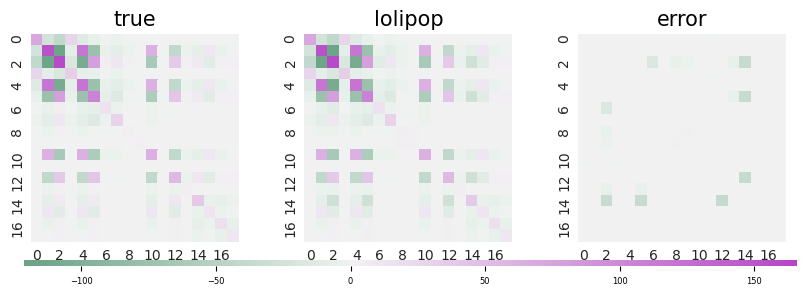

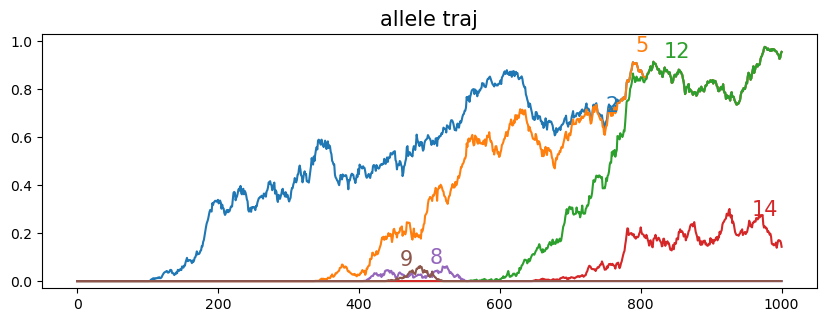

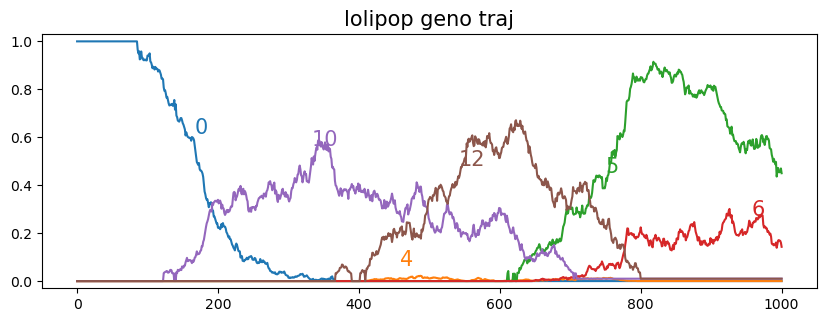

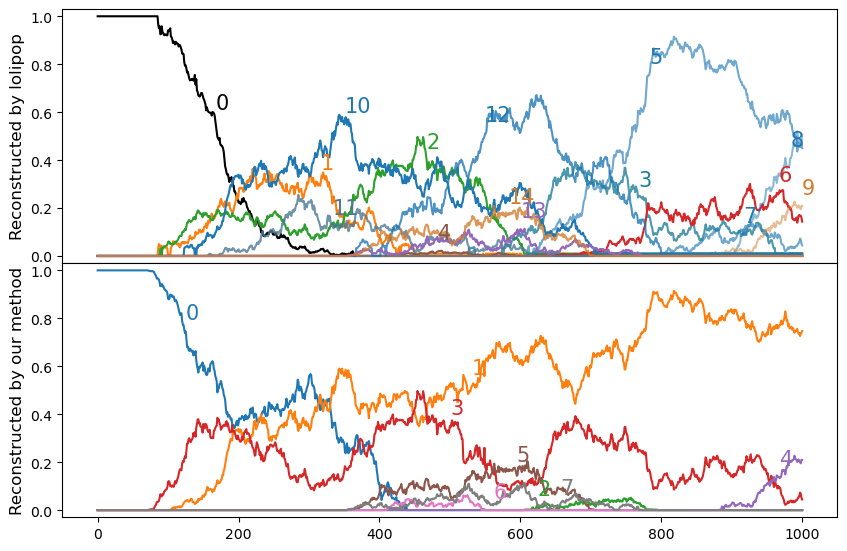

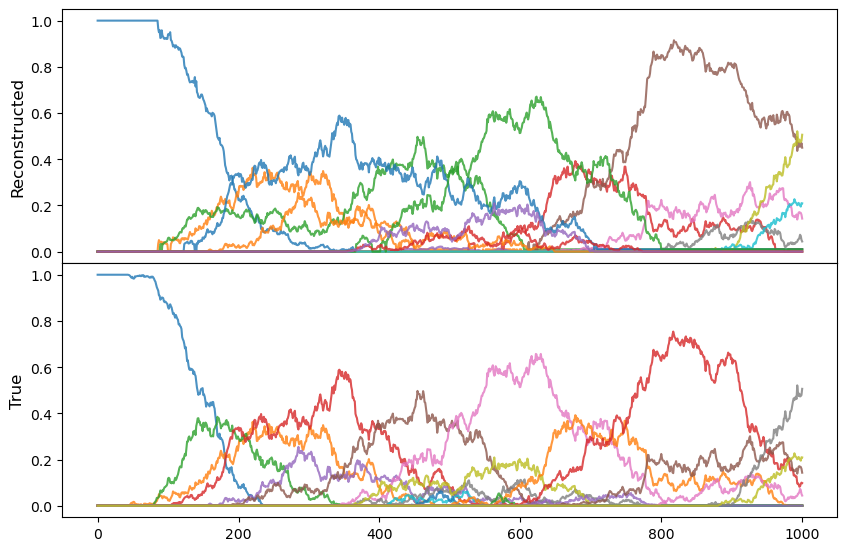

In [226]:
n, l_list = 8, [2, 5, 12, 14, 8, 9]
checkIndividualCase(n, l_list, compareWithUs=True)

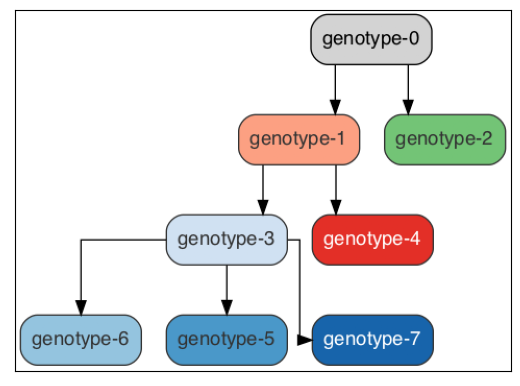

genotype 0:  []
genotype 1:  [0, 2]
genotype 2:  [1]
genotype 3:  [3]
genotype 4:  [4, 5]
genotype 5:  [6]
genotype 6:  [7]
genotype 7:  [8, 9]


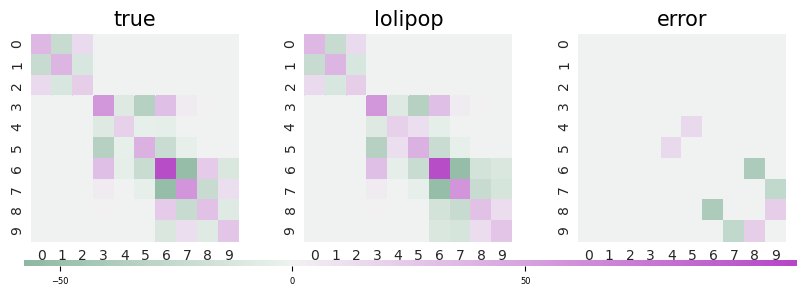

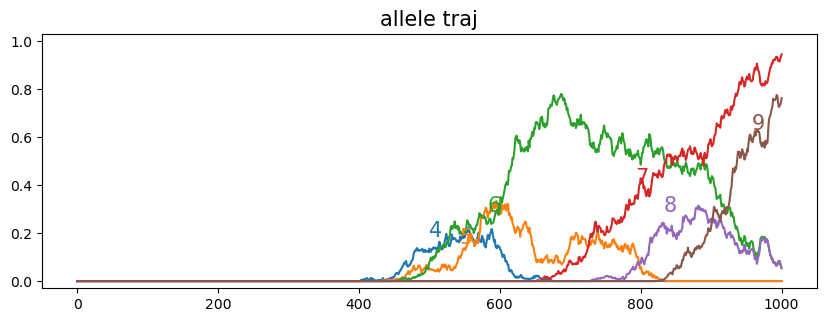

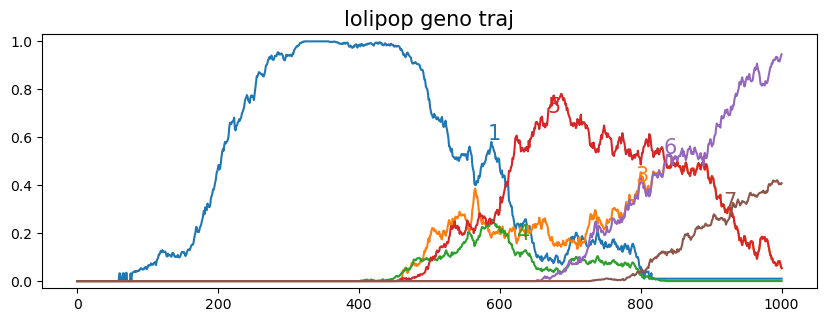

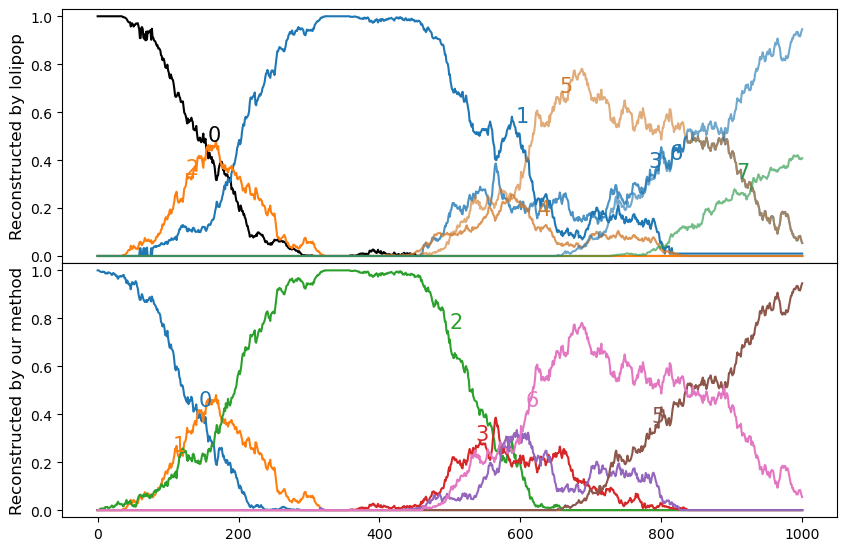

In [219]:
n, l_list = 11, [4, 5, 6, 7, 8, 9]
checkIndividualCase(n, l_list, compareWithUs=True)

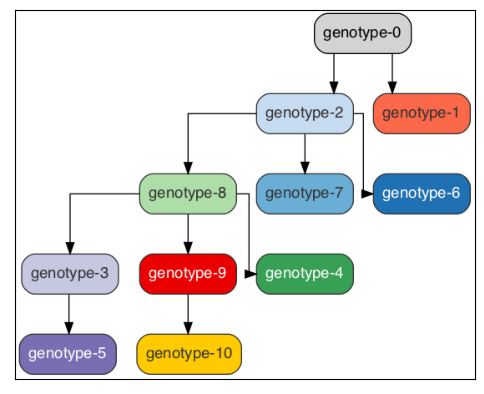

genotype 0:  []
genotype 1:  [0]
genotype 2:  [1, 2]
genotype 3:  [10, 7]
genotype 4:  [11]
genotype 5:  [12]
genotype 6:  [3, 6]
genotype 7:  [4]
genotype 8:  [5]
genotype 9:  [8]
genotype 10:  [9]


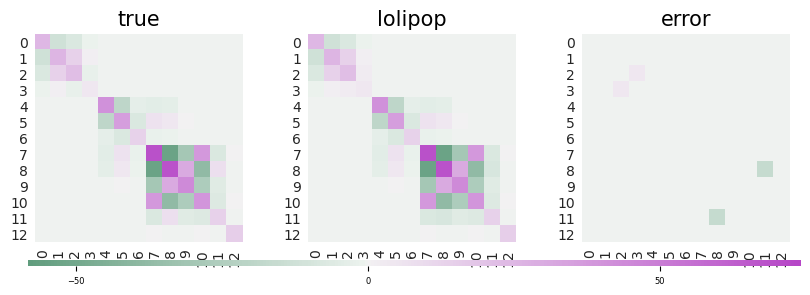

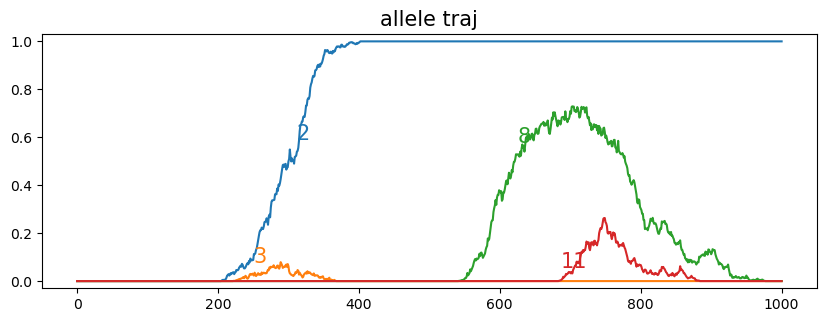

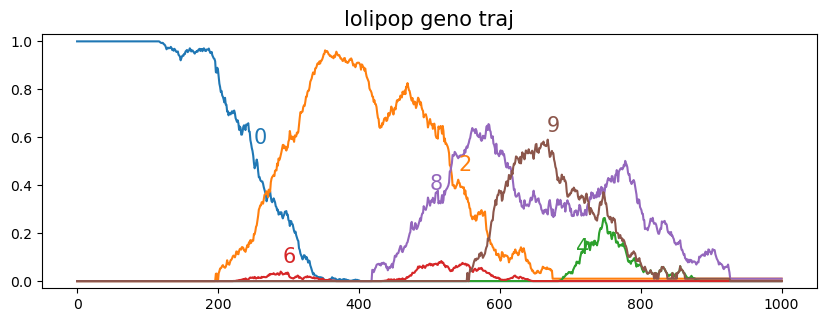

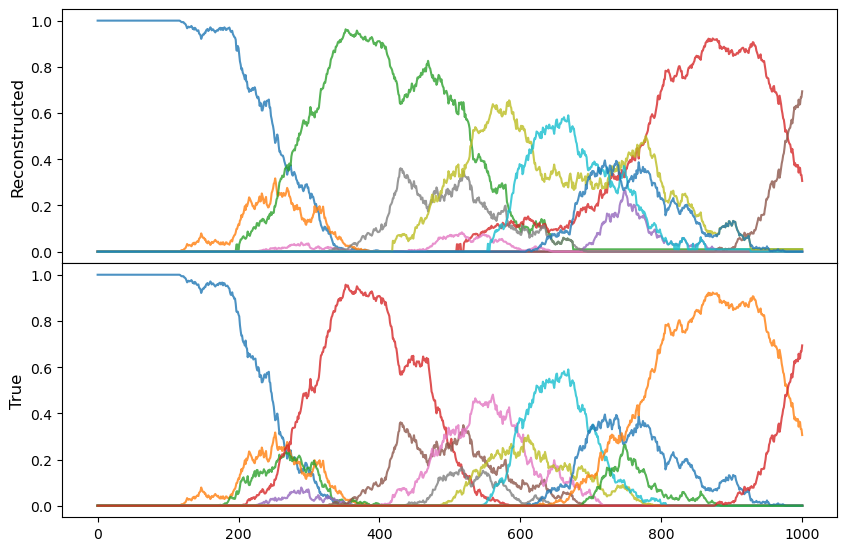

In [373]:
n, l_list = 32, [2, 3, 8, 11]
checkIndividualCase(n, l_list, compareWithUs=False)

# LTEE

## Took Lolipop 1.5 h to run 6 nonmutators

In [114]:
CLADES = ['AF', 'AP', 'major', 'minor', 'extinct', 'NA']
def getClade(Ls):
    if Ls == LH.ANCESTRAL_FIXED:
        return 'AF'
    elif Ls == LH.ANCESTRAL_POLYMORPHIC:
        return 'AP'
    elif Ls == LH.MAJOR_FIXED or Ls == LH.MAJOR_POLYMORPHIC:
        return 'major'
    elif Ls == LH.MINOR_FIXED or Ls == LH.MINOR_POLYMORPHIC:
        return 'minor'
    else:
        return 'extinct'
    return None


def getGenotypeToClade(genotypeToMembers, sites_intpl, site_to_clade):
    genotypeToClade = {}
    for g, members in enumerate(genotypeToMembers):
        clades = set()
        for l in members:
            site = sites_intpl[l]
            Ls = site_to_clade[site]
            clade = getClade(Ls)
            clades.add(clade)
        if len(clades) == 1:
            genotypeToClade[g] = clade
        else:
            genotypeToClade[g] = 'NA'
    return genotypeToClade


def getGenotypeToState(genotypeToMembers, sites_intpl, site_to_clade):
    genotypeToState = {}
    for g, members in enumerate(genotypeToMembers):
        clades = set()
        for l in members:
            site = sites_intpl[l]
            Ls = site_to_clade[site]
            clades.add(Ls)
        if len(clades) == 1:
            genotypeToState[g] = Ls
        else:
            genotypeToState[g] = 7
    return genotypeToState
            
            

def plotGenoTrajByClade(pop, genoTraj, genotypeToState, alpha=0.3, title=None, compareWithLTEE=True):
    
    colors = [LH.COLORS[genotypeToState[g]] for g in range(len(genoTraj[0]))]
    AP.plotTraj(genoTraj, colors=colors, alpha=alpha, title=title)
    if compareWithLTEE:
        LH.plotDataForOnePop(pop, plotFigure=True, plotShow=True, plotLegend=True, plotIntpl=True)
        
        
def checkEdges(genotypeToClade, parentToGenotype, clades=CLADES):
    numEdgesByClades = {clade: {} for clade in clades}
    for g, clade in genotypeToClade.items():
        childs = parentToGenotype[g]
        for child in childs:
            childClade = genotypeToClade[child]
            if childClade not in numEdgesByClades[clade]:
                numEdgesByClades[clade][childClade] = 1
            else:
                numEdgesByClades[clade][childClade] += 1
    return numEdgesByClades
        

def getMatrixForNumEdgesByClades(numEdgesByClades, clades=CLADES):
    cladeToIndex = {clade: clades.index(clade) for clade in clades}
    numEdgesMatrix = np.zeros((len(clades), len(clades)), dtype=int)
    
    for i, clade in enumerate(clades):
        for j, childClade in enumerate(clades):
            numEdgesMatrix[i, j] = numEdgesByClades[clade].get(childClade, 0)
    return numEdgesMatrix

    

In [175]:
def checkSum_LTEE(populations):
    for pop in populations:
        data = loadParsedOutput_LTEE(pop)
        genotypeToMembers = data['genotypeToMembers']
        parentToGenotype = data['parentToGenotype']
        traj = data['traj']
        mutsOfFirstDescendants = []
        for g in parentToGenotype[0]:
            mutsOfFirstDescendants += genotypeToMembers[g]
        sumFreq = np.sum(traj[:, mutsOfFirstDescendants], axis=1)[:, None]
        firstTraj = np.hstack((sumFreq, traj[:, mutsOfFirstDescendants]))
        if not np.all(sumFreq <= 1.01):
            AP.plotTraj(firstTraj, annot=True, annotTexts=['sum'] + mutsOfFirstDescendants, title=f'n={n}', ylim=(-0.03, 1.5))
    

In [225]:
def checkSum_LTEE_2(populations):
    for pop in populations:
        data = loadParsedOutput_LTEE(pop)
        genoTraj = data['genoTraj']
        genotypeToMembers = data['genotypeToMembers']
        parentToGenotype = data['parentToGenotype']
        sumFreq = np.sum(genoTraj[:, parentToGenotype[0]], axis=1)[:, None]
        firstTraj = np.hstack((sumFreq, genoTraj[:, parentToGenotype[0]]))
        if not np.all(sumFreq <= 1.01):
            AP.plotTraj(firstTraj, annot=True, annotTexts=['sum'] + parentToGenotype[0], title=f'n={n}', ylim=(-0.03, 1.5))
    

In [232]:
def checkSum_LTEE_3(populations, tolerance=0.1):
    for pop in populations:
        data = loadParsedOutput_LTEE(pop)
        genoTraj = data['genoTraj']
        genotypeToMembers = data['genotypeToMembers']
        parentToGenotype = data['parentToGenotype']
        total_count = 0
        count_not_match = 0
        for parent, desendants in parentToGenotype.items():
            total_count += 1
            sumFreq = np.sum(genoTraj[:, desendants], axis=1)
            if not np.all(sumFreq <= genoTraj[:, parent] + tolerance):
                count_not_match += 1
                print('Largest discrepancy: ', np.max(sumFreq - genoTraj[:, parent]))
        print(f'Not matching: {count_not_match} / {total_count}')
        

In [19]:
%%time
reload()
genoTraj_LTEE = {}
for pop in LH.populations_nonmutator:
    df = loadOutputGenoTraj_LTEE(pop)
    genoTraj_LTEE[pop] = parseGenotypeTrajectories(df)
    
# graph_all, colors_all, alphas_all = {}, {}, {}
# for pop in LH.populations_nonmutator:
#     df = pd.read_csv(LOLIPOP_OUTPUT_DIR + f'/{pop}/tables/LTEE_interpolated_pop={pop}.edges.tsv', sep='\t')
#     graph = lolipop_helper.parseEdges(df)
#     colors, alphas = lolipop_helper.assignColorsToGenotypes(graph)
#     graph_all[pop], colors_all[pop], alphas_all[pop] = graph, colors, alphas
    

CPU times: user 8.78 s, sys: 41.2 ms, total: 8.83 s
Wall time: 8.87 s


In [38]:
data_LTEE = {}
genoTraj_LTEE = {}
for pop in LH.populations_nonmutator:
    output = loadParsedOutput_LTEE(pop)
    genoTraj = output['genoTraj']
    
    data_LTEE[pop] = output
    genoTraj_LTEE[pop] = genoTraj

### Test functions

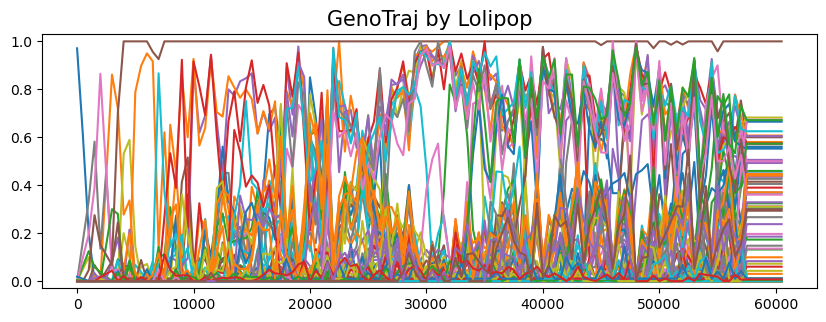

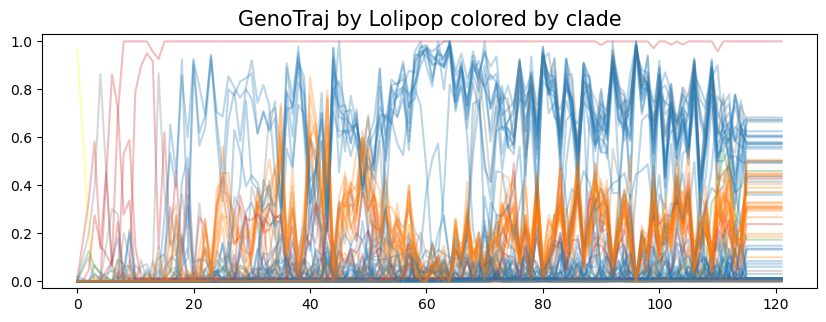

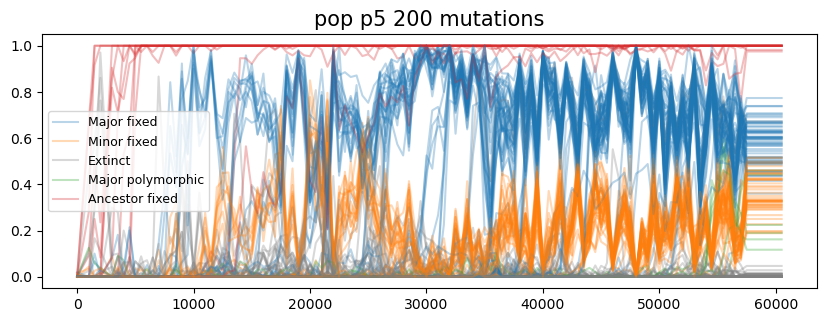

In [86]:
reload()
AP.plotTraj(data_LTEE[pop]['genoTraj'], times=LH.TIMES_INTPL, title='GenoTraj by Lolipop')
genotypeToState = getGenotypeToState(data_LTEE[pop]['genotypeToMembers'], LH.data[pop]['sites_intpl'], LH.data[pop]['site_to_clade'])
plotGenoTrajByClade(pop, data_LTEE[pop]['genoTraj'], genotypeToState, title='GenoTraj by Lolipop colored by clade')


In [100]:
pop = 'm6'
genotypeToClade = getGenotypeToClade(data_LTEE[pop]['genotypeToMembers'], LH.data[pop]['sites_intpl'], LH.data[pop]['site_to_clade'])
numEdgesByClades = checkEdges(genotypeToClade, data_LTEE[pop]['parentToGenotype'])
numEdgesMatrix = getMatrixForNumEdgesByClades(numEdgesByClades)


In [96]:
numEdgesByClades

{'AF': {'major': 8, 'AF': 13, 'minor': 28, 'extinct': 14},
 'AP': {},
 'major': {'major': 32, 'minor': 1, 'extinct': 7},
 'minor': {'AF': 1, 'extinct': 9, 'minor': 1, 'NA': 1},
 'extinct': {'extinct': 3},
 'NA': {'minor': 1, 'AF': 1}}

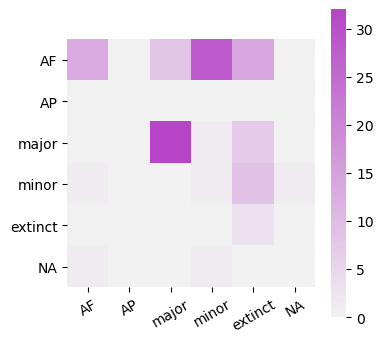

In [111]:
reload()
AP.plotMatrix(numEdgesMatrix, cbar=True, xticklabels=CLADES, yticklabels=CLADES, title=f'pop {pop}')

# Compare genoTraj with cladeTraj

--------------------pop=p2--------------------


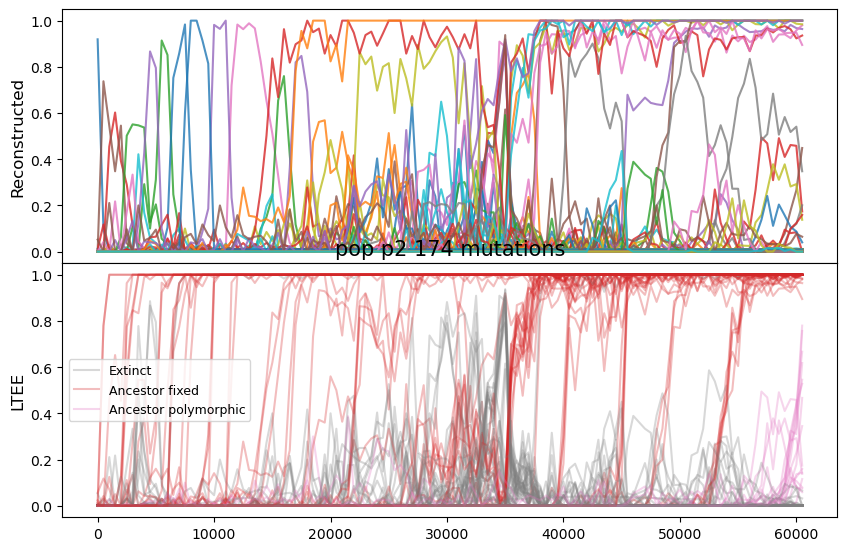

--------------------pop=m6--------------------


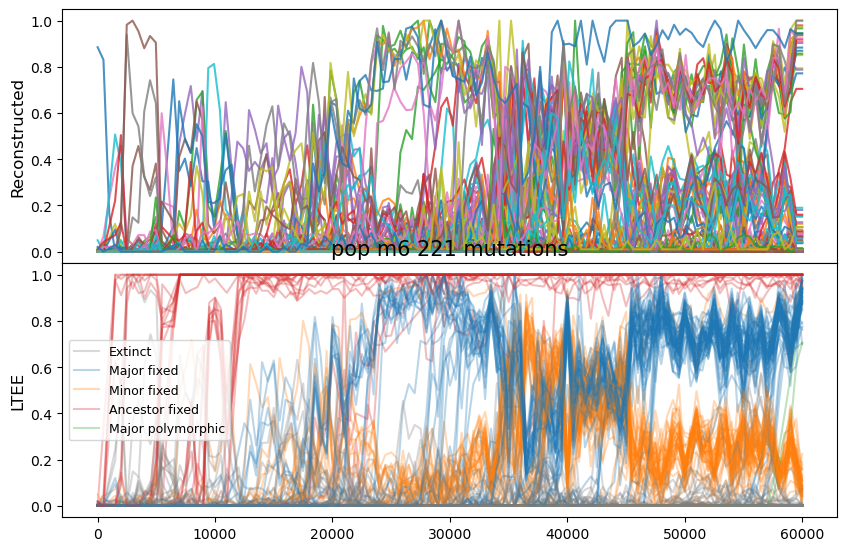

--------------------pop=m5--------------------


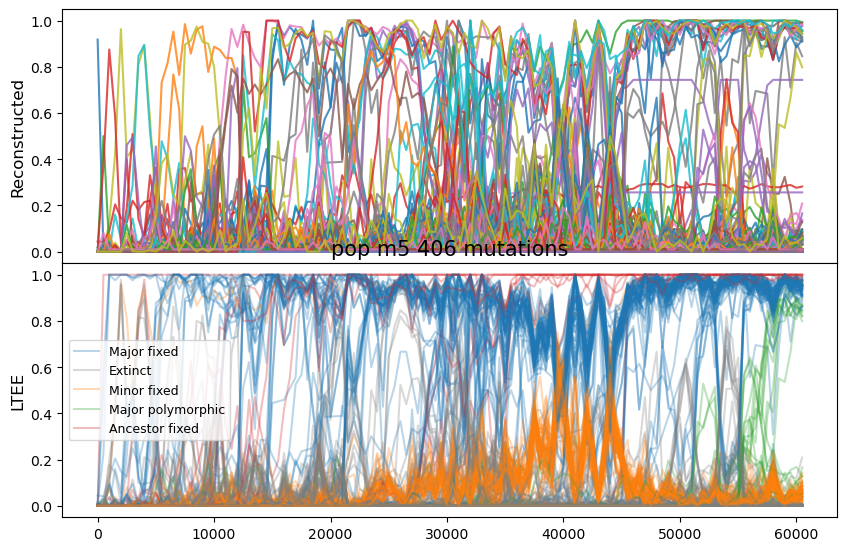

--------------------pop=p1--------------------


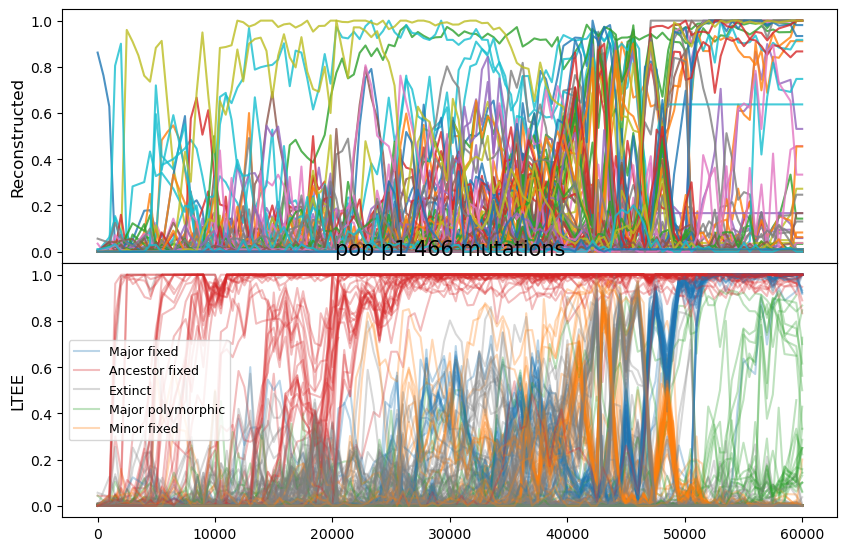

--------------------pop=p4--------------------


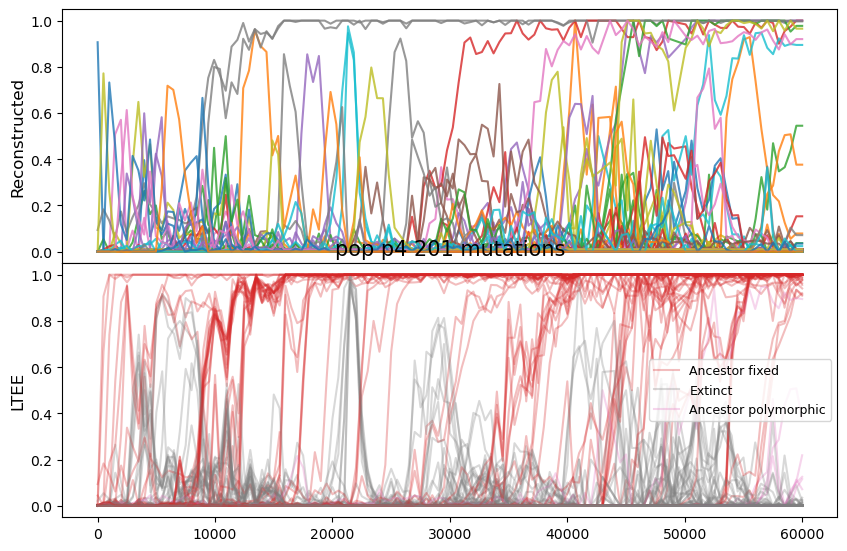

--------------------pop=p5--------------------


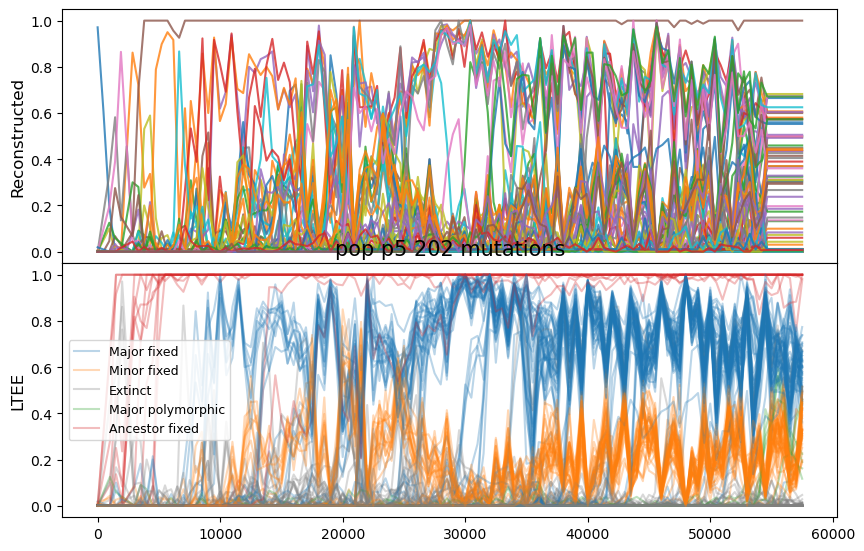

In [107]:
for pop in LH.populations_nonmutator:
    print('-' * 20 + f'pop={pop}' + '-' * 20)
    compareWithTrueGenoTraj_LTEE(genoTraj_LTEE[pop], pop)

## It is not clear how to obtain clades from all the genotypes inferred by Lolipop. 
## However we can check to what extent does it match Lenski's inference. 

# Check if genotype definitions agree with clade
## Does a genotype contain mutations from both major and minor clade?

--------------------pop=p2--------------------


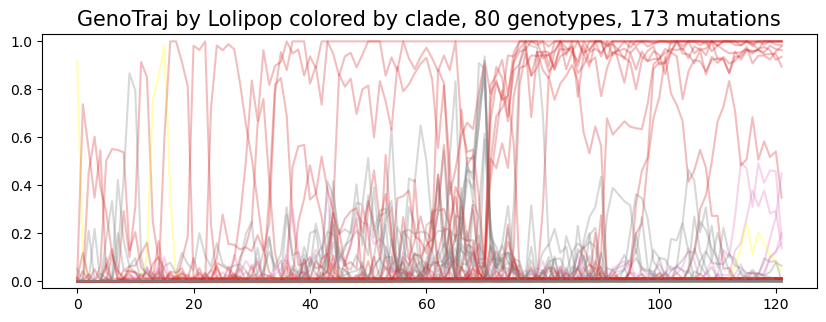

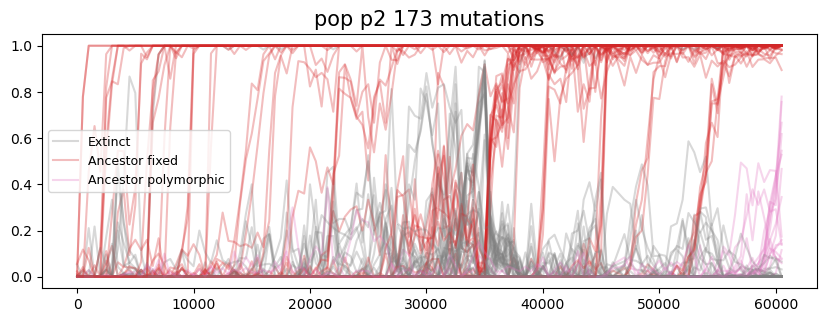

--------------------pop=m6--------------------


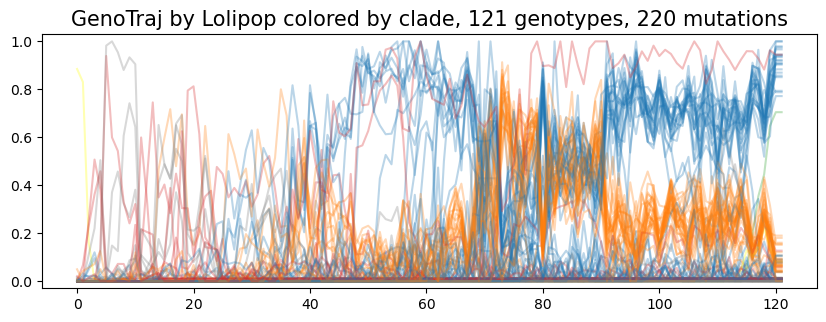

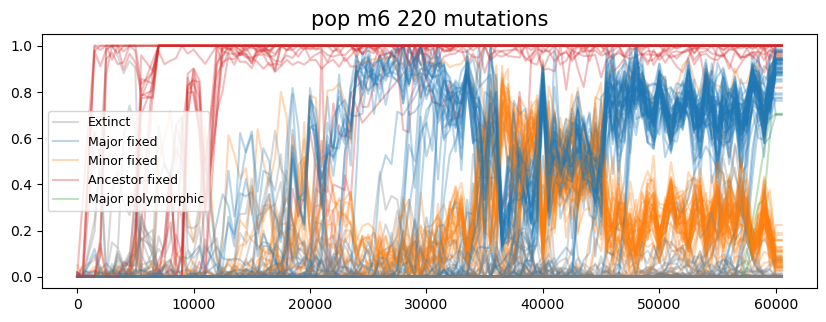

--------------------pop=m5--------------------


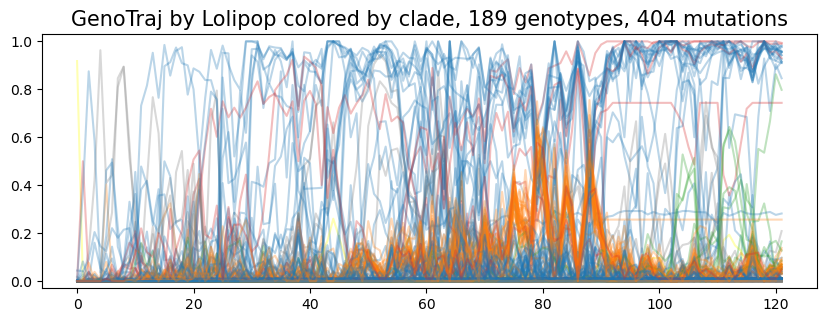

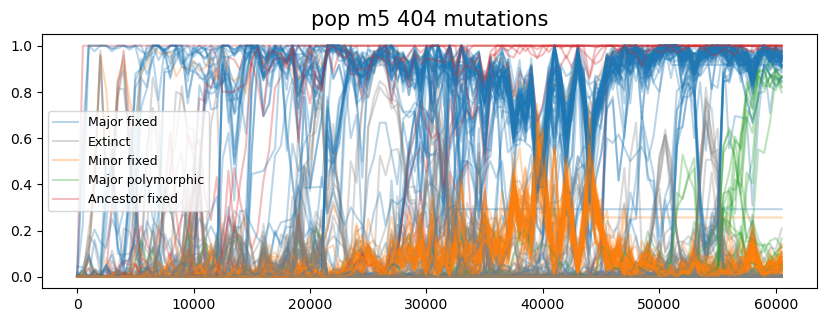

--------------------pop=p1--------------------


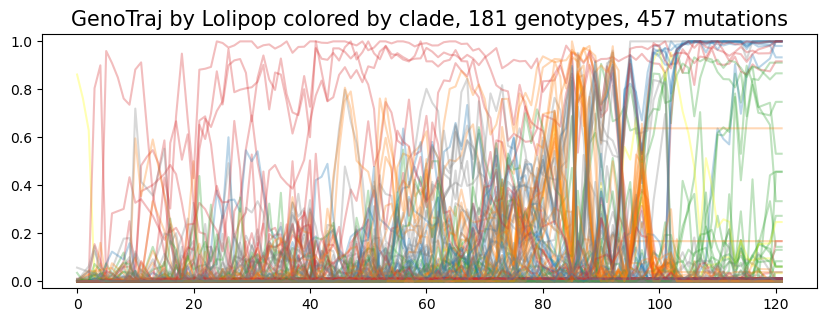

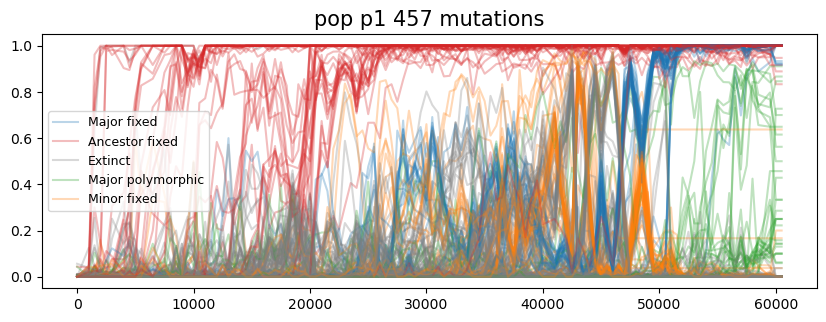

--------------------pop=p4--------------------


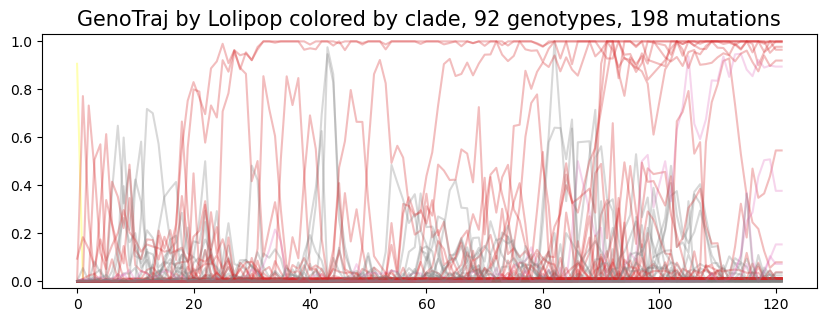

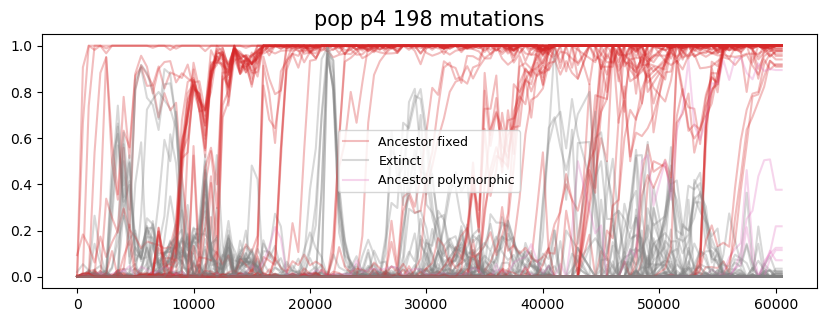

--------------------pop=p5--------------------


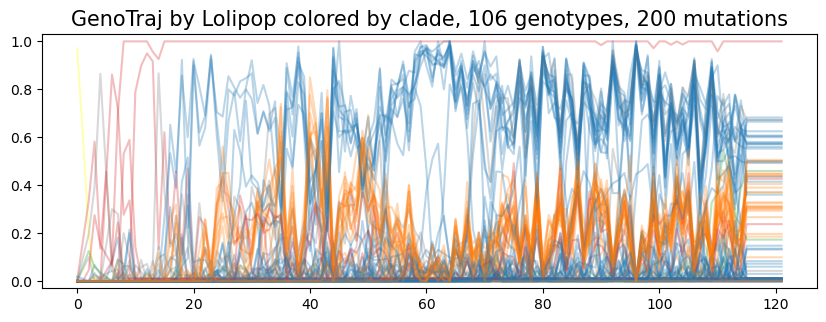

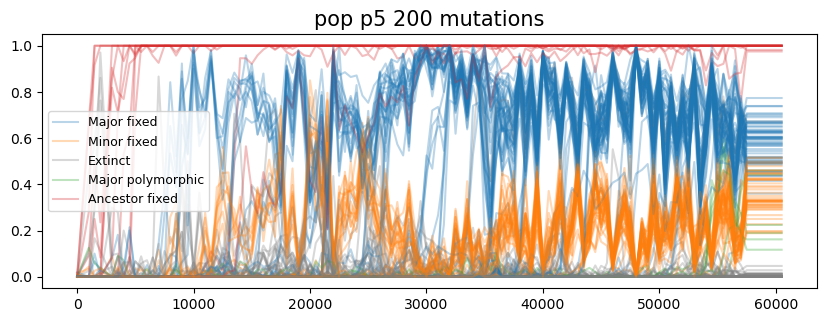

In [87]:
reload()
for pop in LH.populations_nonmutator:
    print('-' * 20 + f'pop={pop}' + '-' * 20)
    numGeno = len(data_LTEE[pop]['genoTraj'][0])
    numMuts = len(data_LTEE[pop]['memberToGenotype'])
    genotypeToState = getGenotypeToState(data_LTEE[pop]['genotypeToMembers'], LH.data[pop]['sites_intpl'], LH.data[pop]['site_to_clade'])
    plotGenoTrajByClade(pop, data_LTEE[pop]['genoTraj'], genotypeToState, title=f'GenoTraj by Lolipop colored by clade, {numGeno} genotypes, {numMuts} mutations')
    

# Check if edges are mostly from Ancestoral clade to major/minor clade, and within one clade

--------------------pop=p2--------------------


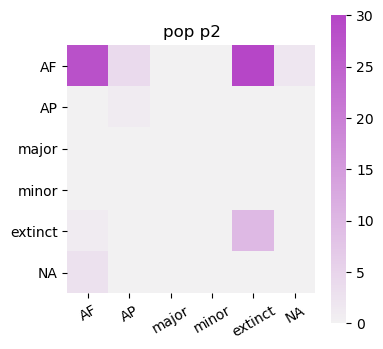

--------------------pop=m6--------------------


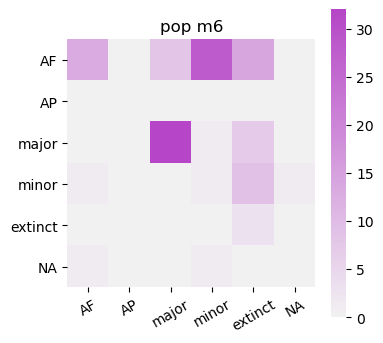

--------------------pop=m5--------------------


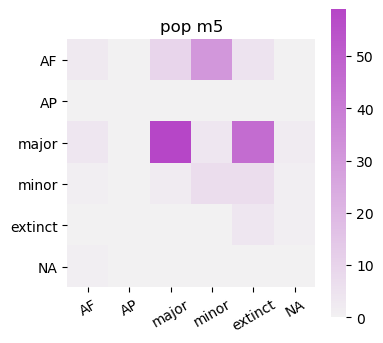

--------------------pop=p1--------------------


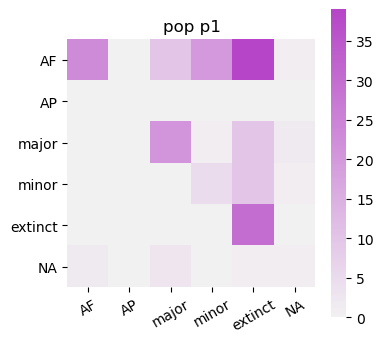

--------------------pop=p4--------------------


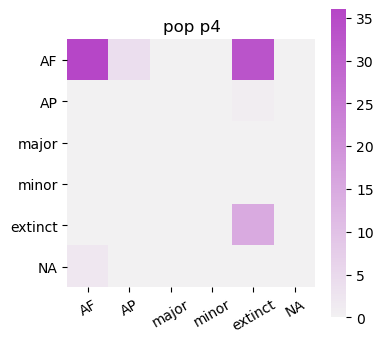

--------------------pop=p5--------------------


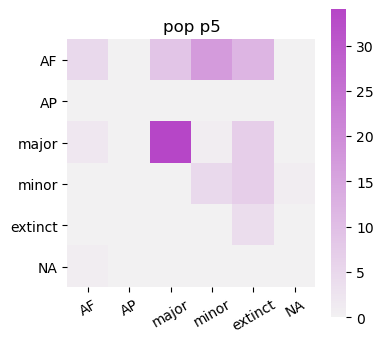

In [115]:
reload()
for pop in LH.populations_nonmutator:
    print('-' * 20 + f'pop={pop}' + '-' * 20)
    genotypeToClade = getGenotypeToClade(data_LTEE[pop]['genotypeToMembers'], LH.data[pop]['sites_intpl'], LH.data[pop]['site_to_clade'])
    numEdgesByClades = checkEdges(genotypeToClade, data_LTEE[pop]['parentToGenotype'])
    numEdgesMatrix = getMatrixForNumEdgesByClades(numEdgesByClades)
    AP.plotMatrix(numEdgesMatrix, cbar=True, xticklabels=CLADES, yticklabels=CLADES, title=f'pop {pop}')
    
    

In [375]:
# reload()
# for pop in LH.populations_nonmutator:
#     directory = f'{LOLIPOP_OUTPUT_DIR}/{pop}'
#     filename = f'LTEE_interpolated_pop={pop}'
#     saveFile = f'{LOLIPOP_PARSED_OUTPUT_DIR}/{filename}'
#     lolipop_helper.parseOutput(directory, filename, saveFile=saveFile)

/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


n=32	n=32	n=32	n=32	n=32	n=32	

# Check sum of freqs of first desendants inferred by Lolipop

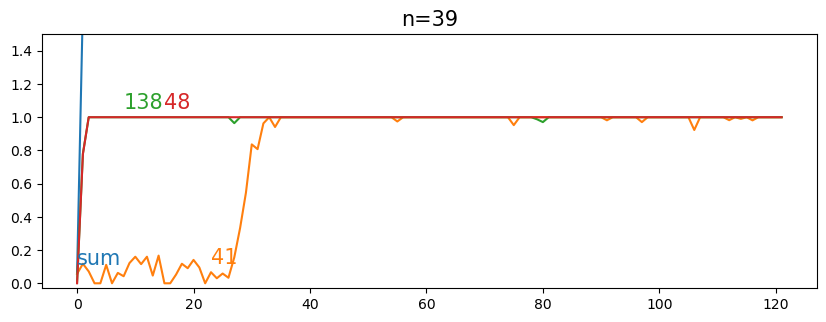

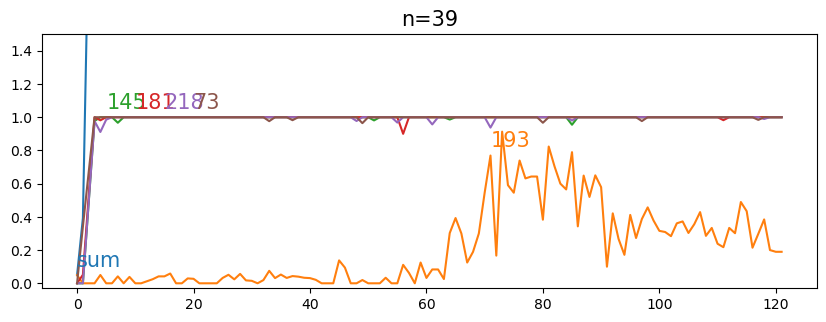

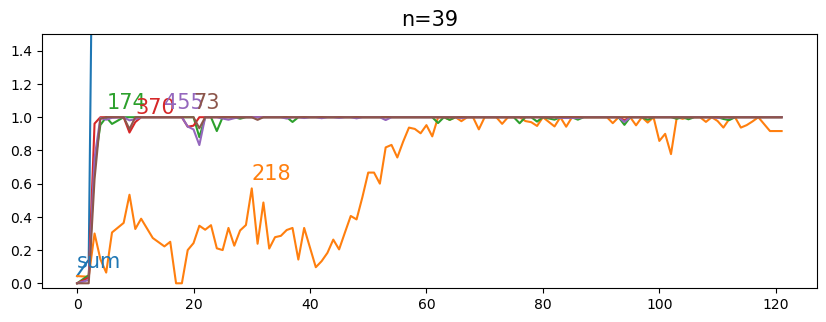

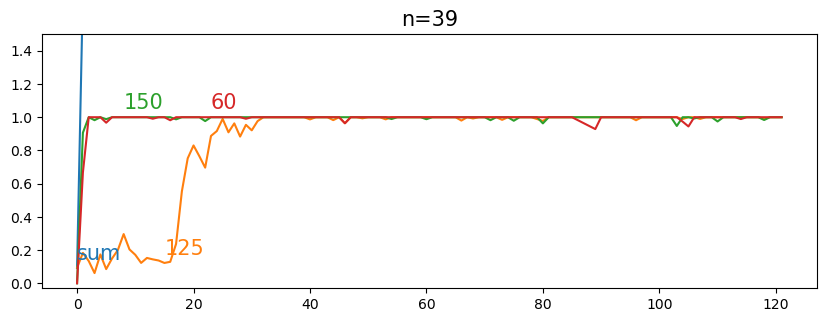

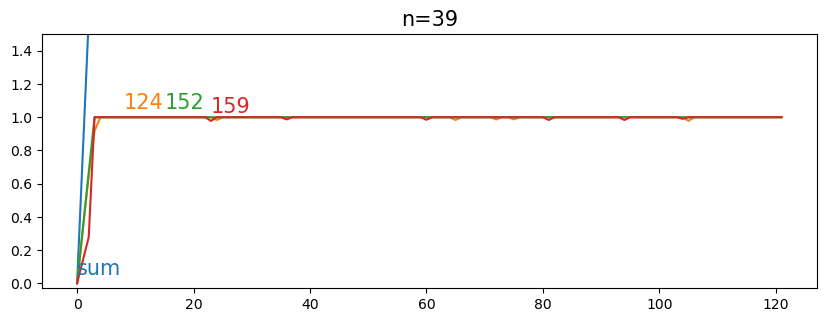

In [176]:
checkSum_LTEE(LH.populations_nonmutator)

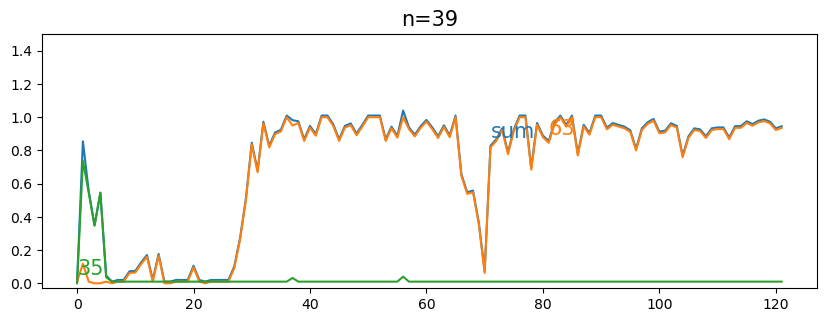

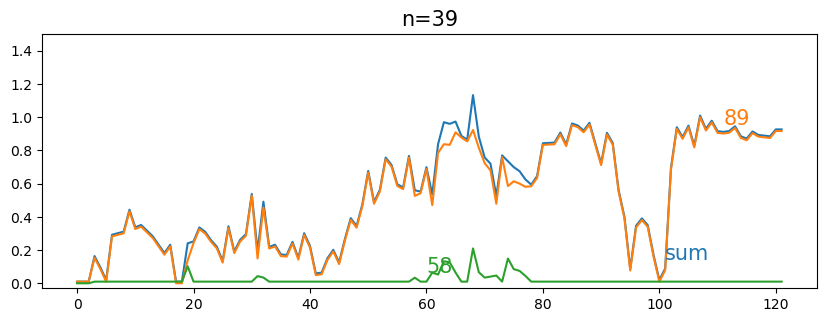

In [226]:
checkSum_LTEE_2(LH.populations_nonmutator)

In [233]:
checkSum_LTEE_3(LH.populations_nonmutator)

Largest discrepancy:  1.04
Largest discrepancy:  0.875
Largest discrepancy:  1.0
Largest discrepancy:  1.0
Largest discrepancy:  1.0454545454545454
Largest discrepancy:  2.0121951219512195
Largest discrepancy:  0.99
Largest discrepancy:  0.99
Largest discrepancy:  1.0
Largest discrepancy:  0.6524002704530085
Largest discrepancy:  0.8372222222222223
Largest discrepancy:  0.6964892623716153
Largest discrepancy:  1.0966989829557554
Largest discrepancy:  0.37837837837837845
Largest discrepancy:  1.3605143117188399
Largest discrepancy:  3.79566246962491
Largest discrepancy:  1.123333333333333
Largest discrepancy:  0.21288359788359795
Largest discrepancy:  0.3416081871345029
Largest discrepancy:  0.7630158730158729
Largest discrepancy:  0.99
Largest discrepancy:  1.0112522336520815
Largest discrepancy:  0.14589665356255743
Largest discrepancy:  1.8534562211981565
Largest discrepancy:  0.8181414745553387
Largest discrepancy:  0.8448311774852391
Largest discrepancy:  0.31449235155118016
Larges

# Infer selection and fitness
### Because genotype frequencies do not sum to 1, we can not use sequences information to infer. 
### Rather we compute covariance based on the phylogeny relationship between the genotypes that they belong. 

In [133]:
def inferForLTEE(populations, data_LTEE, muForInference=1e-10, regularization=1):
    intCov_all, selection_all, fitness_all, intCovError_all = {}, {}, {}, {}
    for pop in populations:
        intCov, selection, fitness = lolipop_helper.inferencePipeline(data_LTEE[pop], mu=muForInference, regularization=regularization)
        
        intCov_all[pop] = intCov
        selection_all[pop] = selection
        fitness_all[pop] = fitness
    return intCov_all, selection_all, fitness_all
        
    

In [178]:
%%time
reload()
intCov_LTEE, selection_LTEE, fitness_LTEE = inferForLTEE(LH.populations_nonmutator, data_LTEE)

CPU times: user 5min 10s, sys: 1.72 s, total: 5min 12s
Wall time: 5min 13s


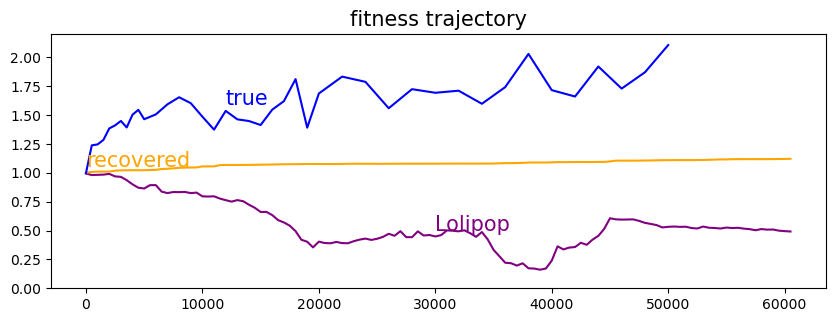

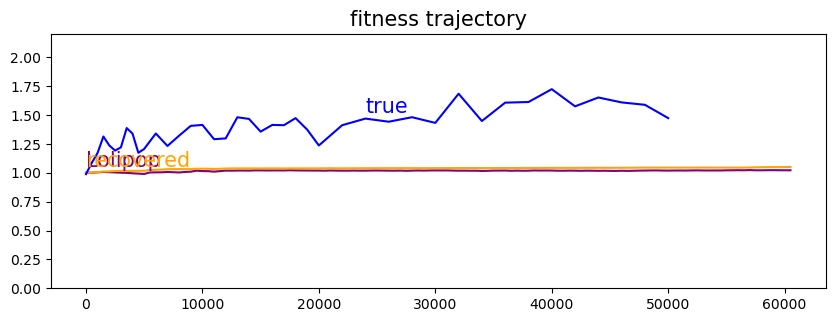

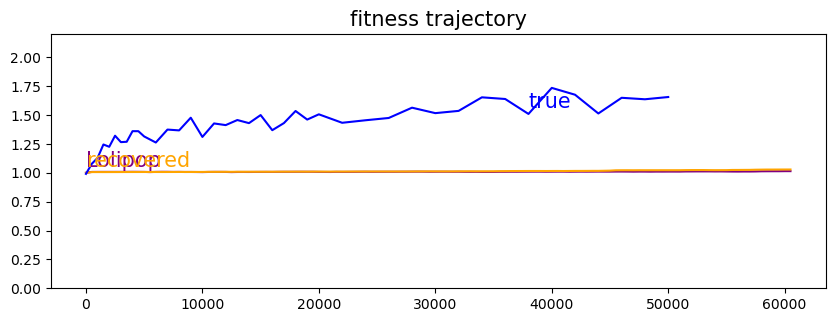

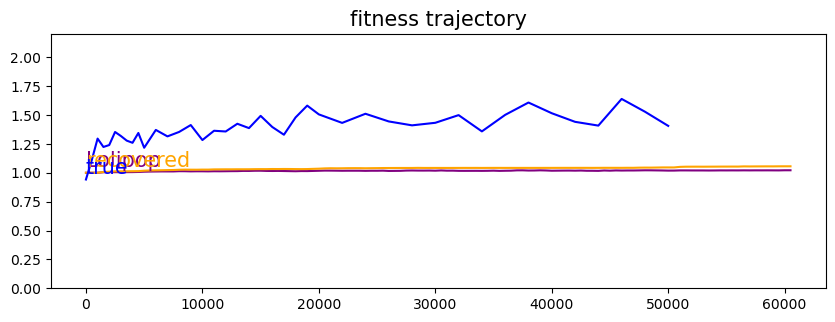

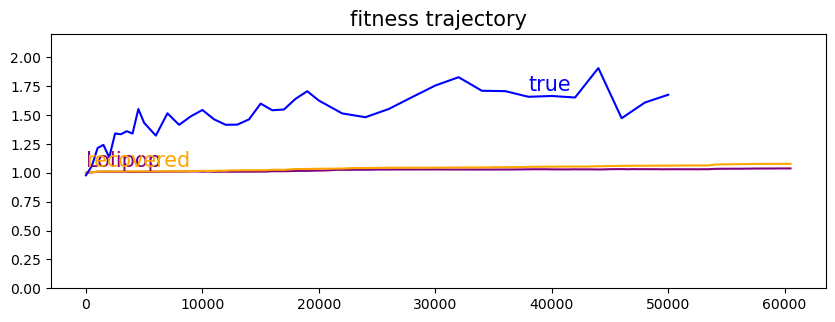

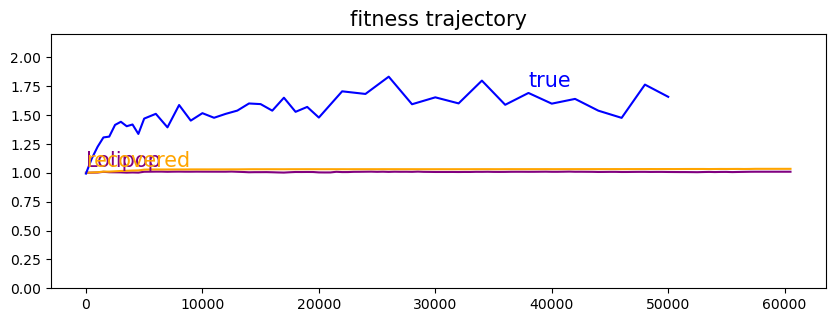

In [212]:
for pop in LH.populations_nonmutator:
    AP.plotTraj(fitness_LTEE[pop][:, None], times=LH.TIMES_INTPL, colors=['purple'], annot=True, annotTexts=['Lolipop'], ylim=(0, 2.2), plotShow=False)
    AP.plotTraj(summaries_LTEE[pop]['recovered'][2][:, None], times=LH.TIMES_INTPL, colors=['orange'], annot=True, annotTexts=['recovered'], ylim=(0, 2.2), plotFigure=False, plotShow=False)
    AP.plotTraj(LH.fitness_ws[pop][:, None], times=LH.fitness_ts[pop], colors=['blue'], annot=True, annotTexts=['true'], title='fitness trajectory', ylim=(0, 2.2), plotFigure=False)
    

In [193]:
%%time
reload()
intCov_LTEE_reg10, selection_LTEE_reg10, fitness_LTEE_reg10 = inferForLTEE(LH.populations_nonmutator, data_LTEE, regularization=10)

CPU times: user 4min 55s, sys: 802 ms, total: 4min 56s
Wall time: 4min 54s


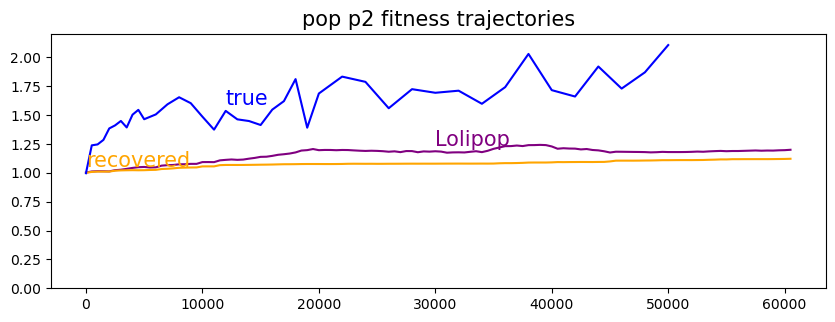

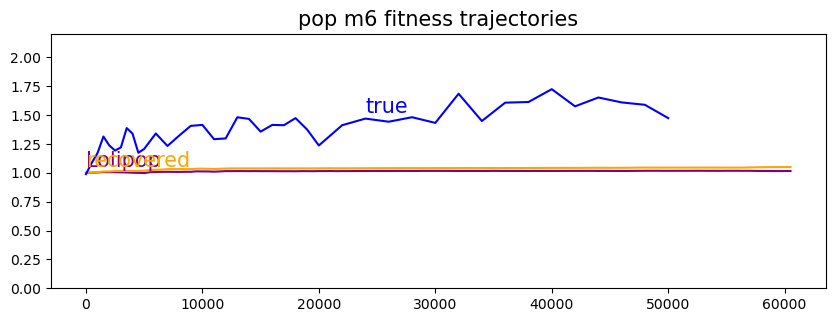

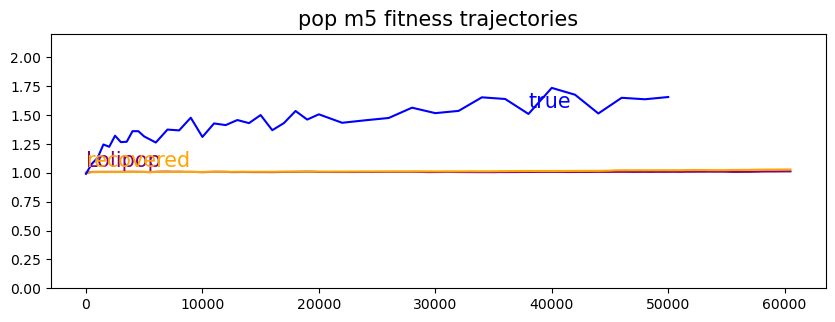

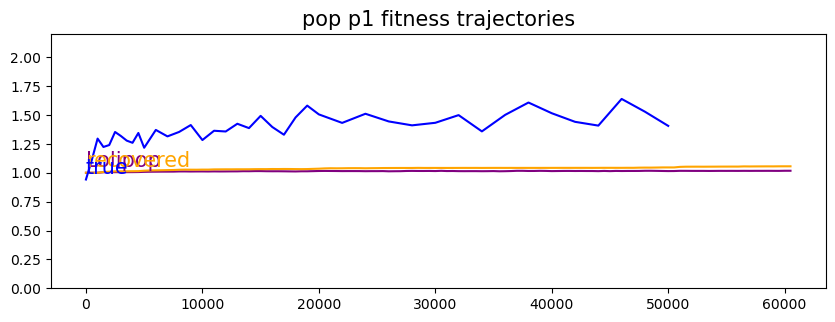

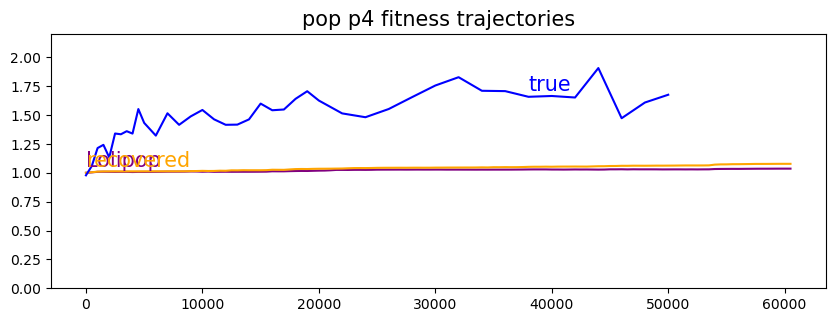

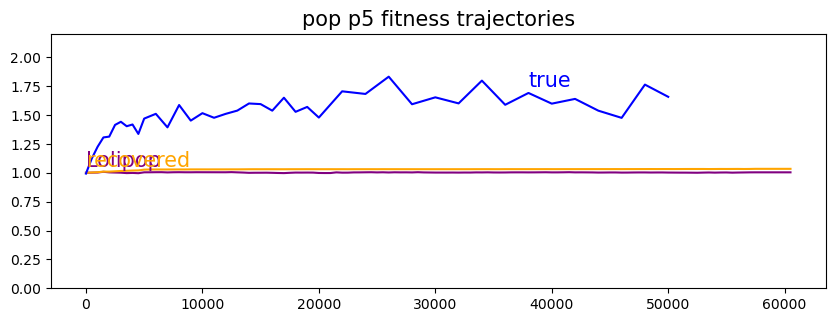

In [240]:
for pop in LH.populations_nonmutator:
    AP.plotTraj(fitness_LTEE_reg10[pop][:, None], times=LH.TIMES_INTPL, colors=['purple'], annot=True, annotTexts=['Lolipop'], ylim=(0, 2.2), plotShow=False)
    AP.plotTraj(summaries_LTEE[pop]['recovered'][2][:, None], times=LH.TIMES_INTPL, colors=['orange'], annot=True, annotTexts=['recovered'], ylim=(0, 2.2), plotFigure=False, plotShow=False)
    AP.plotTraj(LH.fitness_ws[pop][:, None], times=LH.fitness_ts[pop], colors=['blue'], annot=True, annotTexts=['true'], title=f'pop {pop} fitness trajectories', ylim=(0, 2.2), plotFigure=False)
    

# Clade reconstruction for Lenski's data

In [196]:
thFixed_all = {}

In [197]:
reload()
def getMeanFreqAfterFixation(dic, pop):
    appearance_time, fixation_time, clade = LH.getAppearanceFixationForOnePopulation(pop)
    meanFreqAfterFixation = []
    for i, tFix in enumerate(fixation_time):
        if tFix < 122 * 500 and clade[i] == 2:
            _ = np.mean(dic[pop]['traj'][tFix // 500:, i])
            if _ > 0.8:
                meanFreqAfterFixation.append(_)
    return meanFreqAfterFixation

In [198]:
for pop in LH.populations_nonmutator:
    meanFreqAfterFixation = getMeanFreqAfterFixation(LH.data, pop)
    mean, median = np.mean(meanFreqAfterFixation), np.median(meanFreqAfterFixation)
    thFixed_all[pop] = median
    print(f'pop {pop}, thFixed=%.3f mean=%.3f median=%.3f' % (thFixed_all[pop], mean, median))

pop p2, thFixed=0.992 mean=0.986 median=0.992
pop m6, thFixed=0.996 mean=0.983 median=0.996
pop m5, thFixed=0.981 mean=0.973 median=0.981
pop p1, thFixed=0.988 mean=0.979 median=0.988
pop p4, thFixed=0.995 mean=0.987 median=0.995
pop p5, thFixed=0.982 mean=0.973 median=0.982


In [206]:
def testForOnePop(pop, thFixed_all, flattenBlipsAfterFixation=False, collapseSimilarTrajectories=False,
                  debug=False, verbose=False, plot=False, timing=False, save=False):
    thExtinct, mu = 0.01, 1e-10
    thFixed = thFixed_all[pop]
    cluster_res = np.load(f'./data/clusterization_output/clusterization_output_pop={pop}.npz', allow_pickle=True)
    groups = cluster_res['groups']
    print(f"Running for pop {pop}, {len(LH.data[pop]['sites_intpl'])} mutations thFixed=%.3f..." % thFixed)
    res = LH.reconstructForAPopulationAsOnePeriod(pop, groups=groups, thFixed=thFixed,
        thExtinct=0.01, mu=mu, debug=debug, verbose=verbose, plot=plot, timing=timing)
    if save:
        print('\tfinished. Saving...\n')
        fp = open(f'./data/reconstruction_output/reconstruction_output_pop={pop}_thFixed={thFixed}.obj', 'wb') 
        pickle.dump(res, fp, protocol=4)
        fp.close()
    if plot:
        LH.plotResForOnePop(res)
    res.setParamsForEvaluation(testMultipleMu=True, intCov=None, selection=None, 
                               fitness_times=LH.fitness_ts[pop], fitness=LH.fitness_ws[pop], plot=plot, 
                               flattenBlipsAfterFixation=flattenBlipsAfterFixation,
                               collapseSimilarTrajectories=collapseSimilarTrajectories)
    res.evaluateInference()

#     plt.figure(figsize=(10, 3.3))
#     plt.plot(res.times, res.recoveredFitness)
    plt.show()
    return res.summary
    

In [207]:
%%time
reload()
pop = 'm6'
testForOnePop(pop, thFixed_all)

Running for pop m6, 220 mutations thFixed=0.996...
CPU times: user 30 s, sys: 80.3 ms, total: 30.1 s
Wall time: 29.8 s


{'mu_recover': 1e-10,
 'reg_recover': 0.01,
 'true': (array([[0.        , 0.00584795, 0.        , ..., 0.        , 0.        ,
          0.        ],
         [0.        , 0.0070922 , 0.        , ..., 0.        , 0.        ,
          0.        ],
         [0.        , 0.0078196 , 0.        , ..., 0.        , 0.48837209,
          0.        ],
         ...,
         [0.        , 0.71084337, 0.80327869, ..., 0.        , 1.        ,
          1.        ],
         [0.        , 0.94392523, 0.97916667, ..., 0.        , 1.        ,
          1.        ],
         [0.        , 0.94392523, 0.97916667, ..., 0.        , 1.        ,
          1.        ]]),
  array([0.98806585, 1.0856697 , 1.1721911 , 1.31425267, 1.23720742,
         1.19236084, 1.21970461, 1.38700329, 1.33887177, 1.17296318,
         1.20663656, 1.34022962, 1.23214703, 1.32134585, 1.40623815,
         1.41434573, 1.29078033, 1.2975396 , 1.48049744, 1.46644044,
         1.35622968, 1.41445188, 1.41185061, 1.47318915, 1.37351912,

In [208]:
%%time
summaries_LTEE = {}
for pop in LH.populations_nonmutator:
    summaries_LTEE[pop] = testForOnePop(pop, thFixed_all)

Running for pop p2, 173 mutations thFixed=0.992...
Running for pop m6, 220 mutations thFixed=0.996...
Running for pop m5, 404 mutations thFixed=0.981...
Running for pop p1, 457 mutations thFixed=0.988...
Running for pop p4, 198 mutations thFixed=0.995...
Running for pop p5, 200 mutations thFixed=0.982...
CPU times: user 5min 24s, sys: 1.31 s, total: 5min 25s
Wall time: 5min 20s


In [262]:
%%time
summaries_LTEE_postprocessing = {}
for pop in LH.populations_nonmutator:
    summaries_LTEE_postprocessing[pop] = testForOnePop(pop, thFixed_all, flattenBlipsAfterFixation=True, collapseSimilarTrajectories=True)
    

Running for pop p2, 173 mutations thFixed=0.992...
Running for pop m6, 220 mutations thFixed=0.996...
Running for pop m5, 404 mutations thFixed=0.981...
Running for pop p1, 457 mutations thFixed=0.988...
Running for pop p4, 198 mutations thFixed=0.995...
Running for pop p5, 200 mutations thFixed=0.982...
CPU times: user 5min 36s, sys: 1.21 s, total: 5min 38s
Wall time: 5min 32s
